In [15]:
import warnings
warnings.filterwarnings('ignore')

import torch
import transformers
import torchvision
import torch.nn as nn
from torchvision import transforms as T
from torch.utils.data import Dataset, DataLoader
from torch.nn.utils.rnn import pack_padded_sequence

import cv2
import time
import pandas as pd
import matplotlib.pyplot as plt
import numpy as np
from tqdm.autonotebook import tqdm

from sklearn.model_selection import train_test_split

from nltk.translate.bleu_score import SmoothingFunction
from nltk.translate.bleu_score import corpus_bleu, sentence_bleu
from nltk import Text

import editdistance
from torchsummary import summary

seed = 42

In [16]:
torch.random.manual_seed(seed)
torch.cuda.manual_seed(seed)
np.random.seed(seed)
from IPython.display import clear_output
from kobert_transformers import get_tokenizer


tokenizer = get_tokenizer()

MAX_SEQ_LEN = 300  #최대 글자 수 
LR = 5e-5 # Learning Rate
EPOCHS = 30
IMAGE_SIZE = 256 #256x256
BATCH_SIZE = 10  
HIDDEN = 512 
ENC_LAYERS = 4 # transformer encoder layer 수
DEC_LAYERS = 4 # transformer decoder layer 수
N_HEADS = 8 
DROPOUT = 0.1
PATH = r'caption_model.pth'
VOCAB_SIZE = tokenizer.vocab_size
clear_output()

device = 'cuda' if torch.cuda.is_available() else 'cpu'
print(f'Currently using "{device.upper()}" device')

Currently using "CUDA" device


In [17]:
path ='/workspace/IMAGE/images/images'  #여기서 이미지 파일 조정 가능 
data = np.zeros((10001, 2), dtype=np.object) #현재 158916개의 데이터셋
i = 0
for line in open('/workspace/IMAGE/imgDes.txt', 'r', encoding='utf8'):
    data[i, :] = line.replace('\n', "").split('|')
    i += 1
    
df = pd.DataFrame(data=data[1:, :], columns=data[0, :])
df.sample(5)
df.head()

,image_name,caption_text
0,1000092795.jpg,두 명의 젊은 백인 남성이 많은 덤불 근처에 있습니다. 녹색 셔츠를 입은 두 남자...
1,10002456.jpg,근로자들은 위에서 장비를 내려다 본다. 단단한 모자를 쓰고있는 기계에서 일하는 두...
2,1000268201.jpg,분홍색 드레스를 입은 어린 소녀가 나무 오두막에 들어갑니다. 그녀의 극장으로 계단...
3,1000344755.jpg,파란 셔츠를 입은 남자가 창문을 청소하는 사다리 위에 서 있습니다. 사다리에있는 ...
4,1000366164.jpg,카메라로 요리하고 농담하는 두 남자. 스토브에 부엌 요리 음식을 요리하는 두 남자...


In [18]:
train_transforms = T.Compose([
                              T.ToPILImage(),
                              T.Resize((IMAGE_SIZE, IMAGE_SIZE)),
                              T.RandomCrop(IMAGE_SIZE),
                              T.ColorJitter(brightness=(0.95, 1.05),
                                            contrast=(0.95, 1.05),
                                            saturation=(0.98, 1.02),
                                            hue=0.05),
                              T.RandomHorizontalFlip(p=0.1),
                              T.GaussianBlur(kernel_size=(1, 3), sigma=(0.1, 0.5)),
                              T.RandomAdjustSharpness(sharpness_factor=1.2, p=0.2),
                              T.RandomRotation(degrees=(-5, 5)),
                              T.ToTensor(),
                              T.Normalize(mean=[0.485, 0.456, 0.406], 
                                          std=[0.229, 0.224, 0.225])
])

valid_transforms = T.Compose([
                              T.ToPILImage(),
                              T.Resize((IMAGE_SIZE, IMAGE_SIZE)),
                              T.ToTensor(),
                              T.Normalize(mean=[0.485, 0.456, 0.406], 
                                          std=[0.229, 0.224, 0.225])
])
invTrans = T.Compose([T.Normalize(mean = [ 0., 0., 0. ],
                                      std = [ 1/0.229, 1/0.224, 1/0.225 ]),
                          T.Normalize(mean = [ -0.485, -0.456, -0.406 ],
                                      std = [ 1., 1., 1. ]),
                          T.ToPILImage(),
                         ])

In [19]:
root = '/workspace/IMAGE/images/images'

class CapDataset(Dataset):
    def __init__(self, df, root, tokenizer, transforms=None):
        self.df = df
        self.root = root
        self.tokenizer = tokenizer
        self.transforms = transforms

    def __len__(self):
        return len(self.df)

    def __getitem__(self, ix):
        row = self.df.iloc[ix].squeeze()
        id = row.image_name
        image_path = f'{self.root}/{id}'

        image = cv2.imread(image_path)
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
        
        caption = row.caption_text

        target = tokenizer(caption, 
                           return_token_type_ids=False, 
                           return_attention_mask=False, 
                           max_length=MAX_SEQ_LEN, 
                           padding="do_not_pad",
                           return_tensors="pt")
        
        target = target['input_ids'].squeeze()
        target = torch.LongTensor(target)
        return image, target, caption

    def collate_fn(self, batch):
        batch.sort(key=lambda x: len(x[1]), reverse=True)
        images, targets, captions = zip(*batch)
        images = torch.stack([self.transforms(image) for image in images], 0)
        lengths = [len(tar) for tar in targets]
        _targets = torch.zeros(len(captions), max(lengths)).long()
        for i, tar in enumerate(targets):
            end = lengths[i]
            _targets[i, :end] = tar[:end] 
        _targets = _targets.permute(1,0)
        return images.to(device), _targets.to(device), torch.tensor(lengths).long().to(device)

In [20]:
train, test = train_test_split(df, test_size=0.01, shuffle=True, random_state=seed)
train, valid = train_test_split(train, test_size=0.1, shuffle=True, random_state=seed)
train.reset_index(drop=True, inplace=True)
valid.reset_index(drop=True, inplace=True)
test.reset_index(drop=True, inplace=True)
print(f'Train size: {train.shape[0]}, valid size: {valid.shape[0]}, test size: {test.shape[0]}')

Train size: 8910, valid size: 990, test size: 100


In [21]:
train_dataset = CapDataset(train, root, tokenizer, train_transforms)
valid_dataset = CapDataset(valid, root, tokenizer, valid_transforms)
test_dataset = CapDataset(test, root, tokenizer, valid_transforms)

train_dataloader = DataLoader(train_dataset, batch_size=BATCH_SIZE, shuffle=True, collate_fn=train_dataset.collate_fn, drop_last=True)
valid_dataloader = DataLoader(valid_dataset, batch_size=BATCH_SIZE, shuffle=False, collate_fn=valid_dataset.collate_fn, drop_last=True)
test_dataloader = DataLoader(test_dataset, batch_size=1, shuffle=False, collate_fn=test_dataset.collate_fn)

In [22]:
class Encoder(nn.Module):
    def __init__(self, encoded_image_size=8, pretrained=True):
        super(Encoder, self).__init__()
        self.enc_image_size = encoded_image_size

        resnet = torchvision.models.resnet101(pretrained=pretrained)
        modules = list(resnet.children())[:-2]
        self.resnet = nn.Sequential(*modules)
        self.adaptive_pool = nn.AdaptiveAvgPool2d((encoded_image_size, encoded_image_size))

        for param in self.resnet.parameters():
            param.requires_grad = False

        for child in list(self.resnet.children())[5:]:
            for param in child.parameters():
                param.requires_grad = True
                
        self.fc = nn.Sequential(nn.Conv2d(2048, 512, 1),
                                nn.LeakyReLU(0.01, inplace=True))
        #Encoder 정의 
        #Convolution layer와 RELU 활용        

    def forward(self, images):
        out = self.resnet(images)
        out = self.fc(out)
        out = self.adaptive_pool(out) # [B, C, H, W] pooling layer
        #out = out.permute(0, 3, 1, 2)
        out = out.flatten(2) # [B, C, HW] flattern layer 
        out = out.permute(2,0,1) # [HW, B, C] 
        return out
        
        # [HW, B, C]는 vector의 shape

class Encoder_50(nn.Module):
    def __init__(self, bb_name='resnet50', hidden=HIDDEN, pretrained=False):
        super(Encoder_50, self).__init__()
        self.backbone = torchvision.models.__getattribute__(bb_name)(pretrained=pretrained)
        self.backbone.fc = nn.Conv2d(2048, hidden, 1)
    
    def forward(self, src):
        x = self.backbone.conv1(src)

        x = self.backbone.bn1(x)
        x = self.backbone.relu(x)
        x = self.backbone.maxpool(x)
        x = self.backbone.layer1(x)
        x = self.backbone.layer2(x)
        x = self.backbone.layer3(x)
        x = self.backbone.layer4(x) # [32, 2048, 8, 8] : [B,C,H,W]
            
        x = self.backbone.fc(x) # [32, 512, 8, 8] : [B,C,H,W]
        # x = x.permute(0, 3, 1, 2) # [64, 8, 512, 8] : [B,W,C,H]
        x = x.flatten(2) # [32, 512, 64] : [B,C,WH]
        #x = x.permute(1, 0, 2) # [64, 32, 512] : [W,B,CH]
        x = x.permute(2,0,1)
        return x
    
class TransformerModel(nn.Module):
  #TransformerModel 정의
    def __init__(self, outtoken, hidden, enc_layers=1, dec_layers=1, nhead=1, dropout=0.1, pretrained=False):
        super(TransformerModel, self).__init__()
        self.backbone = Encoder_50(pretrained=pretrained)
        
        self.pos_emb = nn.Embedding.from_pretrained(self.get_position_embedding_table(), freeze=True) ##
        self.pos_encoder = PositionalEncoding(hidden, dropout)
        self.decoder = nn.Embedding(outtoken, hidden, padding_idx=0)
        self.pos_decoder = PositionalEncoding(hidden, dropout)
        self.transformer = nn.Transformer(d_model=hidden, nhead=nhead, num_encoder_layers=enc_layers,
                                          num_decoder_layers=dec_layers, dim_feedforward=hidden * 4, dropout=dropout,
                                          activation='gelu')  # 'relu' or torch.nn.functional.leaky_relu

        self.fc_out = nn.Linear(hidden, outtoken)
        self.src_mask = None
        self.trg_mask = None
        self.memory_mask = None
        
    def get_position_embedding_table(self, num_pix=8, ch_pos=256): ##
        def cal_angle(position, hid_idx):
            x = position % num_pix
            y = position // num_pix
            x_enc = x / np.power(10000, hid_idx / ch_pos)
            y_enc = y / np.power(10000, hid_idx / ch_pos)
            return np.sin(x_enc), np.sin(y_enc)
        def get_posi_angle_vec(position):
            return [cal_angle(position, hid_idx)[0] for hid_idx in range(ch_pos)] + [cal_angle(position, hid_idx)[1] for hid_idx in range(ch_pos)]

        embedding_table = np.array([get_posi_angle_vec(pos_i) for pos_i in range(int(num_pix**2))])
        return torch.FloatTensor(embedding_table).to(device)

    def generate_square_subsequent_mask(self, sz):
        mask = torch.triu(torch.ones(sz, sz), 1)
        mask = mask.masked_fill(mask == 1, float('-inf'))
        return mask

    def make_len_mask(self, inp):
        return (inp == 0).transpose(0, 1)

    def forward(self, src, trg):
        if self.trg_mask is None or self.trg_mask.size(0) != len(trg):
            self.trg_mask = self.generate_square_subsequent_mask(len(trg)).to(device) 
        x = self.backbone(src)
        
        batch_size = x.size(1) ##
        positions = x.size(0) ##
        
        src_pad_mask = self.make_len_mask(x[:, :, 0])
        #src = self.pos_encoder(x)
        pos_emb = self.pos_emb(torch.LongTensor([list(range(positions))]*batch_size).to(device)) # [32,64,512]
        src = x + pos_emb.permute(1,0,2) #
        
        trg_pad_mask = self.make_len_mask(trg)
        trg = self.decoder(trg)
        trg = self.pos_decoder(trg)

        output = self.transformer(src, trg, src_mask=self.src_mask, tgt_mask=self.trg_mask,
                                  memory_mask=self.memory_mask,
                                  src_key_padding_mask=src_pad_mask, tgt_key_padding_mask=trg_pad_mask,
                                  memory_key_padding_mask=src_pad_mask) #  [HW,B,C]
        output = self.fc_out(output) # [L,B,C]

        return output
    
class PositionalEncoding(nn.Module):
  #Position Embading
    def __init__(self, d_model, dropout=0.1, max_len=5000):
        super(PositionalEncoding, self).__init__()
        self.dropout = nn.Dropout(p=dropout)
        self.scale = nn.Parameter(torch.ones(1))

        pe = torch.zeros(max_len, d_model)
        position = torch.arange(0, max_len, dtype=torch.float).unsqueeze(1)
        div_term = torch.exp(torch.arange(0, d_model, 2).float() * (-np.log(10000.0) / d_model))
        pe[:, 0::2] = torch.sin(position * div_term)
        pe[:, 1::2] = torch.cos(position * div_term)
        pe = pe.unsqueeze(0).transpose(0, 1)
        self.register_buffer('pe', pe)

    def forward(self, x):
        x = x + self.scale * self.pe[:x.size(0), :]
        return self.dropout(x) 

In [23]:
def train_one_batch(model, data, optimizer, criterion):
    model.train()
    image, target, _ = data
    optimizer.zero_grad()
    output = model(image, target[:-1, :])
    
    if torch.any(torch.isnan(output)): 
        output = torch.nan_to_num(output)
        
    loss = criterion(output.view(-1, output.shape[-1]), torch.reshape(target[1:, :], (-1,)))
    loss.backward()
    optimizer.step()
    
    torch.nn.utils.clip_grad_norm_(model.parameters(), 10.0) 
    
    accuracy = (output.argmax(2).flatten() == target[1:, :].flatten()).float().mean().item()
    return loss.item(), accuracy

@torch.no_grad()
def validate_one_batch(model, data, criterion):
    model.eval()
    image, target, _ = data
    output = model(image, target[:-1, :])
    if torch.any(torch.isnan(output)):
        output = torch.nan_to_num(output)
    loss = criterion(output.view(-1, output.shape[-1]), torch.reshape(target[1:, :], (-1,)))
    accuracy = (output.argmax(2).flatten() == target[1:, :].flatten()).float().mean().item()
    return loss.item(), accuracy

@torch.no_grad()
def prediction(model, filepath='random', max_len=MAX_SEQ_LEN, tokenizer=tokenizer, plot=True):
    label = None
    if filepath == 'random':
        idx = np.random.randint(len(test))
        filepath = root + '/' + test.iloc[idx, 0]
        label = test.iloc[idx, -1]

    model.eval()
    img = cv2.imread(filepath)
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    image = valid_transforms(img)
    src = torch.FloatTensor(image).unsqueeze(0).to(device)

    out_indexes = [101, ]

    for i in range(max_len):
                
        trg_tensor = torch.LongTensor(out_indexes).unsqueeze(1).to(device)
                
        output = model(src, trg_tensor)
        out_token = output.argmax(2)[-1].item()
        if out_token == 102:
            break
        out_indexes.append(out_token)

    preds = tokenizer.decode(out_indexes[1:])
    if plot:
        plt.figure(figsize=(6,4))
        plt.title("Predicted / Truth")
        plt.imshow(img)
        plt.tight_layout()
        plt.show()
        plt.pause(0.001)
        print(f'Prediction: {preds}, \nTruth: {label if label is not None else "NO label"}')
    
    return preds

In [24]:
def bleu_score_fn(method_no: int = 4, ref_type='corpus'):
    smoothing_method = getattr(SmoothingFunction(), f'method{method_no}')
    
    def bleu_score_corpus(reference_corpus: list, candidate_corpus: list, n: int = 4):
        weights = [1 / n] * n
        return corpus_bleu(reference_corpus, candidate_corpus,
                           smoothing_function=smoothing_method, weights=weights)

    def bleu_score_sentence(reference_sentences: list, candidate_sentence: list, n: int = 4):
        weights = [1 / n] * n
        return sentence_bleu(reference_sentences, candidate_sentence,
                             smoothing_function=smoothing_method, weights=weights)
    if ref_type == 'corpus':
        return bleu_score_corpus
    elif ref_type == 'sentence':
        return bleu_score_sentence
    #이미지 캡셔닝 특성상 정답 sequnce와 비교하는 것이기 때문에 BLUE로 evaluation하는 경우가 많음.
@torch.no_grad()
def evaluate_model(dataloader, model, bleu_score_fn, tokenizer):
    running_bleu = [0.0] * 5
    model.eval()
    for batch_idx, batch in enumerate(tqdm(dataloader, leave=False)):
        images, captions, _ = batch
        outputs = []
        for j in range(images.size(0)):
            src = images[j, ...].unsqueeze(0)
            out_indexes = [101, ]
            for i in range(MAX_SEQ_LEN):
                trg_tensor = torch.LongTensor(out_indexes).unsqueeze(1).to(device)      
                output = model(src, trg_tensor)
                out_token = output.argmax(2)[-1].item()
                if out_token == 102:  # [SEP]
                    break
                out_indexes.append(out_token)
            preds = tokenizer.decode(out_indexes[1:]).replace('[PAD]', '').split()
            outputs.append(preds)
            
        captions = [tokenizer.decode(captions[:,i]).replace('[PAD]', '').split()[1:-1] for i in range(captions.size(1))]
        for i in (1, 2, 3, 4):
            running_bleu[i] += bleu_score_fn(reference_corpus=captions, candidate_corpus=outputs, n=i)
    for i in (1, 2, 3, 4):
        running_bleu[i] /= len(dataloader)
    return running_bleu

In [25]:
model = TransformerModel(VOCAB_SIZE, hidden=HIDDEN, enc_layers=ENC_LAYERS, dec_layers=DEC_LAYERS,   
                         nhead=N_HEADS, dropout=DROPOUT, pretrained=True).to(device)  # pretrained False initially
criterion = nn.CrossEntropyLoss(ignore_index=0)
optimizer = torch.optim.AdamW(model.parameters(), lr=LR, weight_decay=1e-6)
scheduler = torch.optim.lr_scheduler.ReduceLROnPlateau(optimizer, patience=5, min_lr=1e-6, factor=0.1)
corpus_bleu_score_fn = bleu_score_fn(4, 'corpus')

1/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

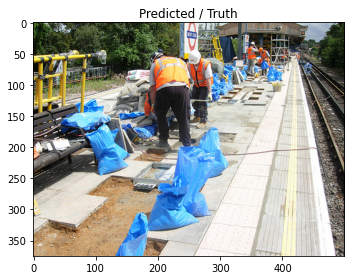

Prediction: , 
Truth:  오렌지주의 조끼를 착용 한 노동자들은 철도 트랙 옆에 파란색 가방으로 작업하고 있습니다. 안전 조끼의 건설 승무원은 철도 트랙 근처의 보도를 개조하고 있습니다. 건설 노동자들은 기차역의 중앙값에 벽돌을 놓고 있습니다. 오렌지 조끼를 입은 몇몇 남자들은 철도와 함께 일합니다.


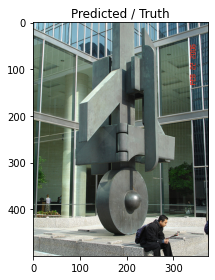

Prediction: .[SEP]를 입은 남자가를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 있습니다.[SEP] 있습니다.[SEP]를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가있는 남자가있는 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가있는 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은, 
Truth:  검은 색의 남자는 유리 건물 앞 현대 미술 구조 옆에 앉아 있습니다. 한 남자는 사무실 건물 외부의 조각품으로 신문을 읽고 읽습니다. 건물 앞에 금속 조각 앞에 앉아있는 남자. 남자는 큰 동상 근처에 앉아 있습니다.


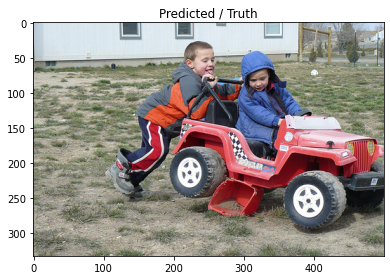

Prediction: 하고 있습니다.[SEP]는 셔츠를 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가를 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가를 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가를 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가, 
Truth:  빨간 장난감 자동차에 한 아이가 그를 밀고 소년은 아이 크기의 차에 다른 아이를 밀어냅니다. 장난감 SUV에 소녀를 밀고있는 소년. 두 소년이 장난감 차에서 놀아요.


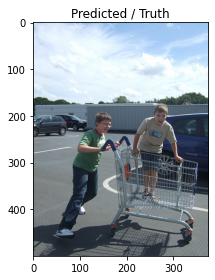

Prediction: 하고 있습니다.[SEP]를 입은 남자가 흰색 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가있는 남자가있는 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠, 
Truth:  한 소년은 다른 작은 소년과 함께 쇼핑 카트를 밀어 넣습니다. 열정적 인 소년이 웃는 소년이 들어있는 쇼핑 카트를 밀어냅니다. 두 명의 작은 소년이 주차장에서 쇼핑 카트에서 놀아요. 두 소년은 주차장에서 쇼핑 카트를 가지고 놀아요.


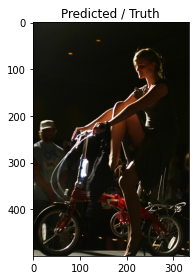

Prediction: 하고 있습니다.[SEP]는 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 흰색 셔츠를 입은 남자.[SEP]을 입은 남자가 흰색 흰색 흰색 흰색 흰색 흰색 흰색 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 흰색 흰색 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자는 셔츠를 입은 남자는 셔츠를 입은 남자가 셔츠를 입은 남자는 셔츠를 입은 남자는 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 흰 셔츠를 입은 남자가 흰색 셔츠를 입은 남자가 흰색 흰색 흰색 흰, 
Truth:  검은 드레스와 하이힐을 가진 여성이 자전거를 타고 있습니다. 하이힐을 가진 여성은 작은 바퀴로 자전거를 타고 있습니다. 미니 자전거를 타는 젊은 여성. 작은 자전거 위에있는 여자.


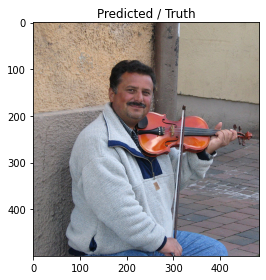

Prediction: 하고 있습니다.[SEP]는 남자가있는 남자가있는 남자가있는 남자가있는 남자.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]를 연주하는 남자가있는 남자.[SEP]을 입은 남자가있는 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]는[SEP]을 입은 남자가[SEP][SEP][SEP]을 흰색과 함께 앉아 있습니다.[SEP]을 입은 남자가있는[SEP]는[SEP][SEP]는[SEP]을 입은 남자.[SEP]는[SEP]을 입은 남자.[SEP]을 입은 남자가있는 남자가 셔츠를 입은 남자가있는 남자.[SEP]을 입은 남자가있는 남자.[SEP]를 입은 남자.[SEP]를 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자.[SEP]을 입은 남자가있는 남자.[SEP]을 입은 남자가있는 남자가있는 남자가있는 남자가를 입은 남자.[SEP]를 입은 남자.[SEP]를 입은 남자가있는 남자.[SEP]을 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자.[SEP]을 입은 남자.[SEP]을 입은 남자가있는 남자가있는 남자.[SEP]을 입은 남자.[SEP]을 입은 남자가있는 남자가있는 남자가있는 남자가있는 남자가있는 남자.[SEP]을 셔츠를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자가 셔츠를 연주하는 남자.[SEP]를 연주하는 남자, 
Truth:  바이올린을 연주하는 회색 풀오버 스웨터를 입은 남자. 한 남자가 보도에서 외부 바이올린을 연주하고 있습니다. 한 남자가 바깥 쪽 바이올린을 구부리고 안고 있습니다. 남자는 웃으면 서 바이올린을 연주합니다.


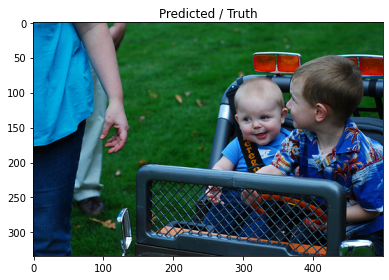

Prediction: 하고 있습니다.[SEP]는[SEP]를 입은 남자가를 연주하는 동안 남자.[SEP]를 연주하는 남자가를 연주하는 남자.[SEP]을 들고 있습니다.[SEP]고 있습니다.[SEP]을 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자.[SEP]고 있습니다.[SEP]고 있습니다.[SEP]을 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가는 남자가는 남자가를 입은 남자가를 입은 남자가고 있습니다.[SEP]고 있습니다.[SEP]을 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가를 입은 남자가를 입은 남자가를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가를 입은 남자가를 입은 남자가를 입은 남자가를 입은 남자가를 입은 남자가 셔츠를 입은 남자가를 입은 남자가 셔츠를 입은 남자가를 입은 남자가를 입은 남자가를 입은 남자가고 있습니다.[SEP]고 있습니다.[SEP] 있습니다.[SEP]을 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가를 입은 남자가 셔츠를 입은 남자가를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자, 
Truth:  어린 아이의 장난감 차량을 타는 두 명의 아이들. 두 명의 작은 소년이 잔디 위에 장난감 차에 앉아 있습니다. 두 명의 작은 소년이 장난감 트럭을 타십시오. 타이어 트럭에있는 소년과 아기.


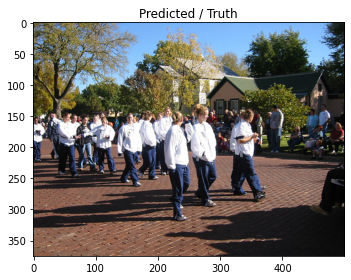

Prediction: 하고 있습니다.[SEP]를 입은 남자가를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는 남자.[SEP][SEP]를 연주하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 입은 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 입은 남자.[SEP]를 연주하는 남자.[SEP]을 입은 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP]를 연주하는 남자.[SEP]을 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는, 
Truth:  한 무리의 사람들이 퍼레이드로 길을 걸어가는 것과 같은 옷을 입었습니다. 흰색 재킷에있는 사람들이 마을 거리에서 걷고 있습니다. 흰 셔츠를 입은 많은 아이들이 동네를 걷고 있습니다. 벽돌 도로를 걷는 흰색 칼라 셔츠의 아이들.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 1 summary:
Train loss: 4.6946, validation loss: 3.7104
Train accuracy: 0.1924, validation accuracy: 0.2575
Time per 1 epoch: 11.0 minutes
2/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

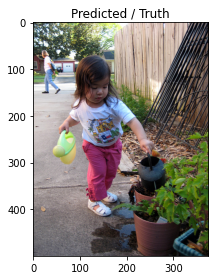

Prediction: 하고 있습니다.[SEP]는[SEP]를 입은 남자가있는 남자.[SEP]를 흰색과 함께 앉아 있습니다.[SEP]를 입은 남자가있는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 셔츠를 입은 남자.[SEP]을 입은 남자.[SEP]는 남자.[SEP]을 입은[SEP]는[SEP]는[SEP]을 입은[SEP]을 입은[SEP]을 흰[SEP]을 흰[SEP]고 있습니다[SEP]을 입은[SEP]는[SEP]는[SEP]는[SEP]을 셔츠를 입은[SEP]고 있습니다.[SEP]고 있습니다.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]를 입은 남자.[SEP]을 입은[SEP]을 입은 남자.[SEP]를 입은 남자.[SEP]를 입은 남자.[SEP]를 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자가있는 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자가 셔츠를 입은 남자.[SEP]를 입은 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]을 입은 남자가 셔츠를 입은 남자가있는 남자.[SEP]는 남자.[SEP]는 남자가있는 남자.[SEP]을 입은 남자[SEP]을 입은 남자.[SEP]을 입은 남자[SEP]는 남자[SEP]을 입은 남자가있는 남자가있는 남자[SEP]을 입은 남자[SEP]를 입은 남자.[SEP]을 입은 남자.[SEP]를 입은 남자[SEP]를 입은 남자가 셔츠를 입은 남자가 흰색과 함께 앉아 있습니다.[SEP]를 입은 남자, 
Truth:  아시아 소녀는 여자가 보도에서 지나갈 때 차도 옆에 식물을 공급합니다. 작은 소녀가 보도에 식물에 물을 뿌리며 여자가 백그라운드에서 걸어갑니다. 분홍색 바지를 곁들인 유아는 물을 작은 식물에 붓습니다. 어린 아이는 식물에 물을 뿌립니다.


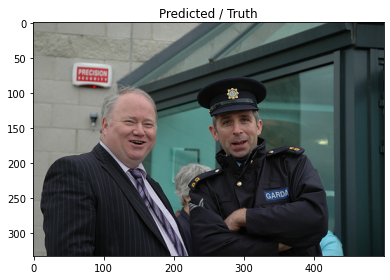

Prediction: 하고 있습니다.[SEP]는[SEP]를 연주하는 남자.[SEP]는 남자.[SEP]을 입은 남자가 셔츠를 입은 남자가있는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는[SEP]을 연주합니다.[SEP]을 연주하는[SEP][SEP][SEP][SEP]을 연주합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는[SEP]는 남자.[SEP]을 연주하는[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]를 연주하는 남자.[SEP]는 남자.[SEP]을 입은 남자[SEP]을 입은 남자.[SEP]을 입은 남자가[SEP]을 입은 남자[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]는 남자.[SEP]는 남자[SEP]는 남자.[SEP]을 입은 남자[SEP]을 입은 남자.[SEP]는 남자[SEP]는 남자[SEP]을 입은 남자가[SEP]을 입은 남자[SEP]을 입은 남자.[SEP][SEP]을 연주하는 남자.[SEP]를 연주하는 남자[SEP][SEP][SEP]를 연주하는 남자가[SEP]을 입은 남자.[SEP]을 입은 남자.[SEP]는 남자[SEP], 
Truth:  남자와 경찰관이 사진 작가에게 웃고 있습니다. 양복을 입은 남자와 장교가 카메라를 위해 미소를 짓습니다. 남자와 경찰관이 서로 이야기합니다. 남자와 경비원이 함께 웃었다.


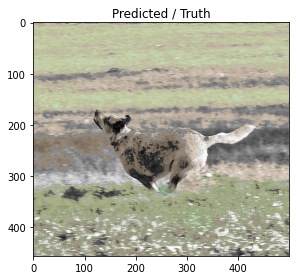

Prediction: 하고 있습니다.[SEP]는[SEP]를하는 개.[SEP]는 개.[SEP] 개[SEP]를하는 개.[SEP] 개[SEP] 개[SEP]를합니다.[SEP]를하는 개.[SEP] 개[SEP]고 있습니다[SEP]고 있습니다[SEP][SEP][SEP]고 있습니다[SEP]고 있습니다[SEP]고 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]를하는[SEP][SEP][SEP][SEP][SEP] 개[SEP] 개[SEP] 개[SEP] 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는[SEP]를하는[SEP]고 있습니다.[SEP]고 있습니다.[SEP]를하는 개.[SEP]습니다.[SEP]를하는 개[SEP] 개[SEP]를하는[SEP]를하는[SEP]을 흰 개.[SEP]를하는 개.[SEP]를하는 개.[SEP]를하는 개[SEP]를하는 개[SEP]습니다[SEP]를하는 개.[SEP]습니다.[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다.[SEP] 있습니다[SEP] 있습니다.[SEP]습니다.[SEP]를 입은[SEP]를 입은[SEP]를 입은[SEP]를 입은[SEP]는 개[SEP]는 개[SEP]는 개[SEP]는 개.[SEP]를하는 개[SEP]를하는 개[SEP]를하는 개[SEP]를하는[SEP]를하는 개.[SEP]는 개[SEP]는 개[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]를 연주합니다[SEP] 개[SEP] 개[SEP] 개[SEP]를하는 개[SEP] 개[SEP] 개[SEP] 개[SEP]를 연주합니다[SEP] 있습니다[SEP] 있습니다[SEP]를하는 개[SEP] 개[SEP] 개[SEP] 개[SEP] 개.[SEP]를하는 개[SEP] 개[SEP] 개[SEP] 개[SEP]를하는 개[SEP] 개[SEP], 
Truth:  잔디를 통해 달리는 흑백 개의 흐릿

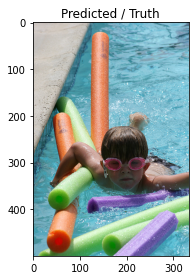

Prediction: 의자에 앉아 있습니다.[SEP]는 흰색과 흰색 셔츠를 입은 남자가 셔츠를 입은 남자. 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자.[SEP]에 앉아 있습니다.[SEP]는 셔츠를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]는 셔츠를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]을 들고 있습니다.[SEP]을 들고 있습니다.[SEP]을 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자.[SEP]를 입은 남자.[SEP]를 입은 남자가 물고 있습니다.[SEP]는 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자.[SEP]를 입은 남자.[SEP]는 남자는 남자는 남자가 물에 앉아 있습니다.[SEP]를 입은 남자가 물에 앉아 있습니다[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자[SEP]를 입은 남자.[SEP]를 입은 남자.[SEP]를 입은 남자[SEP]를 입은 남자가 물에 앉아 있습니다.[SEP]를 입은 남자.[SEP]를 입은 남자가 물에 앉아 있습니다, 
Truth:  어린 소녀는 다양한 색상의 물 국수로 수영장에서 수영합니다. 수영장에서 물 국수를 가지고 노는 아이. 어린이는 물 국수가있는 수영장에서 재생합니다. 분홍색 고글의 아이가 수영 중입니다.


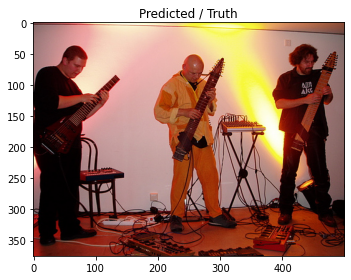

Prediction: 하고 있습니다.[SEP]을 입은[SEP]는 흰색 셔츠를 입은 남자.[SEP]를 입은 남자가 셔츠를 입은 남자.[SEP]를 입은 남자가 셔츠를 입은 남자.[SEP]을 연주하고 있습니다.[SEP]을 연주하는 남자.[SEP]는 남자.[SEP]을 연주하는[SEP]을 연주하는[SEP]을 연주하는[SEP][SEP][SEP][SEP]고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는[SEP][SEP]는[SEP]고 있습니다.[SEP]고 있습니다.[SEP]을 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 연주하는[SEP]을 연주하는[SEP][SEP]을 연주하는[SEP]를 연주하고 있습니다.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 남자.[SEP][SEP][SEP]을 연주하는[SEP][SEP][SEP][SEP]을 연주하는[SEP][SEP][SEP]는 남자.[SEP]를 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는[SEP][SEP]를 연주하는[SEP][SEP][SEP][SEP]를 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주하는[SEP][SEP], 
Truth:  세 남자는 무대 전체에 전선과 장비로 뮤지컬 세트를하고 있으며 악기와 같은 독특한 기타를 들고 있습니다. 세 남자가 전자의 현악기를 연주하고 있습니다. 세 명의 뮤지션이 악기를 연주하고 있습니다. 세 남자가 함께 음악을 연주하고 있습니다.


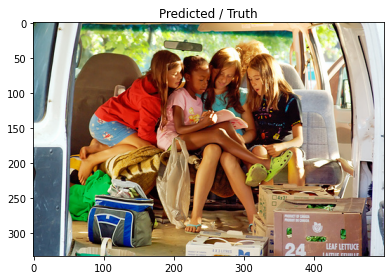

Prediction: 하고 있습니다.[SEP]의 그룹.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP].[SEP]에 앉아 있습니다.[SEP].[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]을 입은[SEP]에 앉아 있습니다.[SEP] 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]를 입은[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]는[SEP]는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SE

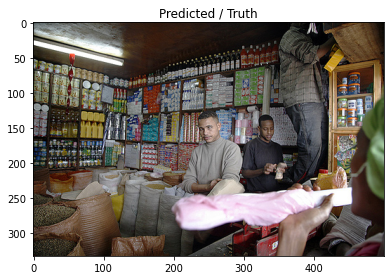

Prediction: 하고 있습니다.[SEP]의 그룹.[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]는[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP]는[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]를 입은[SEP]를하는[SEP]를하는[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]을 입은[SEP]을 입은[SEP] 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]를 입은[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]를 입은[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]는[SEP]는[SEP]는[SEP]는[SEP]를 입은[SEP] 있습니다.[SEP] 있습니다.[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]를 입은[SEP]를 입은[SEP]를 연주하는[SEP]를 연주하는[SEP]에 앉아 있습니다.[SEP]를 연주하는[SEP]를 입은[SEP]를 입은[SEP]를 입은[SEP]를 연주하는[SEP]를 연주하는[SEP]를 연주하는, 
Truth:  몇

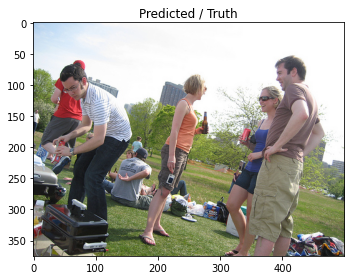

Prediction: 의 그룹이를하고 있습니다.[SEP]는 축구를하는 사람들.[SEP]를하는[SEP]를하는[SEP]를합니다.[SEP]를하는[SEP]는 축구를하는[SEP]를합니다.[SEP]를하는[SEP]를하는[SEP]를하는[SEP]고 있습니다.[SEP]를하는[SEP]를하는[SEP]를하는[SEP][SEP][SEP][SEP][SEP].[SEP]는[SEP][SEP]를하는[SEP]를하는[SEP]를하는[SEP][SEP]를하는[SEP]를하는[SEP]를합니다.[SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP]를하는[SEP]를하는[SEP][SEP]를하는[SEP]고 있습니다.[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP].[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]합니다.[SEP]를하는 남자.[SEP] 축구를하는 남자.[SEP] 축구를하는 남자.[SEP] 축구를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]는 축구를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]는 축구를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]는 축구를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP]를하는 남자.[SEP] 축구를하는 남자.[SEP]를하는 남자.[SEP] 축구를하는 남자.[SEP]를하는[SEP]를하는[SEP]를, 
Truth:  한 무리의 사람들이 공원에서 맥주를 즐기고 있습니다. 한 무리의 사람들은 외부 요리를 가지고 있습니다. 사람들은 공원에서 자신을 즐기고 있습니다. 야외 피크닉에서 여러 사람.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 2 summary:
Train loss: 3.5340, validation loss: 3.2827
Train accuracy: 0.2717, validation accuracy: 0.2897
Time per 2 epoch: 19.0 minutes
Prediction after 2 epoch.


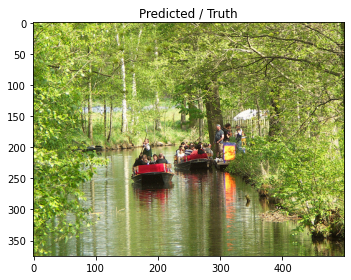

Prediction: 의자에 앉아있는 동안 물에 앉아있는 동안 물에 앉아 있습니다. 한 남자가 물에 앉아있는 남자가 물에 앉아 있습니다. 한 남자가 물에 앉아 있습니다.[SEP]에 앉아있는 남자가 물에 앉아 있습니다.[SEP]에 앉아있는 남자가 물에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]는 남자[SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]트에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]를 입은[SEP]에 앉아 있습니다[SEP]는 남자[SEP]에 앉아 있습니다[SEP]는 남자[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP]를 입은[SEP][SEP][SEP][SEP][SEP]를 입은 남자[SEP]를 입은 남자[SEP]에 앉아 있습니다.[SEP]를 입은[SEP]를 입은[SEP][SEP][SEP], 
Truth:  녹색으로 1 명의 남자가있는 두 보트에있는 사람들. 사람

  0%|          | 0/891 [00:00<?, ?it/s]

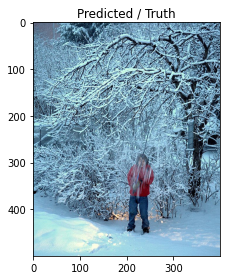

Prediction: 가고 있습니다.[SEP]가 물에서 뛰어 내리고 있습니다.[SEP]는 물에서 뛰어 내리고 있습니다.[SEP]는[SEP]를하는 개.[SEP]는 물에서 뛰어 내리고 있습니다.[SEP]는[SEP]를하는[SEP]를합니다.[SEP]는[SEP]를합니다.[SEP][SEP][SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를합니다.[SEP][SEP][SEP]를합니다.[SEP]는[SEP][SEP][SEP]를합니다.[SEP]를하는[SEP]는[SEP]는[SEP]는[SEP]를합니다.[SEP]를합니다.[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를합니다.[SEP]는[SEP]를합니다.[SEP]를하는[SEP]는[SEP]를하는[SEP]를합니다.[SEP]를 입은[SEP]는[SEP]습니다.[SEP]를 입은[SEP]습니다.[SEP]을 입은[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]를합니다.[SEP]를 입은[SEP]를 입은[SEP]를 입은[SEP]를 입은[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]를합니다.[SEP]를하는[SEP]를 입은[SEP]를합니다.[SEP]를합니다.[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]를 입은[SEP] 있습니다.[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]를합니다.[SEP]를 입은[SEP]를 입은[SEP]를합니다.[SEP]를합니다.[SEP]를하는[SEP]를하는[SEP]를합니다.[SEP][SEP]를 입은[SEP]를 입은[SEP]를 입은[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP], 
Truth:  빨간 재킷을 입은 소년은 막대기로 눈 덮인 나무를 때립니다. 빨간 재킷을 입은 사람은 눈 덮인 나무 아래에 서 있습니다. 아이는 눈 덮인

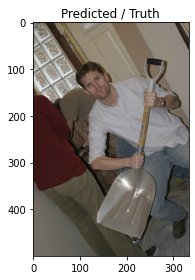

Prediction: 의자에 앉아있는 남자가 의자에 앉아 있습니다. 한 남자가 의자에 앉아 있습니다.[SEP]에 앉아있는 남자가 의자에 앉아 있습니다.[SEP]에 앉아있는 남자가 의자에 앉아 있습니다.[SEP]에 앉아있는 남자.[SEP] 의자에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP] 의자[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP] 의자에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP] 의자에 앉아 있습니다.[SEP] 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]를 입은[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]는 남자[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]에 앉아 있습니다.[SEP] 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]는 남자[SEP][SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP][SEP][SEP][SEP][SEP]파에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]를 입은[SEP][SEP][SEP], 
Truth:  흰색 티셔츠를 입은 남자가 스노우 삽을 들고 있습니다. 스노우 삽을 들고 흰 셔츠를 입은 남자. 한 남자가 무기처럼 삽을 들고 있습니다. 이 사람은 삽을 들고 있습니다

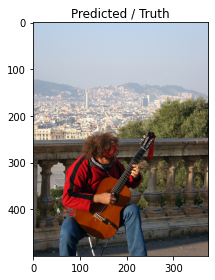

Prediction: 가 기타를 연주하는 동안 기타를 연주하는 남자. 기타를 연주하는 남자가 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는[SEP][SEP] 기타를 연주하는[SEP] 기타를 연주하는[SEP][SEP][SEP] 기타를 연주하는[SEP][SEP][SEP][SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 기타를 연주하는 기타를 연주하는[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 기타를 연주하는[SEP] 기타를, 
Truth:  한 남자가 도시의 전망을 그의 배경으로 기타를 연주하고 앉아 있습니다. 도시를 간과하면서 영감 때문에 기타를 집어 들었습니다. 빨간색과 검은 색 셔츠를 입은 남자가 도시 앞에서 기타를 연주하고 있습니다. 그의 기타를 연주하는 히피.


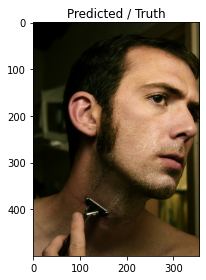

Prediction: 를 가진 남자가 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 가진 남자. 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 가진 남자. 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 가진 남자. 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를, 
Truth:  젊은 성인 남성은 면도기가 목을 내려 가면서 얼굴을 면도했다. 한 남자는 목을 면도하지만 수염은 아닙니다. 한 남자가 조심스럽게 수염을 깎습니다. 면도기와 목을 깎는 남자.


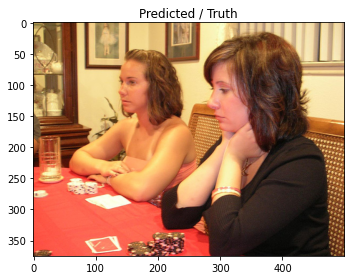

Prediction: 하고 있습니다.[SEP]터를 입은 남자가 밴드를 연주하고 있습니다.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]를 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주합니다.[SEP][SEP]을 연주하는 남자.[SEP]을 연주하는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는 남자[SEP]을 연주하는 남자.[SEP][SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자[SEP]을 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP]를 연주하는 남자[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP] 있습니다.[SEP] 있습니다.[SEP]을 연주하는 남자[SEP]를 연주하는 남자[SEP]를 연주하는 남자[SEP]을 연주하는 남자[SEP][SEP][SEP] 있습니다.[SEP]을 연주하는 남자[SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]을 연주하는 남자[SEP]을 연주하는 남자[SEP]을 연주하는 남자[SEP]을 연주하는 남자[SEP]을 연주하는 남자.[SEP][SEP]을 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자[SEP], 
Truth:  자매들은 차례를 기다리면서 다음 움직임을 기다리고 고민합니다. 카드 게임 포커를 연주하는 빨간 천이있는 테이블에 두 명의 숙녀. 카드 게임을하는 검은 블라우스의 한 여성. 두 명의 숙녀가 카드를하고 도박을합니다.


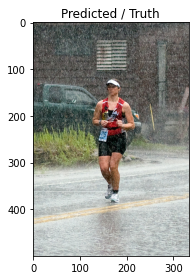

Prediction: 지 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가, 
Truth:  빨간 조끼를 입은 여성은 비를 통해 경주를합니다. 빨간색의 여성 주자가 비에 흠뻑 젖어 있습니다. 대출 러너는 비가 내리는 경주에 참여합니다. 비가 내리는 여자.


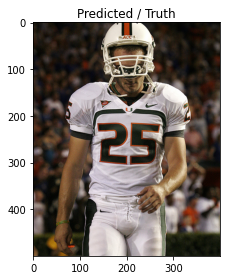

Prediction: 를 들고있는 남자가 나무를 들고 있습니다. 나무를 들고있는 남자가 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다.[SEP]는 남자.[SEP]고 있습니다.[SEP]고 있습니다.[SEP]는 나무를 입은 남자가라스틱 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다.[SEP]는 나무를 입은 남자.[SEP]는 나무를 나무를 나무를 나무를 나무를 들고 있습니다.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를, 
Truth:  흰색 유니폼을 입은 축구 선수가 산책하고 내려다 본다. 마이애미 대학교 축구 선수, 25. 축구 선수는 25 번을 가지고 있습니다. 축구 선수의 근접 촬영, 25.


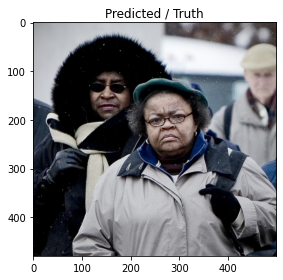

Prediction: 를 들고있는 남자가 가죽 가게를 들고 있습니다. 가게에서 가게를하고 있습니다. 가게에서 가게를하고 있습니다.[SEP] 가게에서 가게를하고 있습니다.[SEP]을하는 남자.[SEP] 가 가게에서 봅니다.[SEP]을 가진 남자[SEP]는 남자.[SEP]을 가진[SEP]을하고 있습니다[SEP]습니다.[SEP]을하는[SEP]을하고 있습니다[SEP]는[SEP]는[SEP]는[SEP]를하고 있습니다.[SEP]를하는[SEP]고 있습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]을 들고있는[SEP]을 가진[SEP]을 들고있는[SEP]을하는[SEP]을하고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP]를하고 있습니다[SEP]을 가진[SEP]을하고 있습니다.[SEP]을 가진 남자.[SEP]을하고 있습니다.[SEP]을 들고있는[SEP] 있습니다.[SEP]을하고 있습니다.[SEP]을 들고있는[SEP][SEP][SEP][SEP]를하는[SEP]를하는[SEP] 있습니다[SEP]을 들고있는[SEP]는[SEP]는 남자.[SEP]을 들고있는[SEP]을 들고있는[SEP]을 들고있는[SEP]을 들고있는[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 남자.[SEP] 있습니다.[SEP] 있습니다[SEP][SEP][SEP][SEP]을 입은[SEP]을 입은[SEP][SEP]을 가진[SEP]을 들고있는[SEP]을 들고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 들고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP] 있습니다.[SEP]을 들고있는[SEP] 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP], 
Truth:  두 사람이 무거운 옷을 입고 있습니다. 겨울 장비의 여성과 남자. 두 명의 여성이 눈 덮인 날에 묶여있었습니다 겨울 옷을 입은 두 사람.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 3 summary:
Train loss: 3.1903, validation loss: 3.0746
Train accuracy: 0.2949, validation accuracy: 0.3032
Time per 3 epoch: 27.0 minutes
4/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

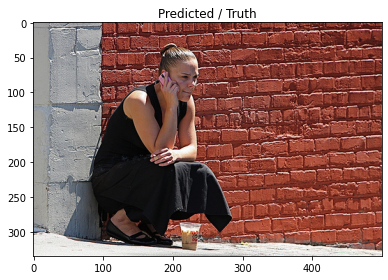

Prediction: 의자에 앉아있는 남자가 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다. 나무 나무 나무를 들고있는 남자. 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 나무를 들고있는 남자.[SEP]는 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]는 나무를 들고있는 남자가 나무를 들고있는 남자.[SEP] 나무를 들고있는 남자.[SEP] 나무를 들고있는 남자.[SEP] 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자가 나무를 들고있는 남자.[SEP]는 나무를 들고있는 남자가 나무를 들고있는 남자.[SEP]는 남자.[SEP]는 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]는 나무를 들고있는 남자.[SEP]는 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자가 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자., 
Truth:  모든 검은 색의 한 여성은 전화를 걸면서 벽에 웅크 리고 있습니다. 여자는 핸드폰으로 말하면서 벽돌 벽에 웅크 리고 있습니다. 벽돌 벽 앞에서 분홍색 핸드폰에 대해 이야기하는 여자. 벽돌 벽 옆에 전화를 한 여성.


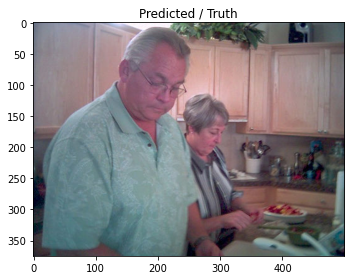

Prediction: 셔츠를 입은 남자는 나무 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 가진 남자. 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를, 
Truth:  두 사람은 밝은 갈색 캐비닛이있는 부엌에서 음식을 준비합니다. 두 명의 노인이 부엌에서 식사를 준비하고 있습니다. 나이가 많은 부부가 함께 부엌에 서 있습니다. 부엌에서 요리하는 나이 많은 부부.


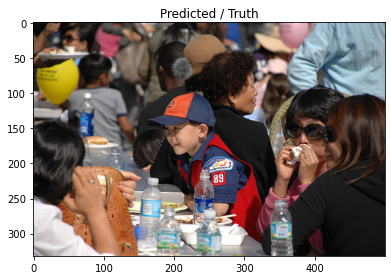

Prediction: 셔츠를 입은 남자가 셔츠를 입은 남자가 나무를 나무를 나무를 나무를 들고 있습니다. 나무 나무를 입은 남자가 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다. 나무를 입은 남자가 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 입은 남자가 나무를 가진 남자.[SEP]를 가진 남자가 나무를 가진 남자가 나무를 들고있는 남자가 나무를 들고 있습니다.[SEP] 나무를 들고 있습니다.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 가진 남자가 나무를 입은 남자.[SEP]는 나무를 입은 남자가 나무를 입은 남자가 나무를 들고있는 남자.[SEP]는 나무를 들고있는 남자.[SEP]를 입은 남자.[SEP]를 들고있는 남자.[SEP]는 나무를 들고있는 남자[SEP]를 들고있는 남자[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 가진 남자, 
Truth:  아시아 식당의 야외 테이블에 기대어 작은 보이 스카우트. 주황색과 파란색 모자에있는 작은 소년이 외부 테이블에 앉아 있습니다. 유니폼을 입은 소년이 일부 여성들과 함께 테이블에 앉아 있습니다. 밖에서 먹고 술을 마시는 다양한 사람들.


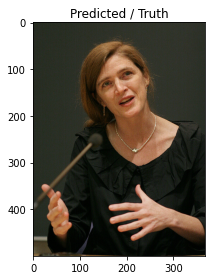

Prediction: 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입고 있습니다. 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 셔츠를 입은 남자가 셔츠를 입고 있습니다. 남자가 셔츠를 입은 남자가 셔츠를 셔츠를 입은 남자가 셔츠를 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 기타를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP] 셔츠를 연주하고 있습니다.[SEP] 셔츠를 연주하고 있습니다.[SEP] 셔츠를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 입은 남자가 기타를 연주하고 있습니다.[SEP] 셔츠를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]는 남자가 기타를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하는 남자가 기타를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]을 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP]를 연주하고 있습니다.[SEP] 셔츠를 연주하는 남자.[SEP], 
Truth:  검은 셔츠를 입은 중년 여성이 마이크에 말합니다. 손짓을하는 마이크에서 말하는 여성. 강의를하는 검은 셔츠를 입은 여자. 연설을하는 검은 셔츠를 입은 여자.


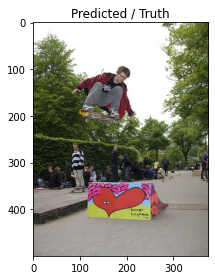

Prediction: eeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeee, 
Truth:  회색 바지를 입은 남자와 화려한 경사로에서 검은 색과 빨간 재킷 스케이트 보드. 공중의 한 남자가 방금 다른 사람들이 그를보고 경사로를 벗어났습니다. 혼잡 한 공원의 스케이트 보드에서 경사로에서 뛰어 내리는 남자. 스케이트 보드에서 경사로를 떠나는 남자.


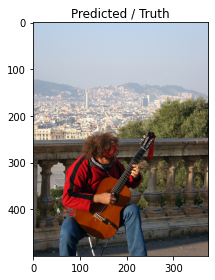

Prediction: 의자에 앉아있는 남자가 기타를 연주하고 있습니다. 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자[SEP] 기타를 연주합니다[SEP] 기타를 연주합니다[SEP] 기타를 연주합니다.[SEP] 기타를 연주하는 남자[SEP] 기타를 연주합니다[SEP] 기타를 연주합니다[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자[SEP] 기타를 연주합니다.[SEP] 기타를 연주합니다[SEP] 기타를 연주하는 남자[SEP] 기타를 연주합니다[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 기타를 연주합니다[SEP] 기타를 연주하는 기타를 연주합니다.[SEP] 기타를 연주합니다[SEP] 기타를 연주합니다.[SEP] 기타를 연주합니다.[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를 연주하는 남자.[SEP] 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를 연주하는 기타를, 
Truth:  한 남자가 도시의 전망을 그의 배경으로 기타를 연주하고 앉아 있습니다. 도시를 간과하면서 영감 때문에 기타를 집어 들었습니다. 빨간색과 검은 색 셔츠를 입은 남자가 도시 앞에서 기타를 연주하고 있습니다. 그의 기타를 연주하는 히피.


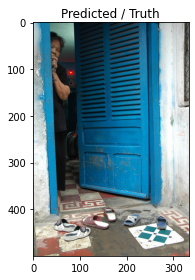

Prediction: 의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ee.[SEP]e.[SEP][SEP][SEP][SEP]eeeeeee.[SEP]e.[SEP]eeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeee, 
Truth:  약간의 늙은 여자는 파란 출입구 뒤에서 3 쌍의 플라스틱 샌들을 밟습니다. 푸른 문이 열리고 여자가 왼쪽에서 엿볼 수 있습니다. 늙은 아시아 여성은 푸른 출입구 뒤에서 보입니다. 파란 출입구 주위를 들여다 보는 아시아 여성.


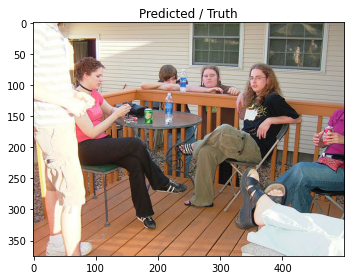

Prediction: 의자에 앉아있는 사람들.[SEP]의 그룹이 의자에 앉아 있습니다.[SEP]에 앉아있는 사람들.[SEP]에 앉아있는 사람들.[SEP]에 앉아있는 사람들.[SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]의[SEP]의[SEP]의[SEP]의[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP][SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]의[SEP]의 그룹.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP]를 입은[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는[SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP].[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 4 summary:
Train loss: 2.9690, validation loss: 2.9177
Train accuracy: 0.3129, validation accuracy: 0.3176
Time per 4 epoch: 35.0 minutes
Prediction after 4 epoch.


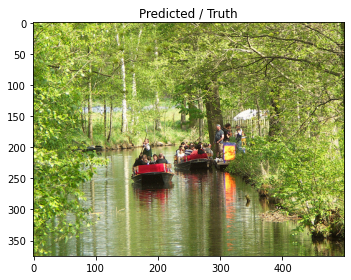

Prediction: 의자에 앉아있는 남자가 물에 앉아 있습니다. 물에 앉아있는 남자.[SEP]의 물에 앉아있는 남자.[SEP]의 물에 앉아있는 남자.[SEP]의 물에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]안에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]트에 앉아 있습니다[SEP]트에 앉아 있습니다.[SEP]의자에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]트에 앉아 있습니다.[SEP]트에 앉아 있습니다.[SEP]트에 앉아있는[SEP]트에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아있는[SEP]에 앉아있는[SEP]트에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]터에 앉아있는[SEP]터에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]안에 앉아있는 남자.[SEP]트에 앉아 있습니다.[SEP]터에 앉아있는[SEP][SEP][SEP][SEP][SEP], 
Truth:  녹색으로 1 명의 남자가있는 두 보트에있는 사람들. 사람들은 차분한 

  0%|          | 0/891 [00:00<?, ?it/s]

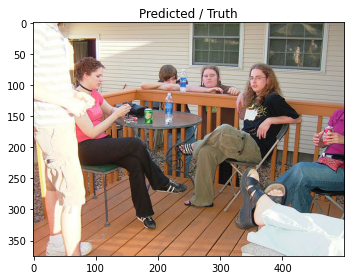

Prediction: 의자에 앉아있는 두 명의 여성이 앉아 있습니다. 두 명의 여성이 앉아 있습니다.[SEP] 명의 여성이 앉아있는 두 명의 여성이 앉아 있습니다.[SEP] 명의 여성이 앉아 있습니다.[SEP]에 앉아있는 두 명의 여성.[SEP] 명의 여성이 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP] 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP]에 앉아 있습니다[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다[SEP] 있습니다[SEP]에 앉아 있습니다[SEP][SEP][SEP][SEP][SEP] 있습니다[SEP] 있습니다.[SEP]에 앉아 있습니다[SEP][SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]의 여성[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]의 여성[SEP] 있습니다[SEP]에 앉아있는[SEP]에 앉아 있습니다[SEP]에 앉아 있습니다[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]는 두 명의 여성[SEP]에 앉아있는 두 명의 여성[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP]는 두 명의 여성[SEP] 있습니다.[SEP] 있습니다.[SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP].[SEP][SEP][SEP].[SEP]에 앉아있는 두 명의 여성.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP], 
Truth:  사람들은 자신의 관심사에 대해 놀고 이야기합니다. 한 무리의 사람들이 갑판에 모였

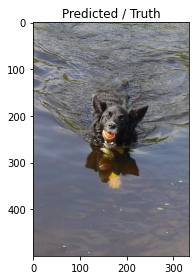

Prediction: 흰 개가 물을 통해 달리고 있습니다. 개가 물을 통과합니다.[SEP]는 물을 통과합니다.[SEP]는 개가 물을 통과합니다.[SEP]는 개[SEP]습니다.[SEP]을 통과합니다[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]니다[SEP][SEP][SEP][SEP]을합니다[SEP]니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다[SEP]니다[SEP] 있습니다[SEP] 있습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]을합니다[SEP]을합니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]을합니다[SEP]습니다.[SEP]니다[SEP][SEP][SEP]를 입은[SEP]를하는 개[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]는[SEP]습니다[SEP]습니다[SEP]는[SEP]는[SEP]습니다[SEP]습니다[SEP][SEP][SEP][SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]을 흰 개[SEP]을 흰 개[SEP]을합니다[SEP]을합니다[S

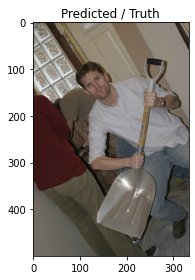

Prediction: 의자에 앉아있는 남자가 의자에 앉아 있습니다. 의자에 앉아있는 남자. 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자[SEP][SEP][SEP][SEP][SEP][SEP]파에 앉아 있습니다.[SEP][SEP]의자.[SEP]의자에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]에 앉아있는[SEP]의자.[SEP]의자.[SEP]의자.[SEP]의자.[SEP]의자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP]에 앉아있는[SEP]파에 앉아있는[SEP]의자.[SEP]파이있는[SEP]을 가진 남자.[SEP] 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]파이있는[SEP]에 앉아있는[SEP][SEP][SEP] 있습니다.[SEP] 있습니다[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]터.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]파이있는[SEP]파이있는[SEP]파이있는[SEP]파이있는[SEP]파에 앉아있는[SEP]파이있는[SEP]파이있는[SEP]파이있는[SEP][SEP][SEP], 
Truth:  흰색 티셔츠를 입은 남자가 스노우 삽을 들고 있습니다. 스노우 삽을 들고 흰 셔츠를 입은 남자. 한 남자가 무기처럼 삽을 들고 있습니다. 이 사람은

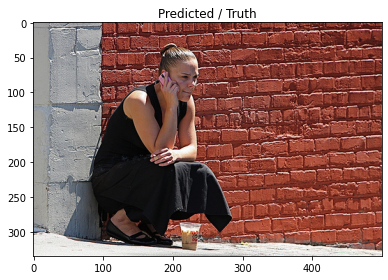

Prediction: 의자에 앉아있는 남자는 의자에 앉아 있습니다. 의자에 앉아있는 남자. 의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]의자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]의[SEP]의.[SEP]의 남자.[SEP]의 남자.[SEP]의 남자[SEP]의자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]을 가진 남자.[SEP]의 남자.[SEP] 있습니다[SEP] 있습니다[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 남자.[SEP] 있습니다[SEP][SEP] 있습니다[SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP] 있습니다[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP], 
Truth:  모든 검은 색의 한 여성은 전화를 걸면서 벽에 웅크 리고 있습니다. 여자

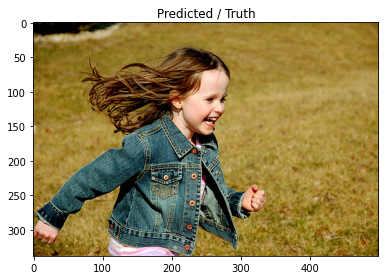

Prediction: 의자에 앉아있는 동안 의자에 앉아있는 여자. 여자는 의자에 앉아 있습니다. 여자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 여자.[SEP] 의자에 앉아있는 여자.[SEP]에 앉아있는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP] 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]안에 앉아있는 여자.[SEP]에 앉아 있습니다.[SEP]에

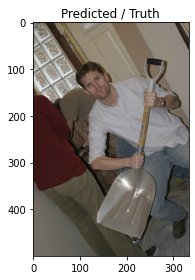

Prediction: 의자에 앉아있는 남자. 남자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP]니.[SEP]e.[SEP]의자.[SEP]의자.[SEP]니트에 앉아있는[SEP]의자.[SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]습니다.[SEP] 있습니다.[SEP]의자에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP]는 남자.[SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]터에 앉아있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]파에 앉아있는 남자.[SEP]파에 앉아있는 남자.[SEP] 있습니다.[SEP]파에 앉아있는[SEP][SEP], 
Truth:  흰색 티셔츠를 입은 남자가 스노우 삽을 들고 있습니다. 스노우 삽을 들고 흰 셔츠를 입은 남자. 한 남자가 무기처럼 삽을 들고 있습니다

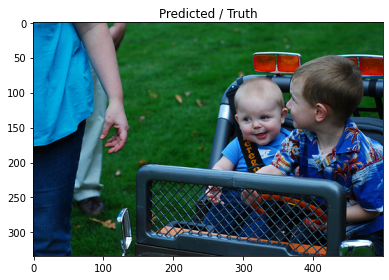

Prediction: 지의 셔츠를 입은 남자가 나무를 나무를 나무를 나무를 나무를 나무를 나무를 나무를 들고 있습니다. 나무 나무를 들고있는 남자. 나무를 들고있는 남자.[SEP] 나무를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는 남자.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP][SEP]는[SEP]는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고있는[SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 가진[SEP]를 들고있는[SEP]는[SEP]는[SEP]는[SEP]는 남자.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]는 남자.[SEP]는 남자.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고있는[SEP]는[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고있는[SEP][SEP][SEP]를 들고있는[SEP]를 들고있는 남자.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고있는, 
Truth:  어린 아이의 장난감 차량을 타는 두 명의 아이들. 두 명의 작은 소년이 잔디 위에 장난감 차에 앉아 있습니다. 두 명의 작은 소년이 장난감 트럭을 타십시오. 타이어 트럭에있는 소년과 아기.


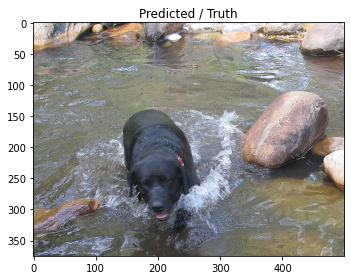

Prediction: 의 개가 물에 서 있습니다. 개가 물에 서 있습니다.[SEP] 물에 서있는 개.[SEP]에 서있는 개.[SEP]에 서있는 개.[SEP] 개가 물에 서 있습니다.[SEP][SEP][SEP][SEP]에 서있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP]에 있습니다.[SEP]에 있습니다.[SEP]습니다.[SEP]에있는[SEP][SEP]에있는[SEP]에있는[SEP]에 있습니다.[SEP][SEP]에있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 있습니다.[SEP]에있는[SEP]에있는[SEP]에 있습니다.[SEP]습니다.[SEP]에 있습니다.[SEP]을하는 개.[SEP]에있는[SEP] 있습니다.[SEP]에있는[SEP]에 있습니다.[SEP]에있는[SEP][SEP][SEP][SEP][SEP]에있는[SEP]는 개.[SEP]에있는[SEP]에있는[SEP]는 개.[SEP][SEP]에있는[SEP]에있는[SEP]에있는[SEP]에 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]는 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]에있는[SEP]에있는[S

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 5 summary:
Train loss: 2.8028, validation loss: 2.8062
Train accuracy: 0.3269, validation accuracy: 0.3266
Time per 5 epoch: 43.0 minutes


  0%|          | 0/100 [00:00<?, ?it/s]

test_bleu1: 0.0054 test_bleu4: 0.0014 
6/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

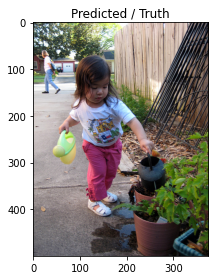

Prediction: 의자에 앉아있는 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다.[SEP]의자에 앉아있는 두 명의 여성.[SEP] 의자에 앉아있는 두 명의 여성.[SEP]iiiiiiii를하는 두 명의 여성.[SEP][SEP][SEP][SEP][SEP]를하는 두 명의[SEP][SEP]를하는 두 명의 여성.[SEP][SEP][SEP][SEP]는 두 명의 여성.[SEP]를하는 두 명의 여성[SEP][SEP]를하는 두 명의 여성[SEP]를하는 두 명의 여성.[SEP][SEP]를하는 두 명의 여성.[SEP][SEP][SEP][SEP][SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성.[SEP]을 들고 있습니다.[SEP] 있습니다.[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]를하는 두 명의 여성[SEP]를하는 두 명의 여성[SEP]를하는 두 명의 여성[SEP]는 두 명의 여성[SEP]는 두 명의 여성[SEP]는 두 명의 여성[SEP]를하는 두 명의 여성[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 두 명의 여성[SEP]는 두 명의 여성[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]습니다.[SEP]습니다.[SEP]는 두 명의 여성[SEP]를하는 두 명의 여성[SEP]을 들고 있습니다[SEP][SEP][SEP][SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성[SEP][SEP][SEP], 
Truth:  아시아 소녀는 여자가 보도에서 지나갈 때 차도 옆에 식물을 공급합니다. 작은 소녀가 보도에 식물에 물을 뿌리며 여자가 백그라운드에서 걸어갑니다. 분홍색 바지를 곁들인 유아는 물을 작은 식물에 붓습니다. 어린 아이는 식물에 물을 뿌립니다.


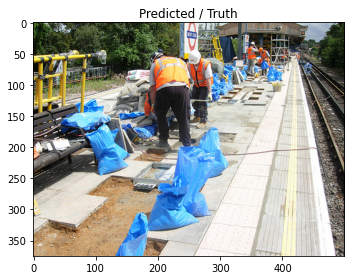

Prediction: 의자에 앉아있는 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다.[SEP] 트랙터를 가진 두 남자.[SEP] 트랙터를 타는 두 남자.[SEP]를 타는 두 남자.[SEP]를 타는[SEP][SEP][SEP][SEP]를 타고 있습니다[SEP][SEP][SEP][SEP][SEP]를하는[SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는[SEP]를하는[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]를하는[SEP]를하는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 남자.[SEP][SEP]를하는 두 남자.[SEP]를하는 두 남자.[SEP]터.[SEP]터.[SEP]터.[SEP]를하는 두 남자.[SEP]를 입은 두 남자.[SEP]를 입은 남자.[SEP]를 가진 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입은 남자.[SEP]를 입은 두 남자.[SEP]를 입은 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 남자.[SEP][SEP]터를하는 두 남자.[SEP]를 입은 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 남자.[SEP][SEP]를하는 두 남자.[SEP]를 입은 두 남자.[SEP]를 가진[SEP]를 가진[SEP][SEP][SEP][SEP], 
Truth:  오렌지주의 조끼를 착용 한 노동자들은 철도 트랙 옆에 파란색 가방으로 

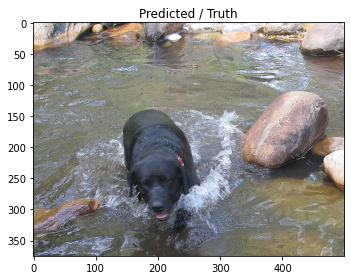

Prediction: 의 개가 물을 통해 뿌려집니다. 개가 물을 통해 뿌려집니다. 물에서 물을 통해 뿌려집니다. 물에서 물을 통해 뿌려집니다.[SEP]는 물에서 물을 뿌려집니다.[SEP]는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP]는 개.[SEP]는 물에서 놀아요.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 물에서 놀아요.[SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에서 놀아요.[SEP][SEP]는 개[SEP][SEP][SEP][SEP]을합니다.[SEP]을합니다.[SEP]을합니다.[SEP]핑에서 놀아요.[SEP]에서 놀아요.[SEP][SEP][SEP][SEP]를 튀는 개[SEP]는 개[SEP]는 개[SEP]는[SEP]는 개[SEP]는 물에서 놀아요.[SEP]를 튀는 개[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 개[SEP]는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 개[SEP]는 개[SEP]을합니다.[SEP]를 튀는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을합니다.[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 튀는 개[SEP] 있습니다.[SEP][SEP] 있습니다.[SEP] 있습니다[SEP]는 물에서 놀아, 
Truth:  붉은 칼라가 달린 젖은 검은 개가 강에 있습니다. 개는 큰 바위 옆에 개울을 통과합니다. 바위 근처의 

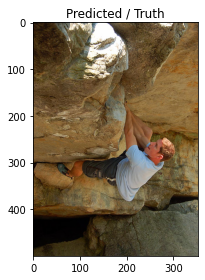

Prediction: 의 바위가 바위가 바위가 바위 절벽 등반입니다. 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가는다.[SEP]벽 등반가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가가가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위 절벽 등반입니다. 바위가 바위가 바위가 바위가가가가가가가가는다. 바위가는다. 바위가는다.[SEP] 바위가 바위가 바위가 바위 절벽 등반입니다.[SEP]벽 등반가는 바위 절벽 등반입니다.[SEP] 바위 절벽 등반가는 바위 절벽 등반가 바위가 바위 절벽 등반가는 바위 절벽 등반가는 바위가는 바위 절벽 등반가 바위 절벽 등반가는 바위가는 바위가는 바, 
Truth:  바위 절벽을 오르는 가벼운 셔츠에 남자가 있습니다. 남자는 암벽 등반입니다. 남자는 암벽 등반입니다. 남자 암벽 등반.


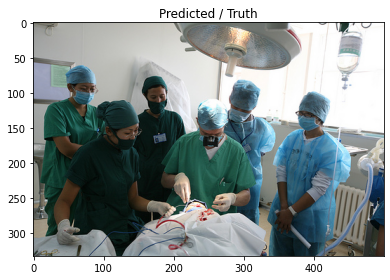

Prediction: 의자에 앉아있는 사람들.[SEP]의 그룹이 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 사람들.[SEP]의 그룹.[SEP]의 그룹이 의자에 앉아 있습니다.[SEP]을 가진[SEP]는[SEP][SEP].[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP]을 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP]을 위해 포즈를 취합니다[SEP].[SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]ooooe.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]e.[SEP]oooooe.[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다[SEP]합니다[SEP]합니다[SEP][SEP][SEP][SEP][SEP][SEP]을 입은[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP]을 입은[SEP][SEP][SEP][SEP][SEP]을하는[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]합니다.[SEP] 있습니다.[SEP]을 위해 포즈를 취하는[SEP]s.[SEP]s.[SEP]s.[SEP]을 위해 포즈를 취하는[S

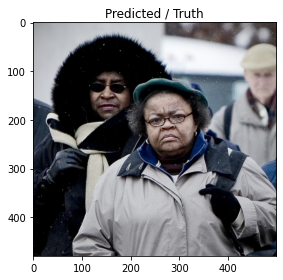

Prediction: 의 여성은 의자에 앉아 있습니다. 한 여성이 의자에 앉아 있습니다. 한 여성이 의자에 앉아 있습니다.[SEP]의자에 앉아있는 여자.[SEP]의 여자가 의자에 앉아 있습니다.[SEP]에 앉아있는 여자[SEP] 의자에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP]에 앉아있는[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]의 여성.[SEP]의 여성.[SEP]의 여자[SEP]의 여자[SEP]의 여자[SEP]의 여자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP].[SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP].[SEP].[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]의 여자[SEP] 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP]를 입은 여자[SEP][SEP].[SEP]s.[SEP]를 입은 여자.[SEP]을 가진 여자.[SEP]s.[SEP][SEP][SEP][S

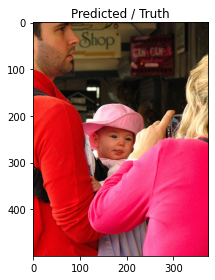

Prediction: 의자에 앉아있는 여자는 의자에 앉아 있습니다. 여자는 의자에 앉아 있습니다. 여자는 의자에 앉아 있습니다.[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자[SEP]에 앉아있는 여자.[SEP]에있는 여자[SEP]에 앉아있는 여자[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP].[SEP].[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP].[SEP].[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는 여자.[SEP].[SEP]에 앉아있는[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에있는 여자.[SEP]에 앉아있는[SEP][SEP]에 앉아있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP][SEP][SEP]에, 
Truth:  여자가 아기의 사진을 찍는 동안 남자가 아기를 안고 있습니다. 핑크 모자를 쓴 아기, 남자가 빨간색으로 붙잡

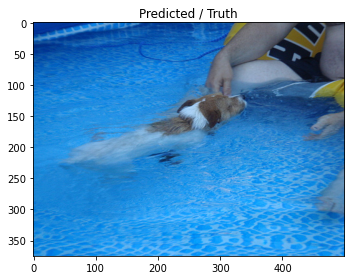

Prediction: 의 개가 수영장에서 수영장에서 수영장에서 수영하는 동안 수영장에서 수영하는 동안 수영장에서 수영하는 개. 수영장에서 수영장에서 수영하는 개. 수영장에서 수영하는 개.[SEP] 수영장에서 수영장에서 수영하는 개.[SEP] 수영장에서 수영하는 개.[SEP] 수영장에서 수영하는 개.[SEP] 수영장에서 수영하는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 수영합니다.[SEP] 수영하는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 개.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]의 개.[SEP]의 수영합니다[SEP]의 수영합니다.[SEP]의 수영하는 수영하는 개.[SEP]의 수영합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 수영합니다.[SEP] 수영하는 수영하는 수영하는 수영하는 수영하는 개.[SEP]을하는 개.[SEP]을하는 개.[SEP] 수영합니다[SEP] 수영합니다[SEP] 수영합니다.[SEP]를하는 수영하는 수영하는 개.[SEP]를 입은[SEP] 수영하는 수영하는 수영하는 수영하는 개.[SEP][SEP] 수영합니다[SEP]을 입은[SEP]를 입은[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP]습니다.[SEP]습니다.[SEP]는 수영하는 수영하는 수영하는 수영하는 개[SEP]을 입은[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]의 수영하는 수영합니다[SEP] 수영합니다[SEP] 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영하는 수영합니다[SEP] 수영하는 수영하는 수영하는 수영하는, 
Truth:  수영장에서 일부를 향해 수영하는 갈색과 흰 개 작은 개는 수영장의 물을 통해 얕은 것입니다. 작은 갈색과 흰 개가 수영장에 있습니

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 6 summary:
Train loss: 2.6689, validation loss: 2.7291
Train accuracy: 0.3375, validation accuracy: 0.3340
Time per 6 epoch: 61.0 minutes
Prediction after 6 epoch.


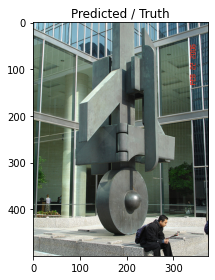

Prediction: 의자에 앉아있는 남자는 의자에 앉아 있습니다. 의자에 앉아있는 남자. 의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP].[SEP][SEP][SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP].[SEP]의 남자.[SEP]의 남자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP].[SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 남자.[SEP]에 앉아있는[SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP]에, 
Truth:  검은 색의 남자는 유리 건물 앞 현대 미술 구조 옆에 앉아 있습니다. 한 남자는 사무실 건물 외부의 조각품으로 신문을 읽고 읽습니다. 건물 앞에 금속 조각 앞에 앉아있는 남자. 남자는 큰 동상 근처에 앉아 있습니다.
7/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

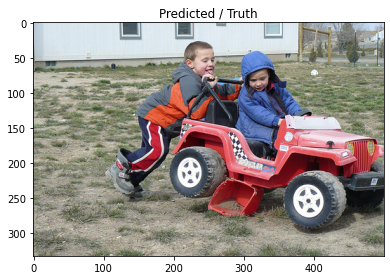

Prediction: 의 트랙터를 타고 있습니다. 트랙터를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는[SEP]를 타고 있습니다.[SEP]를 타는[SEP][SEP][SEP]를 타는[SEP][SEP][SEP][SEP][SEP]를 타고 있습니다.[SEP]를 타는[SEP][SEP][SEP][SEP][SEP]를 타는[SEP]를 타고 있습니다.[SEP]를 타는[SEP][SEP][SEP][SEP][SEP][SEP]를 타는[SEP]를 타는[SEP]를 타는[SEP]를 타는[SEP]를 타는[SEP]습니다.[SEP][SEP]를 타는[SEP]를 타는[SEP]를 타는[SEP]를 타는 남자.[SEP][SEP][SEP][SEP][SEP]를 타는 남자.[SEP]를 타는[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는[SEP]를 타는 남자[SEP]를 타는 남자.[SEP]를 타는[SEP][SEP][SEP][SEP][SEP]를 타는 남자[SEP]를 타는 남자[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자[SEP]를 타는 남자[SEP]를 타는 남자[SEP]를 타는 남자[SEP]를 타는 남자[SEP]를 타는 남자[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타는 남자[SEP]를 타는 남자.[SEP]를 타는 남자.[SEP]를 타고 있습니다.[SEP]를 타는 남자, 
Truth:  빨간 장난감 자동차에 한 아이가 그를 밀고 소년은 아이 크기의 차에 다른 아이를 밀어냅니다. 장난감 SUV에 소녀를 밀고있는 소년. 두 소년이 장난감 차에서 놀아요.


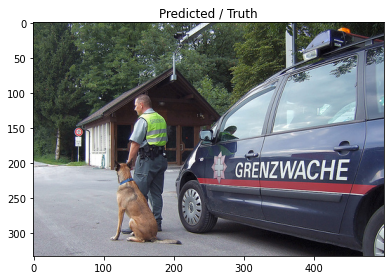

Prediction: 의자에 앉아있는 남자가 의자에 앉아 있습니다. 의자에 앉아있는 남자가 의자에 앉아 있습니다. 의자에 앉아있는 남자. 의자에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP].[SEP].[SEP]에있는[SEP].[SEP].[SEP]에있는[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP]에있는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP].[SEP]의[SEP]에있는[SEP]에있는[SEP].[SEP]에있는[SEP]에있는[SEP][SEP][SEP].[SEP].[SEP].[SEP]에있는[SEP]에있는[SEP]에있는[SEP]에있는[SEP].[SEP]에있는[SEP].[SEP].[SEP].[SEP]에있는[SEP]에있는[SEP].[SEP]에있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에있는[SEP]에있는[SEP].[SEP]에있는[SEP][SEP][SEP][SEP][SEP].[SEP]에있는[SEP]에있는[SEP]에있는[SEP]에있는[SEP]에있는[SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP].[SEP].[SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP]에있는[SEP]에있는[SEP]에있는[SEP].[SEP]에있는[SEP].[SEP].[SEP]에있는[SEP]에있는[SEP].[SEP].[SEP].[SEP].[SEP]에있는[SEP]에있는[SEP]에있는[SEP]에있는[SEP]에있는[SEP].[SEP].[SEP]에, 
Truth:  훈련 된 경찰견은 경찰 밴 앞의 핸들러 옆에 앉아 있습니다. 그의 시계 개를 가진 보안 담당자가 무언가를 찾고 있습니다. 경찰관은 독일 셰퍼드 개와 함께 서 있습니다. 경찰관이 수색견과 함께 거리에서 멈 춥니 다.


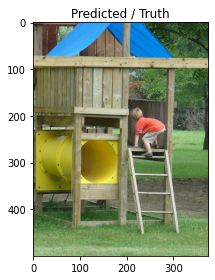

Prediction: 의자에 앉아있는 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 두 남자.[SEP]에 앉아있는 두 남자.[SEP]을 가진 두 남자.[SEP]을보고있는[SEP]는 두 남자[SEP]를보고 있습니다.[SEP]을보고있는[SEP][SEP]는[SEP][SEP] 있습니다.[SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는[SEP]를하는[SEP][SEP][SEP][SEP]습니다.[SEP]를하는[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]를하는 두 남자.[SEP]를하는[SEP][SEP][SEP][SEP][SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 남자.[SEP]를하는[SEP]를하는 남자.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP]를하는 남자.[SEP]를 입은 남자.[SEP]를 입은 남자.[SEP]를 가진 남자.[SEP]는[SEP]는[SEP]는[SEP]는 남자.[SEP]를 가진 남자.[SEP]를하는 남자.[SEP]를 입은 남자.[SEP]습니다.[SEP]는[SEP]습니다.[SEP]는[SEP]는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]를하는[SEP]을 가진[SEP]을 가진 남자.[SEP]를하는 남자.[SEP]를 가진[SEP]를하는[SEP]를하는 남자.[SEP]을하는[SEP]를하는[SEP]를하는[SEP]를하는 남자.[SEP]를 입은 남자.[SEP]를하는 남자.[SEP]를하는[SEP]를하는[SEP]를하는, 
Truth:  어린 소년은 파란 지붕과 노란 터널이있는 정글 gym에서 놀고 있습니다. 빨간 셔츠를 입은 소년이 나무 놀이 세트를 오르고 있습니다. 아이는 정글 체육관에서 사다리를 올라갑니다. 어린 소년이 놀이 구조를 올라갑니다.


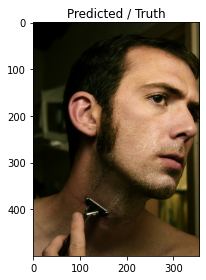

Prediction: 의 머리카락을 가진 남자가 머리카락을 가진 남자가 흰 셔츠를 입은 남자가 머리를 흰 셔츠를 입은 남자가 머리를 봅니다. 셔츠를 입은 남자가 머리를 쳐다보고 있습니다. 셔츠를 입은 남자가 흰 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 남자가 머리를 가진 남자가 흰 셔츠를 입고 있습니다.[SEP]를 가진 남자가 셔츠를 입은 남자가 머리를 입고 있습니다.[SEP]습니다.[SEP]를 입은 남자가 머리를 가진 남자가 흰 셔츠를 입은 남자가 웃고 있습니다.[SEP]를 가진 남자가 웃고 있습니다.[SEP]을 가진 남자가 웃고 있습니다.[SEP]을 가진 남자가 웃고 있습니다.[SEP] 있습니다.[SEP]를 입은 남자가 웃고 있습니다.[SEP]를 입은 남자가 웃고 있습니다.[SEP]를 입은 남자가 웃고 있습니다.[SEP]는 남자가 웃고 있습니다.[SEP]를 가진 남자[SEP]를 입은 남자가 웃고 있습니다.[SEP]습니다.[SEP]습니다.[SEP]는 남자가 웃고 있습니다.[SEP]를 가진 남자[SEP]를 가진 남자[SEP]을 가진 남자[SEP]을 가진 남자[SEP]를 가진 남자[SEP]를 가진 남자[SEP]를 가진 남자[SEP]를 가진 남자[SEP] 있습니다.[SEP]를 가진 남자[SEP]를 가진 남자.[SEP]를 가진 남자가 웃고 있습니다.[SEP]를 가진 남자가 웃고 있습니다[SEP]를 가진, 
Truth:  젊은 성인 남성은 면도기가 목을 내려 가면서 얼굴을 면도했다. 한 남자는 목을 면도하지만 수염은 아닙니다. 한 남자가 조심스럽게 수염을 깎습니다. 면도기와 목을 깎는 남자.


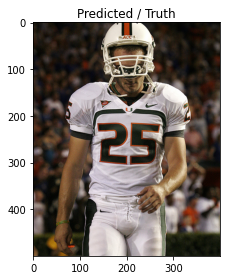

Prediction: 의 흰색 셔츠를 입은 남자는 흰색 셔츠를 입은 남자가 흰색 셔츠를 입은 남자가 흰색 셔츠를 입고 있습니다. 흰색 셔츠를 입은 남자는 흰색 셔츠를 입고 있습니다. 흰색 셔츠를 입은 남자는 흰색 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 남자는 흰 흰 셔츠를 입은 남자가 셔츠를 입은 남자가 흰 흰색 셔츠를 입고 있습니다.[SEP]를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 흰 흰 셔츠를 입고 있습니다.[SEP]을 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 남자가 흰색 셔츠를 입은 남자가 셔츠를 입은 남자가 흰색 흰색 흰색 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]를 입은 남자는 셔츠를 입은 남자는 셔츠를 입은 남자는 셔츠를 입은 남자는 셔츠를 입은 남자가 셔츠를 입은 남자가 흰 흰 흰 셔츠를 입고 있습니다.[SEP]를 입은 남자가 흰 셔츠를 입고 있습니다.[SEP]를 입은 남자, 
Truth:  흰색 유니폼을 입은 축구 선수가 산책하고 내려다 본다. 마이애미 대학교 축구 선수, 25. 축구 선수는 25 번을 가지고 있습니다. 축구 선수의 근접 촬영, 25.


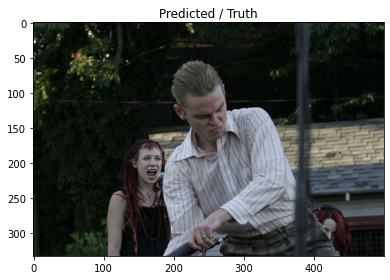

Prediction: 의자에 앉아있는 남자가 의자에 앉아 있습니다. 남자는 의자에 앉아있는 동안 의자에 앉아 있습니다. 남자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자[SEP]에 앉아있는 남자.[SEP]을 가진 남자[SEP][SEP]을 가진 남자[SEP]을 가진 남자.[SEP]을 가진[SEP]고있는 남자.[SEP]는 남자[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]고 있습니다.[SEP]을 가진[SEP]습니다.[SEP]을 가진[SEP]을 가진[SEP]습니다.[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]을 가진 남자.[SEP]을 가진[SEP]을 가진 남자.[SEP]을 가진[SEP]는 남자.[SEP]을 가진[SEP]는 남자.[SEP]을 가진 남자[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 마시[SEP]을 마시는 남자.[SEP]을 마시[SEP]을 마시[SEP]을 마시는 남자.[SEP]을 마시는 남자.[SEP]을 마시는 남자.[SEP]을 마시는 남자.[SEP]을 마시는 남자.[SEP], 
Truth:  두 명의 붉은 머리 여자 앞에 흰색 버튼 업 셔츠를 가진 금발의 남자는 다른 하나는 마이크를 사용하여 헤드폰을 착용하고 있습니다. 줄무늬 셔츠를 입은 남자가 배경에있는 여자가 노래하는 동안 무언가를 흔들려고합니다. 남자가 줄무늬 셔츠를 입고 여자가 노래하고 있습니다. 여자가 밴드에서 노래하고 있습니다.


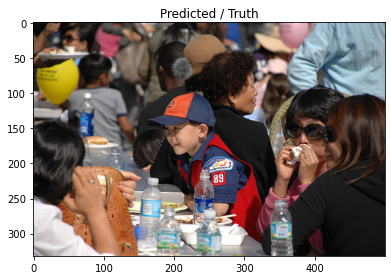

Prediction: 의자에 앉아있는 사람들의 그룹. 사람들은 의자에 앉아 있습니다.[SEP]의 그룹이 의자에 앉아 있습니다.[SEP]의 그룹.[SEP]의 그룹.[SEP]의 그룹.[SEP]iie의 그룹.[SEP]ieeeeee.[SEP]iieeeeeeee.[SEP]ieeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeee를하는 사람들.[SEP]eeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeeee, 
Truth:  아시아 식당의 야외 테이블에 기대어 작은 보이 스카우트. 주황색과 파란색 모자에있는 작은 소년이 외부 테이블에 앉아 있습니다. 유니폼을 입은 소년이 일부 여성들과 함께 테이블에 앉아 있습니다. 밖에서 먹고 술을 마시는 다양한 사람들.


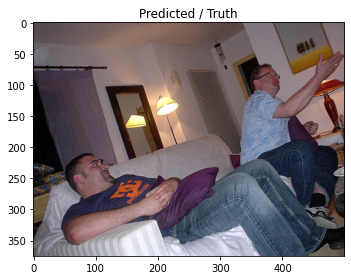

Prediction: 의자에 앉아있는 남자.[SEP]의자에 앉아있는 남자.[SEP] 개가 침대에 앉아 있습니다.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP].[SEP].[SEP]의 남자.[SEP]의 남자.[SEP]의 남자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는 남자.[SEP]에 앉아있는[SEP] 있습니다.[SEP] 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]습니다.[SEP]는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]습니다.[SEP][SEP].[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP].[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP].[SEP][SEP][SEP], 
Truth:  

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 7 summary:
Train loss: 2.5581, validation loss: 2.6630
Train accuracy: 0.3480, validation accuracy: 0.3398
Time per 7 epoch: 69.0 minutes
8/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

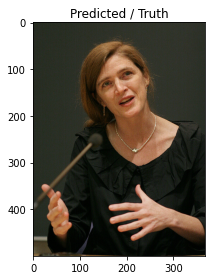

Prediction: 의 머리카락을 가진 남자는 흰색 셔츠를 입은 남자가 흰색 셔츠를 입고 있습니다. 셔츠를 입은 남자가 흰 셔츠를 입고 셔츠를 입고 있습니다. 셔츠를 입은 남자가 흰 셔츠를 입고 있습니다. 셔츠를 입은 남자가 흰 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP]를 입은 남자가 셔츠를 입은 남자[SEP]습니다.[SEP] 셔츠를 입은 남자가 셔츠를 입은 남자[SEP]를 입은 남자가 노래하고 있습니다.[SEP]를 입은 남자가 노래하고 있습니다.[SEP]를 입은 남자가 노래하고 있습니다.[SEP] 셔츠를 입은 남자가 노래하고 있습니다.[SEP] 있습니다.[SEP] 셔츠를 입은 남자가 노래하고 있습니다.[SEP]를 입은 남자가 노래하고 있습니다.[SEP]를 입은 남자가 노래하는 남자가 노래하고 있습니다.[SEP]를 입은 남자가 노래하는 남자[SEP]을 연주하고 있습니다.[SEP]습니다.[SEP]을 연주하고 있습니다.[SEP]을 연주하는 남자[SEP]를 연주하는 남자[SEP]을 연주하는 남자[SEP]을 연주하고 있습니다.[SEP]을 연주하고 있습니다.[SEP]을 연주하고 있습니다.[SEP][SEP]를 연주하고 있습니다.[SEP]를 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을 연주하는 남자[SEP], 
Truth:  검은 셔츠를 입은 중년 여성이 마이크에 말합니다. 손짓을하는 마이크에서 말하는 여성. 강의를하는 검은 셔츠를 입은 여자. 연설을하는 검은 셔츠를 입은 여자.


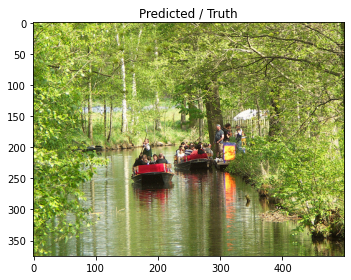

Prediction: 의자에 앉아있는 두 명의 여성이 물의 물에 앉아 있습니다. 두 명의 여성이 물에 앉아 있습니다. 두 명의 여성이 물에 앉아 있습니다.[SEP]의 물에 앉아있는 두 명의 여성.[SEP]의 두 명의 여성이 물에 앉아 있습니다.[SEP]의 물에있는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ers.[SEP]ers.[SEP]ers.[SEP]erss.[SEP]ers의 한[SEP]ers.[SEP]ers.[SEP]ersssssss의 한[SEP]ersss.[SEP]ers의 한[SEP]ers.[SEP]ers.[SEP]ers.[SEP]ers의 한[SEP]ers의 한[SEP]ers의 한[SEP]ers의 한 무리의 사람들이[SEP]ers의 사람들이[SEP]ers의 한 무리의 사람들이[SEP]에 앉아있는[SEP]를 타는[SEP]를 타는 강에 앉아있는[SEP]를 타는 물에 앉아있는[SEP][SEP][SEP]를 타는 사람들.[SEP]를 타는 사람들.[SEP]습니다.[SEP]erss.[SEP]s.[SEP]습니다.[SEP][SEP][SEP]ersss.[SEP]ers.[SEP]ers의 사람들이[SEP]ersss.[SEP]ersss.[SEP]를 타는 카약을하고 있습니다.[SEP]를 타는 사람들[SEP]를 타는 사람들[SEP]ers.[SEP]를 타는 사람들은[SEP]를 타는 카누를 타는 카약, 
Truth:  녹색으로 1 명의 남자가있는 두 보트에있는 사람들. 사람들은 차분한 강 아래로 곤돌라를 타고 있습니다. 두 보트가 조용한 강 아래로 조종되고 있습니다. 강에 두 개의 보트가 떠 다니고 있습니다


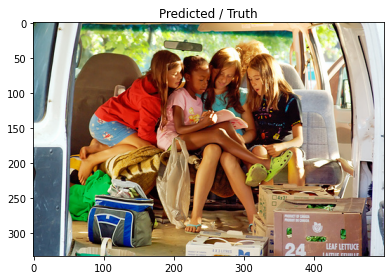

Prediction: 의자에 앉아있는 여자는 앉아 있습니다. 여자는 앉아있는 동안 앉아 있습니다. 여자는 앉아있는 여자와 함께 앉아 있습니다.[SEP] 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]eee.[SEP]e.[SEP]e의 여성.[SEP]e[SEP]e의 소녀[SEP]e.[SEP][SEP][SEP]e[SEP]e.[SEP]e의자.[SEP]e의 소녀[SEP]e의 소녀[SEP]e의자.[SEP]e의 소녀[SEP]e[SEP]에 앉아있는[SEP]e[SEP]e[SEP][SEP][SEP]에 앉아있는[SEP]e.[SEP]e[SEP]e의자.[SEP]e.[SEP]e의 여성.[SEP]e의 소녀[SEP]e의 소녀[SEP]e의 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]터.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]e.[SEP]e[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP]e.[SEP]e.[SEP]e.[SEP][SEP][SEP]e.[SEP]e.[SEP]e.[SEP]e의 소녀[SEP]e의자.[SEP]e의자.[SEP]e의 소녀[SEP]에 앉아있는[SEP]e의 여성.[SEP]e의 앉아있는[SEP]터.[SEP]e의 여성.[SEP]e의 소녀[SEP]e의자.[SEP]eeeeee.[SEP]e, 
Truth:  4 명의 어린 소녀들이 농산물 상자와 함께 차 뒤에 책을 읽는 책을 읽습니다. 책을보고 함께 밴 뒤에 앉아있는 아이들의 그룹. 몇몇 어린 소녀들이 미니 밴에 앉아 있습니다. 어린 소녀 그룹이 책을 들여다 보았습니다.


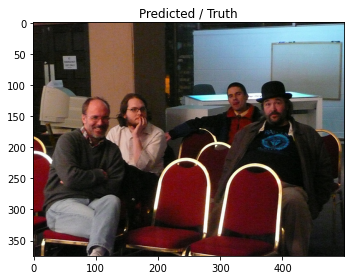

Prediction: 의자에 앉아있는 두 남자가 앉아 있습니다. 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 두 남자.[SEP] 의자에 앉아있는 두 남자.[SEP] 의자에 앉아있는 두 남자[SEP]에 앉아있는 두 남자[SEP] 있습니다.[SEP]에 앉아있는 두 남자[SEP][SEP] 의자에 앉아 있습니다.[SEP] 의자에 앉아있는[SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]e.[SEP]에 앉아있는 두 남자[SEP]it[SEP]it[SEP]에 앉아있는 두 남자.[SEP]에 앉아있는[SEP]에 앉아있는 두 남자.[SEP][SEP][SEP][SEP][SEP]에 앉아있는 두 남자[SEP]에 앉아있는 두 남자.[SEP]에 앉아있는 두 남자.[SEP]을 가진 남자.[SEP]에 앉아있는 두 남자.[SEP] 이야기합니다[SEP] 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP]에 앉아있는 두 남자[SEP] 명[SEP] 명[SEP]에 앉아있는 두 남자[SEP][SEP][SEP]습니다.[SEP] 이야기합니다[SEP] 이야기합니다[SEP]에 앉아있는 두 남자.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP]을 가진[SEP][SEP][SEP][SEP]에 앉아있는 두 남자[SEP]을 가진 남자[SEP]을 가진 남자[SEP]을 가진 남자[SEP]에 앉아있는 두 남자[SEP]에 앉아있는 두 남자.[SEP]에 앉아있는 두 남자[SEP]에 앉아있는 두 남자.[SEP]에 앉아있는 두 남자.[SEP]에 앉아있는 두 남자.[SEP]을 가진, 
Truth:  사진을 위해 포즈를 취하는 4 명의 괴상한. 빨간 의자에 앉아있는 남자 그룹. 의자에 앉아 4 명의 행복한 사람들. 4 명의 남자가 빨간 의자에 앉아 있습니다.


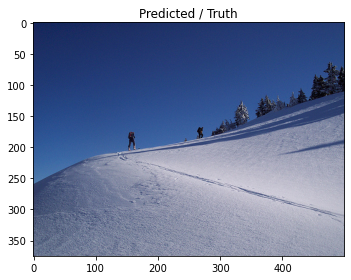

Prediction: 의 스키어는 스키어가파른 눈 덮인 언덕을 덮인 언덕을 스키어. 스키어는 눈 덮인 언덕을 덮인 언덕을 스키어. 눈 덮인 언덕을 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어가 눈 스키어가 눈 스키를 타고 있습니다.[SEP] 스키를 타는 눈 스키를 타는 눈 스키를 타는 눈 스키.[SEP] 스키어.[SEP] 스키어.[SEP] 스키어가 눈 스키어가 눈 스키어가 눈 스키어가 눈 스키어가 눈 스키어가 눈 덮인 언덕을 타고 있습니다.[SEP] 스키.[SEP]를 타는 눈 덮인 산을 타고 있습니다.[SEP] 스키를 타는 눈 덮인 언덕을 타고 있습니다.[SEP]습니다.[SEP]는 스키어가 눈 스키어가 눈 스키.[SEP]를 타는 눈 스키.[SEP] 스키어가 눈 스키.[SEP] 눈 스키를 타는 눈 스키.[SEP] 스키를 타는 눈 스키.[SEP] 눈 스키.[SEP] 스키.[SEP] 스키.[SEP] 눈 스키.[SEP] 스키., 
Truth:  눈 덮인 언덕의 꼭대기에있는 스키어. 두 사람이 눈 덮인 산에 있습니다. 두 사람이 눈 덮인 산을 올라갑니다. 눈 덮인 언덕을 오르는 두 등산객.


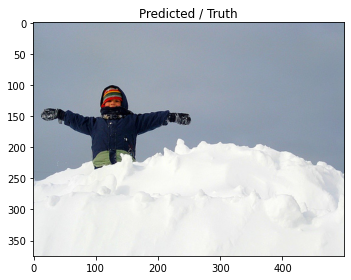

Prediction: 의 스키어는 눈 덮인 언덕을 스키어. 눈 덮인 언덕을 스키어. 눈 덮인 언덕을 스키어. 눈 스키어는 눈 덮인 언덕을 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어.[SEP] 스키어가 눈 스키어가 눈 스키어.[SEP]을 스키어.[SEP] 스키어.[SEP] 스키어가 눈 스키어가 눈을 스키어가 눈을 스키어가 눈을 스키어.[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 스키어가 눈을 스키.[SEP] 스키어가 눈 스키어.[SEP]습니다.[SEP]을 스키어가 눈 스키어가 눈 스키를 타는[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]을 스키.[SEP]습니다[SEP]습니다[SEP] 스키어가 눈을 스키.[SEP]을 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키., 
Truth:  아이는 팔을 뻗은 상태에서 스노우 뱅크 위에 서 있습니다. 겨울 장비의 소년은 뻗은 팔로 눈에 서 있습니다. 어린 소년이 눈 마운드 위에 있습니다. 눈 속에서 놀고있는 작은 소년.


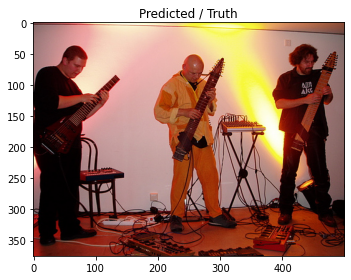

Prediction: 의자에 앉아있는 두 남자가 기타를 연주하고 있습니다. 기타를 연주하는 두 남자. 기타를 연주하는 두 남자. 기타를 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP]을 연주하는 두 남자[SEP][SEP][SEP][SEP][SEP] 기타를 연주합니다.[SEP] 기타를 연주하는 두 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP]을 위해 공연.[SEP]을 연주[SEP][SEP][SEP]을 연주하는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP] 기타를 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP]주하는 두 남자.[SEP][SEP][SEP][SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP][SEP][SEP][SEP][SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP]을 연주하는 두 남자.[SEP]주하는 두 남자.[SEP] 기타를 연주하는 두 남자.[SEP]을 연주, 
Truth:  세 남자는 무대 전체에 전선과 장비로 뮤지컬 세트를하고 있으며 악기와 같은 독특한 기타를 들고 있습니다. 세 남자가 전자의 현악기를 연주하고 있습니다. 세 명의 뮤지션이 악기를 연주하고 있습니다. 세 남자가 함께 음악을 연주하고 있습니다.


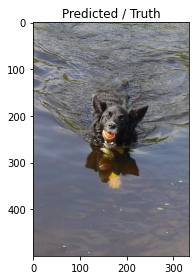

Prediction: 의 개가 물을 통해 달리고 있습니다. 개가 물을 통과합니다.[SEP]을 통과하는 개.[SEP]을 통과하는 개.[SEP]을 통과하는 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]을합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP] 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]을합니다.[SEP]을합니다.[SEP]을합니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]을합니다[SEP]을합니다[SEP][SEP][SEP][SEP][SEP][SEP]를 수영합니다[SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 흰 개.[SEP][SEP][SEP][SEP]는 개가 수영합니다[SEP]는 개[SEP] 있습니다[SEP] 있습니다.[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 8 summary:
Train loss: 2.4583, validation loss: 2.6214
Train accuracy: 0.3574, validation accuracy: 0.3431
Time per 8 epoch: 77.0 minutes
Prediction after 8 epoch.


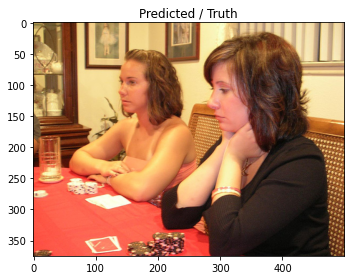

Prediction: 의자에 앉아있는 두 명의 여성이 서로 이야기하고 있습니다. 두 명의 여성이 서로 이야기하고 있습니다. 두 명의 여성이 서로 이야기하고 있습니다. 두 명의 여성이 서로 이야기하고 있습니다.[SEP] 명의 여성이 서로 이야기하고 있습니다.[SEP] 명의 여성[SEP] 명의 여성[SEP] 명의 여성[SEP] 명의 여성[SEP] 명의 여성.[SEP] 명의 여성[SEP]iiiiiiiiiii를합니다.[SEP]iiiiiiiiiii를하는[SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 소녀.[SEP]를하는 두 소녀.[SEP]를하는 두 소녀.[SEP]를하는 두 소녀.[SEP][SEP]를하는 두 소녀.[SEP][SEP][SEP][SEP][SEP]를하는 두 소녀.[SEP]를하는 두 소녀[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]니터를하는 두 소녀[SEP]니터를하는 두 소녀[SEP]를하는 두 소녀[SEP]를하는 두 소녀[SEP]를하는 두 소녀.[SEP]는 두 소녀[SEP]는 두 소녀[SEP]습니다.[SEP]를하는 두 소녀[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]는 두 소녀[SEP]습니다.[SEP]는 두 소녀[SEP]를하는 두 소녀[SEP][SEP]s[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]터를하는 두 소녀[SEP]터를하는 두 소녀[SEP]를하는 두 소녀[SEP]s[SEP]를하는 두 소녀[SEP]를하는 두 소녀[SEP]s.[SEP]를하는 두 소녀[SEP]를하는 두 소녀[SEP]를하는 두 소녀[SEP]를하는 두, 
Truth:  자매들은 차례를 기다리면서 다음 움직임을 기다리고 고민합니다. 카드 게임 포커를 연주하는 빨간 천이있는 테이블에 두 명의 숙녀. 카드 게임을하는 검은 블라우스의 한 여성. 두 명의 숙녀가 카드를하고 도박을합니다.
9/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

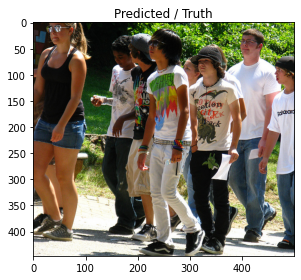

Prediction: 의 그룹이 춤을 추고 있습니다. 춤을 추는 사람들의 그룹.[SEP] 춤을 추는 사람들의 그룹.[SEP] 춤을 추는 사람들.[SEP] 춤.[SEP] 춤을 추는[SEP][SEP][SEP].[SEP]을 추는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]sss.[SEP]sssssssssbeeeeeeeeeeeeeeee를 들고 있습니다.[SEP]sssssbee를 들고있는[SEP]sbeeee를 들고 있습니다.[SEP]sbe를 들고있는[SEP]sssssssssss의 그룹.[SEP]e를 들고있는[SEP]s의 그룹.[SEP]ssssbeeeeeeeeeeee를 들고있는[SEP]를 들고 있습니다.[SEP]를 들고있는[SEP]를 들고있는[SEP]를 들고있는[SEP]s를 들고있는[SEP]ss의 그룹.[SEP]를 입은 남자.[SEP]s의 그룹.[SEP]ssssssssssssssssssssssssssssss의 그룹.[SEP]sss를 들고있는[SEP]ss의 그룹.[SEP]sssssssss를 들고있는[SEP]sssssssssssssssss를 들고있는[SEP]eee, 
Truth:  밝은 화창한 날에 밖으로 걷는 캐주얼 옷을 입은 몇몇 젊은이들. 한 무리의 아이들이 밝은 날에 함께 걷습니다. 젊은 십대 그룹이 야외에서 걷고 있습니다. Preteens 그룹이 강 근처에서 걷는다.


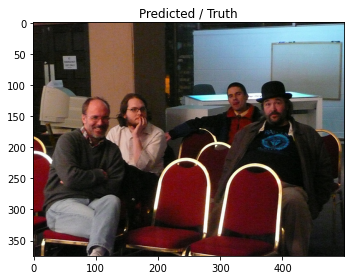

Prediction: 의자에 앉아있는 사람들의 그룹. 의자에 앉아있는 사람들.[SEP] 명이 앉아있는 사람들.[SEP] 명이 앉아있는 사람들.[SEP] 명이 앉아 있습니다.[SEP]iiiiiiii.[SEP]는[SEP]iiiiiiii를합니다[SEP][SEP][SEP][SEP][SEP][SEP]a.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 연주[SEP][SEP][SEP][SEP]는[SEP]는[SEP]a를 연주합니다.[SEP]a의 그룹.[SEP]는[SEP]는[SEP]a의 그룹.[SEP]a의 그룹.[SEP]a의 그룹.[SEP]a의 그룹.[SEP]는[SEP]a의 그룹.[SEP]a의 그룹[SEP]는[SEP]는[SEP]a의 그룹.[SEP]a의 그룹.[SEP]터를 연주하는 테이 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP]를 연주하는 테이션.[SEP]는[SEP]는[SEP]는[SEP]는 테이있는[SEP]의 그룹.[SEP]는 테이블에 앉아있는 사람들.[SEP]는[SEP]는 테이블에 앉아있는[SEP]는 테이블에 앉아 있습니다.[SEP]a의 그룹.[SEP]a의 그룹.[SEP]터를 연주하는 테이 앉아있는[SEP]터를 연주하는 테이블에 앉아있는[SEP]터를 연주하는 테이블에 앉아있는 사람들의 그룹.[SEP]터를 연주하는 테이블에 앉아있는[SEP], 
Truth:  사진을 위해 포즈를 취하는 4 명의 괴상한. 빨간 의자에 앉아있는 남자 그룹. 의자에 앉아 4 명의 행복한 사람들. 4 명의 남자가 빨간 의자에 앉아 있습니다.


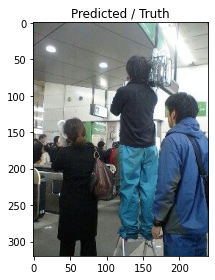

Prediction: 의자에 앉아있는 사람들의 그룹. 사람들은 밤에 앉아 있습니다.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 연주.[SEP]는 사람들.[SEP]는 사람들.[SEP]는 사람들.[SEP]는 사람들.[SEP]는 사람들.[SEP]는 사람들은 십시오는 사람들은 십시는 사람들, 
Truth:  남자와 여자 사이의 계단 사다리에있는 소년. 등이 돌린 세 사람이 건물 안에 서 있습니다. 파란 바지의 카메라맨은 사다리에 서 있습니다. 한 남자가 계단기 위에 서 있습니다.


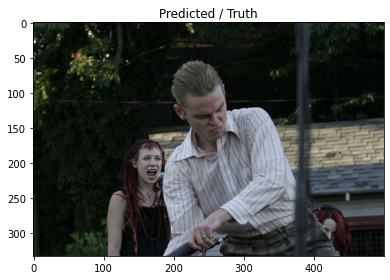

Prediction: 의자에 앉아있는 남자와 여자는 의자에 앉아 있습니다. 남자와 여자는 의자에 앉아 있습니다. 남자와 여자는 의자에 앉아 있습니다. 남자와 여자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자[SEP]을 들고 있습니다.[SEP] 남자와 여자[SEP][SEP][SEP] 남자.[SEP] 남자와 여자.[SEP][SEP][SEP][SEP][SEP] 남자와 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP]을 가진[SEP][SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진 남자.[SEP] 있습니다.[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 들고 있습니다.[SEP]을 가진 남자.[SEP] 있습니다.[SEP] 남자.[SEP]을 가진 남자.[SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP] 남자와[SEP]을 가진[SEP]는 남자.[SEP][SEP][SEP]을 가진 남자.[SEP][SEP][SEP]을 가진 남자.[SEP]을 가진[SEP]는 남자.[SEP]을 가진[SEP]는 남자.[SEP]을 가진 남자.[SEP][SEP][SEP]을 가진[SEP]을 가진[SEP]을 가진 남자.[SEP]을 가진 남자.[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 들고 있습니다.[SEP]을 가진[SEP]을 가진 남자.[SEP]을 들고 있습니다.[SEP]을 들고있는 남자.[SEP]을 들고있는 남자.[SEP]을 가진[SEP], 
Truth:  두 명의 붉은 머리 여자 앞에 흰색 버튼 업 셔츠를 가진 금발의 남자는 다른 하나는 마이크를 사용하여 헤드폰을 착용하고 있습니다. 줄무늬 셔츠를 

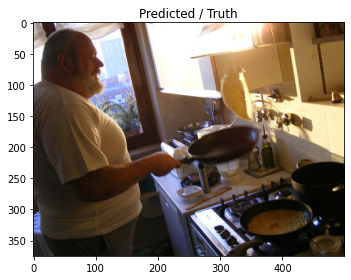

Prediction: 의 의자에 앉아있는 남자는 의자에 앉아 있습니다. 의자에 앉아있는 남자는 의자에 앉아 있습니다. 의자에 앉아있는 남자는 의자에 앉아 있습니다. 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP]는 의자에 앉아있는 남자[SEP]를 의자에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP].[SEP].[SEP][SEP][SEP][SEP].[SEP]는 남자.[SEP]를 위해 음식을 요리[SEP]는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP][SEP][SEP]는 남자.[SEP]을 요리합니다.[SEP]을 요리합니다.[SEP]을 요리합니다[SEP] 있습니다.[SEP] 식사를 요리합니다[SEP]를 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP]를 요리[SEP]는 남자.[SEP]는 요리하는 남자[SEP]는 남자.[SEP][SEP][SEP][SEP]를 요리합니다[SEP][SEP][SEP][SEP]습니다.[SEP]는 남자.[SEP]는 남자.[SEP][SEP][SEP]는 요리합니다[SEP]는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 요리합니다[SEP]는 요리합니다[SEP]을 요리합니다[SEP]를 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 요리합니다.[SEP]를 요리합니다[SEP][SEP][SEP][SEP]를 요리합니다.[SEP]를 요리합니다[SEP]를 위해 요리합니다[SEP]를 위해 요리하는[SEP][SEP][SEP], 
Truth:  나이가 많은 과체중 남자는 아침을 만드는 동안 팬케이크를 뒤집습니다. 한 남자가 부엌에 서서 프라이팬에 크레페를 뒤집습니다

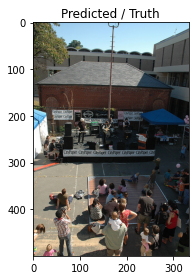

Prediction: 의 그룹은 교회에서 교회에서 교회에서 춤을 추고 있습니다. 교회에서 춤을 추는 사람들. 교회에서 춤을 추는 사람들. 교회에서 춤을 추는 사람들.[SEP]는 교회에서 춤을 추고 있습니다.[SEP]는 춤을 추고 있습니다[SEP]는 사람들.[SEP] 밴드.[SEP]는[SEP]는[SEP]을 위해 밴드.[SEP][SEP][SEP]을 위해[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다[SEP]습니다[SEP]습니다[SEP]을 위해[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 위해 공연합니다.[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다.[SEP]을 위해 공연합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]을 위해 공연합니다[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP][SEP][SEP]을 위해 공연합니다[SEP][SEP]을 위해 공연합니다[SEP]습니다.[SEP]습니다.[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP], 
Truth:  외부의 작은 군중 앞에서 연주하는 밴드. 도시 어린이를위한 

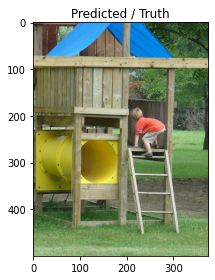

Prediction: 의 셔츠를 입은 남자가 나무를 올라갑니다. 나무를 올라갑니다. 남자는 나무를 올라갑니다. 남자는 나무를 올라갑니다.[SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]를 올라[SEP]는 남자[SEP]는 남자[SEP]를 올라갑니다.[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP][SEP][SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]를 올라갑니다.[SEP]습니다.[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]는 남자.[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]습니다.[SEP]습니다.[SEP]는 남자[SEP]습니다.[SEP]는 남자[SEP]를 올라갑니다[SEP][SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]는 남자[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다[SEP]를 올라갑니다.[SEP]를 올라갑니다.[SEP]를 올라갑니다[SEP]를 올라갑, 
Truth:  어린 소년은 파란 지붕과 노란 터널이있는 정글 gym에서 놀고 있습니다. 빨간 셔츠를 입은 소년이 나무 놀이 세트를 오르고 있습니다. 아이는 정글 체육관에서 사다리를 올라갑니다. 어린 소년이 놀이 구조를 올라갑니다.


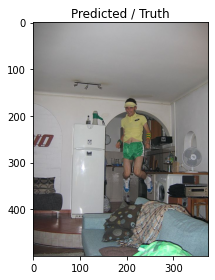

Prediction: 의자에 앉아있는 남자는 의자에 앉아 있습니다. 한 남자가 의자에 앉아 있습니다. 한 남자가 의자에 앉아 있습니다. 남자가 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 남자.[SEP] 의자에 앉아있는 남자.[SEP]에 앉아있는 남자[SEP]을보고 있습니다.[SEP]는 남자[SEP][SEP][SEP][SEP]을 봅니다.[SEP]는 남자[SEP]을 셔츠를 입은 남자[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP]을 의자에 앉아 있습니다.[SEP]습니다.[SEP]습니다.[SEP]는 남자[SEP]는 남자[SEP]를보고 있습니다[SEP]을보고 있습니다[SEP]을보고 있습니다[SEP][SEP][SEP][SEP]는 남자[SEP]을보고 있습니다.[SEP]습니다.[SEP]는 남자[SEP]습니다.[SEP]을보고 있습니다.[SEP]을보고 있습니다.[SEP]을보고 있습니다[SEP]습니다.[SEP]을보고 있습니다[SEP]을보고 있습니다[SEP]을보고 있습니다[SEP]를 입은 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 남자[SEP]는 남자[SEP]습니다.[SEP]는 남자[SEP]을보고 있습니다[SEP]을보고 있습니다.[SEP]을보고 있습니다[SEP]는 남자[SEP]을보고 있습니다[SEP]을보고 있습니다.[SEP]을보고 있습니다.[SEP]을보고 있습니다.[SEP]을보고 있습니다[SEP]을보고 있습니다[SEP]을보고 있습니다[SEP]을보고 있습니다.[SEP]을보고 있습니다.[SEP]을보고 있습니다.[SEP]는 남자[SEP]을보고, 
Truth:  한 남자가 집의 상위 레벨 주방에서 뛰어 내리고 있습니다. 노란색과 녹색 반바지를 입은 남자가 거실에서 점프합니다. 노란 셔츠를 입은 남자가 거실에서 점프하고 있습니다. 노란 셔츠를 입은 남자가 점프하고 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 9 summary:
Train loss: 2.3708, validation loss: 2.5794
Train accuracy: 0.3645, validation accuracy: 0.3482
Time per 9 epoch: 84.0 minutes
10/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

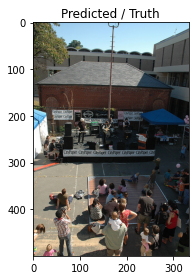

Prediction: 의 사람들은 붐비는 도시의자에 앉아 있습니다. 사람들은 밤에 앉아 있습니다. 사람들은 밤에 앉아 있습니다.[SEP]들은 밤에 앉아 있습니다.[SEP]는 사람들은 밤에 앉아 있습니다.[SEP]이 붐비는[SEP]에 앉아 있습니다.[SEP]는[SEP][SEP][SEP][SEP]에[SEP][SEP][SEP][SEP][SEP]에[SEP][SEP][SEP]입니다.[SEP]이있는[SEP]에[SEP]에[SEP]에[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]는[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]을 위해 모입니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에[SEP]에[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP][SEP].[SEP][SEP]에 앉아 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]는[SEP]는[SEP]을 위해 모입니다.[SEP]는 사람들.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP][SEP]습니다.[SEP]는[SEP]는[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]는[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]을 위해 모입니다[SEP][SEP]을 위해 모입니다.[SEP]는 사람들[SEP]을 위해 모입니다.[SEP]을 위해 모입니다.[SEP]을, 
Truth:  외부의 작은 군중 앞에서 연주하는 밴드. 도시 어린이를위한 오락. 밴드는 손님을 위해 외부에서 공연합

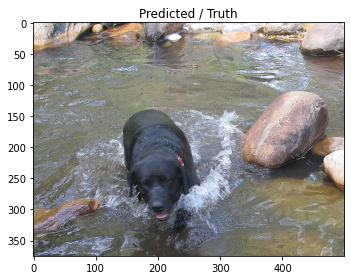

Prediction: 의 개가 물에 튀는 것입니다. 물에 튀는 개. 개가 물에 뿌려집니다.[SEP]는 물에 튀는 개.[SEP] 개가 물에 뿌려집니다.[SEP]는 개가 물에 뿌려집니다[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP] 개[SEP][SEP][SEP][SEP]는 개.[SEP]에[SEP]는 개[SEP] 물에[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다[SEP] 있습니다.[SEP]는 개[SEP]의 개[SEP][SEP][SEP]의 개[SEP]의 개.[SEP]의 개[SEP]의 개[SEP][SEP][SEP][SEP]에[SEP]에[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에[SEP] 있습니다.[SEP]에[SEP][SEP][SEP] 있습니다[SEP] 있습니다.[SEP]에[SEP]에 있습니다.[SEP] 있습니다.[SEP]에[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]에[SEP]에[SEP]에[SEP]에[SEP]에[SEP][SEP][SEP][SEP]에[SEP]는 개[SEP]는 개.[SEP]에[SEP]는 개[SEP]는 개[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP]에[SEP]습니다.[SEP]에[SEP][SEP][SEP]는 개[SEP]는 개.[SEP]는 개[SEP] 있습니다[SEP] 있습니다.[SEP] 있습니다[SEP][SEP][SEP][SEP][SEP][SEP]는 개[SEP] 있습니다.[SEP] 있습니다[SEP]는 개[SEP]에[SEP] 있습니다.[SEP] 있습니다[SEP] 있습니다[SEP][SEP][SEP]에[SEP]에[SEP] 있습니다[SEP] 있습니다[SEP] 있습니다[SEP][SEP][SEP][SEP]에[SEP] 있습니다.[SEP]에있는[SEP]에[SEP]에[SEP] 있습니다.[SEP] 있습니다[SEP]는 개

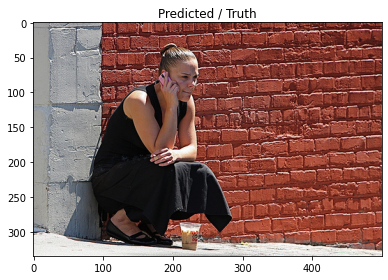

Prediction: 의 여성은 의자에 앉아 있습니다. 의자에 앉아있는 여자. 여자는 의자에 앉아 있습니다. 여자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 여자.[SEP] 의자에 앉아있는 여자.[SEP] 의자에 앉아있는 여자.[SEP] 의자에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP] 있습니다.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]에 앉아있는[SEP].[SEP][SEP][SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP] 있습니다.[SEP]에 앉아있는[SEP] 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP]에 앉아있는[SEP] 있습니다.[SEP] 있습니다.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP][SEP]에 앉아있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP][SEP]에 앉아있는[SEP] 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP], 
Truth:  모든 검은 색의 한 여성은 전화를 걸면

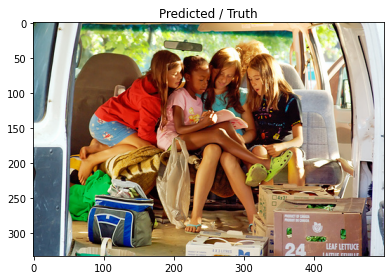

Prediction: 의자에 앉아있는 사람들의 그룹. 사람들은 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 사람들의 그룹.[SEP]의 그룹.[SEP]의 그룹이 앉아 있습니다.[SEP]에 앉아있는[SEP]iii.[SEP]는[SEP]iiii를합니다[SEP][SEP][SEP][SEP][SEP][SEP]iiiii를합니다.[SEP]iiiiiiiiiiiiiiiiiiiiiii를 즐기는[SEP].[SEP][SEP][SEP]는[SEP]는[SEP] 게임을합니다.[SEP] 게임을 즐기는[SEP] 게임을합니다.[SEP]는[SEP] 게임을합니다.[SEP][SEP]는[SEP]는[SEP] 게임을하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 게임을합니다.[SEP]를 즐기는[SEP]는[SEP]습니다.[SEP]는 사람들.[SEP]a의 그룹.[SEP]의 그룹.[SEP] 있습니다.[SEP] 게임을하는 사람들[SEP] 게임을하는[SEP] 게임을하는[SEP]를하는 사람들[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는 사람들[SEP]습니다.[SEP]를 즐기는 의 그룹[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 게임을하는 사람들[SEP]는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP]a의 그룹.[SEP]a의 그룹.[SEP]터를 즐기는 게임을하는 사람들의 그룹.[SEP]터를 즐기는 게임을하는 사람들[SEP] 게임을하는 사람들[SEP]를 즐기는 사람들의 그룹.[SEP]를 즐기는 사람들[SEP]iiiiiiiiiiii, 
Truth:  4 명의 어린 소녀들이 농산물 상자와 함께 차 뒤에 책을 읽는 책을 읽습니다. 책을보고 함께 밴 뒤에 앉아있는 아이들의 그룹. 몇몇 어린 소녀들이 미니 밴에 앉아 있습니다. 어린 소녀 그룹이 책을 들여다 보았습니다.


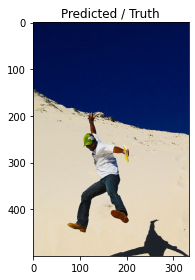

Prediction: 의 모래에 서있는 남자. 모래에 서있는 남자. 모래에 서있는 남자.[SEP] 모래에 서있는 남자.[SEP] 모래에 서있는 남자.[SEP] 모래에 서있는 남자.[SEP]에 서있는 남자.[SEP]에 서있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을합니다.[SEP]을하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]을[SEP]는 남자.[SEP]을[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]는 남자.[SEP]을[SEP][SEP][SEP][SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을합니다.[SEP]을[SEP]는 남자.[SEP]는 남자.[SEP]을합니다.[SEP]을합니다.[SEP]을 입은 남자.[SEP]을하는 남자.[SEP]을 입은 남자.[SEP]을[SEP]을[SEP][SEP][SEP]를하는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]을[SEP]는 남자.[SEP]을[SEP]을[SEP]습니다.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]는 남자.[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을하고 있습니다.[SEP]을[SEP]을[SEP]을[SEP]을[SEP]는 남자.[SEP]는 남자.[SEP]을[SEP]을하는 남자.[SEP]을하는 남자.[SEP]을[SEP], 
Truth:  녹색 모자와 흰색 티셔츠를 입은 남자가 모래 언덕에서 점프합니다. 녹색 모자를 쓴 남자가 눈 덮인 언덕을 뛰어 넘고 있습니다. 한 남자가 

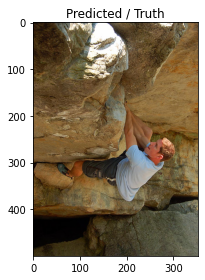

Prediction: 바위 절벽 등반가 많은 바위 절벽 등반입니다. 바위 얼굴을 오르는 바위 얼굴을 오르는 사람. 바위 얼굴을 오르는 남자.[SEP] 암벽 등반.[SEP] 암벽 등반.[SEP] 암벽 등반[SEP] 암벽 등반[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP] 암벽 등반[SEP][SEP][SEP] 암벽 등반.[SEP] 암벽 등반[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]습니다.[SEP] 암벽 등반[SEP] 암벽 등반.[SEP] 암벽 등반[SEP] 암벽 등반[SEP][SEP][SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반.[SEP]습니다.[SEP]습니다.[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP]를 오르는 남자.[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP]습니다.[SEP]습니다.[SEP] 암벽 등반[SEP]습니다.[SEP]습니다.[SEP] 암벽 등반[SEP] 암벽 등반[SEP]는 남자.[SEP] 암벽 등반[SEP][SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP] 암벽 등반[SEP], 
Truth:  바위 절벽을 오르는 가벼운 셔츠에 남자가 있습니다. 남자는 암벽 등반입니다. 남자는 암벽 등반입니다. 남자 암벽 등반.


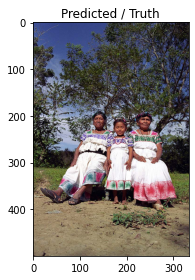

Prediction: 의자에 앉아있는 사람들. 사람들은 나무가있는 나무를 바라보고 있습니다. 사람들은 나무를보고 있습니다.[SEP]를 즐기는 사람들.[SEP]를 즐기는 사람들.[SEP]를 즐기는 사람들.[SEP]를 즐기는[SEP]를 즐기고 있습니다[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP]를 즐기고 있습니다.[SEP]를 즐기는[SEP][SEP][SEP]를 즐기는[SEP]를 즐기고 있습니다.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기고 있습니다.[SEP][SEP][SEP]를 즐기는[SEP]를 즐기고 있습니다.[SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]을 즐기고 있습니다.[SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP]를 즐기는 사람들[SEP]를 즐기는[SEP]를 즐기는 사람들[SEP]를 즐기는 사람들.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]를 즐기는 사람들[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]습니다.[SEP]를 즐기는 사람들[SEP]를 즐기는 사람들[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP]를 즐기는 사람들[SEP]를 즐기는 사람들[SEP]를 즐기는 사람들.[SEP]를 즐기는 사람들[SEP]를 즐기는 사람들[SEP]를 즐기는 사람들[SEP]를 즐기는, 
Truth:  세 명의 여성, 모두 같은 유형의 흰색이지만 화려한 드레스를 입고 앉아서 빛나는 것처럼

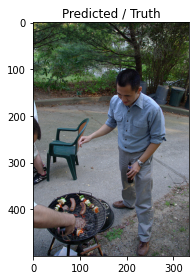

Prediction: 의 여성은 나무 나무를 나무를 쳐다보고 있습니다. 나무를보고있는 여자. 여자는 나무를보고있는 여자. 여자는 나무를보고 있습니다.[SEP] 나무를보고있는 여자.[SEP] 나무를보고있는 여자.[SEP] 나무를보고있는 여자.[SEP]을보고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP][SEP][SEP][SEP][SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP][SEP][SEP]을 가진[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 위해 즐[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 위해 즐깁니다.[SEP]을 가진 여자.[SEP]을 위해 즐깁니다.[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 위해 셔츠를 가진 여자.[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을보고있는 여자.[SEP]는 여자.[SEP]을 위해 셔츠를 입은 여자.[SEP]을보고있는[SEP]을 가진 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을 위해 셔츠를보고있는[SEP]을보고있는 여자.[SEP]을보고있는[SEP]을 위해 셔츠를 입은 여자.[SEP]을 위해 즐겁게에서 셔츠를 가진[SEP]을보고, 
Truth:  맥주를 들고있는 남자 그릴과 파란색 셔츠를 입은 다른 남자. 이 아시아 남자는 맥주를 마시고 남자 그릴을보고 있습니다. 아시아 남자는 바베큐에 음식을 굽는 사람을 보는 아시아 남자. 병을 들고있는 남자가 그릴 위에 서 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 10 summary:
Train loss: 2.2893, validation loss: 2.5457
Train accuracy: 0.3745, validation accuracy: 0.3522
Time per 10 epoch: 92.0 minutes
Prediction after 10 epoch.


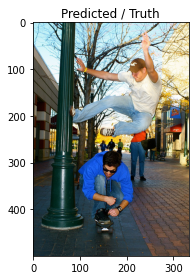

Prediction: 의 여성은 나무 나무에 앉아 있습니다. 나무에 앉아있는 여성. 나무에 앉아있는 여성.[SEP]에 앉아있는 여성.[SEP]에 앉아있는 여자.[SEP] 나무에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]을 가진 여자.[SEP]는[SEP]을 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을 위해 포즈를 취합니다[SEP]을[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]는[SEP]을[SEP]습니다.[SEP]을[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]습니다.[SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP]습니다.[SEP]을 위해 포즈를 취합니다[SEP]을 위해 포즈를 취합니다[SEP][SEP][SEP]을 위해 포즈를 취합니다[SEP]습니다.[SEP]습니다.[SEP]는 여자.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 여자.[SEP]습니다.[SEP]는 여자[SEP]을[SEP]을[SEP][SEP][SEP]을[SEP]을[SEP]을[SEP]는 여자.[SEP]을[SEP]을[SEP]는 여자[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]는 여자.[SEP]습니다.[SEP]는 여자.[SEP]는 여자.[SEP]을 위해 셔츠를 위해 셔츠를, 
Truth:  한 남자는 가라테가 라이트 포스트를 걷어차는 동안 선글라스를 입은 다른 친구는 그의 다리 아래에 스케이트 보

  0%|          | 0/100 [00:00<?, ?it/s]

test_bleu1: 0.0121 test_bleu4: 0.0031 
11/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

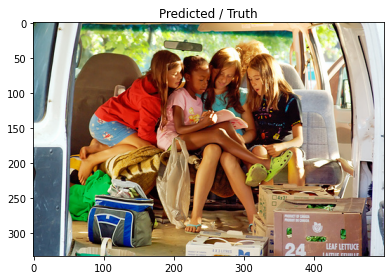

Prediction: 의 여성은 의자에 앉아있는 동안 앉아 있습니다. 한 여성이 의자에 앉아 있습니다. 한 여성이 의자에 앉아 있습니다. 한 여성이 의자에 앉아 있습니다.[SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]는 앉아 있습니다[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]e에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]의 여성.[SEP]의 여성.[SEP]에 앉아 있습니다[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP] 있습니다.[SEP]에 앉아있는[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP][SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP]a.[SEP]e의 여성.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP]에 앉아있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 여자.[SEP]에 앉아있는 여자.[SEP]에 앉아있는[SEP]에 앉아있는

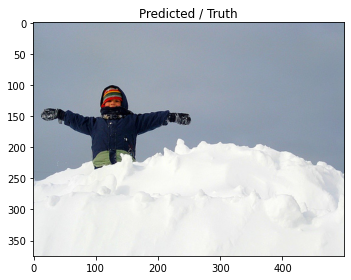

Prediction: 의 눈 덮인 산을 덮인 산을 오르는 사람. 눈 덮인 산을 오르는 사람이 눈 덮인 산을 덮고 있습니다. 눈 덮인 산을 오르는 사람이 눈 덮인 산을 덮인 언덕을 썰어 있습니다.[SEP] 덮인 산을 오르는 사람이 눈 덮인 산을 덮인 언덕을 덮고 있습니다.[SEP]고있는 동안 눈 덮인 산을 덮인 산을 덮인 산을 덮인 산을 오르고 있습니다.[SEP]고 있습니다.[SEP]는 눈 덮인 산을 오르고 있습니다.[SEP]는 눈 덮인 산을 덮인 산을 오르고 있습니다.[SEP]는 사람이 눈 덮인 산을 오르고 있습니다.[SEP] 덮인 산을 덮인 산을 오르고 있습니다.[SEP]을 덮인 산을 오르고 있습니다.[SEP]는 사람이 눈 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 오르고 있습니다.[SEP]는 사람.[SEP]는 눈 덮인 산을 오르고 있습니다.[SEP]을 오르고 있습니다.[SEP]을 오르는 사람.[SEP]는 사람이 눈 썰어.[SEP]는 눈 덮인 산을 덮인 산, 
Truth:  아이는 팔을 뻗은 상태에서 스노우 뱅크 위에 서 있습니다. 겨울 장비의 소년은 뻗은 팔로 눈에 서 있습니다. 어린 소년이 눈 마운드 위에 있습니다. 눈 속에서 놀고있는 작은 소년.


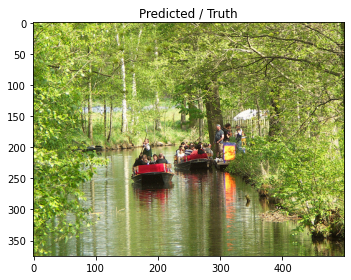

Prediction: 의 카누에 앉아있는 두 남자가 카누에 앉아 있습니다. 카누에 앉아있는 두 남자. 카누에 카누에 앉아있는 두 남자. 카누에 앉아있는 두 남자.[SEP] 카누에 앉아있는 두 남자.[SEP] 카누에 앉아있는 두 남자.[SEP] 카누에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 카누.[SEP] 카누.[SEP]oooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooo, 
Truth:  녹색으로 1 명의 남자가있는 두 보트에있는 사람들. 사람들은 차분한 강 아래로 곤돌라를 타고 있습니다. 두 보트가 조용한 강 아래로 조종되고 있습니다. 강에 두 개의 보트가 떠 다니고 있습니다


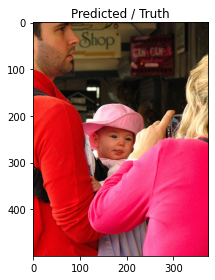

Prediction: 의 여성은 의자에 앉아 있습니다. 의자에 앉아있는 여자. 여자는 의자에 앉아있는 여자. 여자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 여자.[SEP] 의자에 앉아있는 여자.[SEP] 의자에있는 여자.[SEP] 스탠드에있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP]을 가진[SEP]을 가진[SEP].[SEP]을 가진[SEP]습니다.[SEP]습니다.[SEP]의 여자.[SEP]s.[SEP]을 가진[SEP]을 가진[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는 여자.[SEP]에있는[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 가진[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 가진 여자[SEP][SEP][SEP]를 가진 여자.[SEP]에[SEP]는 여자.[SEP]는 여자.[SEP]는 여자.[SEP]을 가진 여자.[SEP]를 가진 여자.[SEP]을 가진 여자.[SEP]을 가진[SEP]습니다.[SEP]을 가진[SEP]는 여자[SEP][SEP]을 가진[SEP][SEP][SEP][SEP][SEP]을 가진[SEP]을 가진[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 가진 여자.[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP][SEP].[SEP]을 가진 여자.[SEP]를 가진 여자.[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진, 
Truth:  여자가 아기의 사진을 찍는 동안 남자가 아기를 안고 있습니다. 핑크 모자를 쓴 아기, 남자가 빨간색으로 붙잡고 여자가 분홍색으로 여자. 여자는 남자가 붙잡는 아기의 사진을 찍습니다. 여자는 분홍색 모자로 아기 사진을 찍

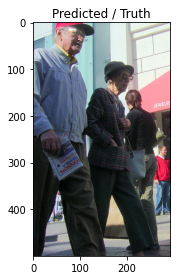

Prediction: 의 여성은 교회에서 춤을 추고 있습니다. 춤을 추는 여성. 춤을 추는 여성. 춤을 추는 여자.[SEP]는 춤을 추는 여자[SEP] 춤을 추고 있습니다.[SEP]는 춤을 추고 있습니다[SEP][SEP][SEP][SEP][SEP]sssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  나이가 많은 부부는 화창한 날에 보석 가게를지나 걷고 있습니다. 두 명의 노인이 화창한 날에 길을 걷고 있습니다. 화창한 날에 바쁜 거리를 걷는 두 노인 노인 커플이 함께 걷는다.


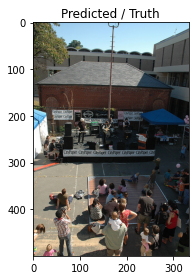

Prediction: 의자에 앉아있는 사람들. 사람들은 밤에 앉아 있습니다.[SEP]판에서 교회에서 춤을 추고 있습니다. 사람들은 밤에 춤을 추고 있습니다.[SEP]는 사람들의 그룹.[SEP]iiiii를 연주합니다.[SEP]iiiiiiiii를 연주합니다.[SEP]는 사람들[SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiiii를 연주합니다.[SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 연주합니다.[SEP]는 밴드.[SEP] 밴드.[SEP]터.[SEP]터.[SEP] 있습니다.[SEP]는 밴드.[SEP]는 밴드[SEP]는 연주합니다[SEP]를 연주합니다[SEP]는 콘서트를 연주하는 사람들.[SEP]는 밴드.[SEP]는 밴드는 밴드.[SEP]는 밴드.[SEP]는 콘서트[SEP]는 콘서트[SEP]는 밴드.[SEP]는 바이 무대에서 공연합니다[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 연주하고 있습니다.[SEP]iiiiiiiiiiiiiiiiiiiiii, 
Truth:  외부의 작은 군중 앞에서 연주하는 밴드. 도시 어린이를위한 오락. 밴드는 손님을 위해 외부에서 공연합니다. 주차장에서 콘서트.


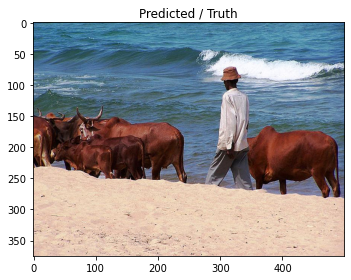

Prediction: 의 갈색 개가 해변에 앉아 있습니다. 갈색 개는 해변에 앉아 있습니다. 갈색 개가 해변에 앉아 있습니다.[SEP]에 앉아있는 갈색 개.[SEP] 개가 해변에 앉아 있습니다.[SEP]에 앉아있는 개[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자[SEP]에 앉아있는 남자[SEP][SEP]에 앉아 있습니다.[SEP]에 앉아있는 남자[SEP]에 앉아[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP][SEP][SEP]에 앉아있는 남자[SEP]에 앉아있는 남자[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자[SEP]에 앉아있는 남자[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자[SEP]에 앉아있는 남자[SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 앉아있는 남자.[SEP][SEP][SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아있는 남자.[SEP]에 앉아, 
Truth:  모자를 쓴 흑인, 해변에서 황소와 함께 걷는 흑인. 해변에서 소 떼와 함께 걷는 남자. 해변에서 하루를 즐기는 조향과 남자. 해변에서 황소를 떼어내는 남자


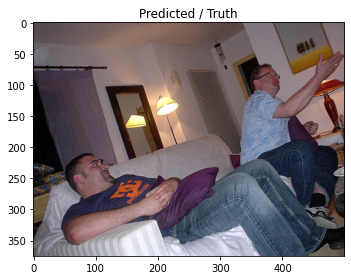

Prediction: 의자에 앉아있는 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 두 남자.[SEP] 의자에 앉아있는 두 남자.[SEP]을 가진 두 남자.[SEP]을보고있는 두 남자.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]을합니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]의[SEP]습니다.[SEP]의[SEP]의[SEP]의[SEP]의[SEP]의 남자[SEP].[SEP].[SEP]에있는[SEP]에 앉아있는[SEP][SEP][SEP][SEP].[SEP].[SEP]에 앉아있는 두 남자[SEP]에 앉아있는 두 남자[SEP].[SEP]을 가진 남자.[SEP]을보고 있습니다.[SEP]의 남자[SEP] 있습니다.[SEP] 있습니다.[SEP]에 앉아있는 남자[SEP]에 앉아있는[SEP]에 앉아있는 두 남자.[SEP]에 앉아있는 두 남자[SEP]에 앉아있는 두 남자[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 입은 남자.[SEP]을보고있는 남자.[SEP]을보고있는 남자.[SEP]을보고있는 두 남자.[SEP]이[SEP]을보고있는[SEP]을보고있는 두 남자.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]에 앉아있는 두 남자.[SEP]을보고있는 두 남자.[SEP]을, 
Truth:  청바지를 입은 두 남자가 흰 소파에 앉아 있습니다. 방에 소파에 앉아있는 두 남자. 두 남자가 흰 소파에 앉아 있습니다. 남자는 벽에 그림을 만지고 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 11 summary:
Train loss: 2.2160, validation loss: 2.5282
Train accuracy: 0.3815, validation accuracy: 0.3552
Time per 11 epoch: 110.0 minutes
12/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

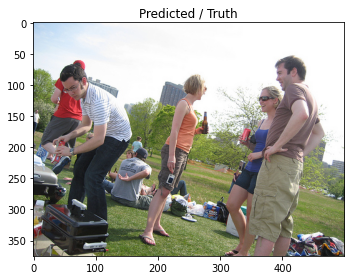

Prediction: 의 여성은 나무를보고 있습니다. 한 여성이 나무를보고 있습니다. 한 여성이 나무를보고 있습니다. 여자는 나무를보고 있습니다.[SEP]를보고있는 여자.[SEP]를보고있는 여자.[SEP]를보고있는 여자[SEP]를보고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 즐기는 여자[SEP][SEP][SEP][SEP]를합니다.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP].[SEP].[SEP][SEP]를 즐기는 여자[SEP]를 즐기는[SEP][SEP][SEP].[SEP].[SEP].[SEP]을 즐기는 여자[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]를 즐기는 여자[SEP]를 즐기는[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP].[SEP].[SEP].[SEP] 있습니다.[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를 즐기는 여자[SEP]를, 
Truth:  한 무리의 사람들이 공원에서 맥주를 즐기고 있습니다. 한 무리의 사람들은 외부 요리를 가지고

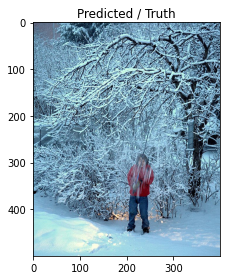

Prediction: 의 붉은 머리의 아이는 붉은 머리카락을 가진 아이가 붉은 머리의 아이가 붉은 머리의 아이가 붉은 머리를 봅니다. 아이는 눈을 덮인 언덕을 뚫고 있습니다. 아이는 눈을 덮고 덮인 언덕을 뚫고 있습니다.[SEP]는 눈을 덮인 언덕을 덮인 언덕을 덮고 있습니다.[SEP]는 아이.[SEP]는 아이.[SEP]는 아이[SEP] 덮인 언덕을 덮인 언덕을 삽질합니다.[SEP] 삽질하는 아이.[SEP]을 삽질하는 아이.[SEP]는 아이.[SEP] 삽질하는 아이.[SEP]을 삽질하는 아이.[SEP]을 삽질하는 아이.[SEP]을 삽질하는 아이.[SEP] 삽질을 삽질하는[SEP][SEP][SEP] 삽질하는 아이.[SEP]을 삽질하는 아이.[SEP]는 아이.[SEP]는 아이.[SEP]을 삽질하는 아이.[SEP]을 삽질하는[SEP]는 아이.[SEP]는 아이.[SEP][SEP][SEP][SEP]을 삽질하는[SEP]을 삽질하는[SEP]습니다.[SEP]을 삽질하는 아이.[SEP]을 삽.[SEP]을 삽.[SEP]을 삽질하는[SEP]을 삽질하는 아이.[SEP]을 삽질하는 아이.[SEP]을 삽질하는[SEP]을 삽.[SEP], 
Truth:  빨간 재킷을 입은 소년은 막대기로 눈 덮인 나무를 때립니다. 빨간 재킷을 입은 사람은 눈 덮인 나무 아래에 서 있습니다. 아이는 눈 덮인 나무 아래에 서 있습니다. 어린 소년이 나무에서 눈을 흔들립니다.


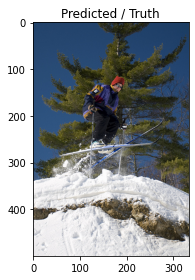

Prediction: 의 스키어는 스키어가 스키어가 스키어에 있습니다. 스키어는 스키어가 스키어가 스키어가 스키어에 있습니다. 스키어가 스키어가 스키어가 스키어.[SEP] 스키어가 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP][SEP][SEP][SEP][SEP] 스키.[SEP][SEP][SEP][SEP][SEP] 스키.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 스키.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP][SEP][SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키[SEP] 스키.[SEP][SEP][SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP] 스키.[SEP], 
Truth:  스키어는 소나무 앞에서 눈 덮인 마운드 위로 뛰어 내리고 있습니다. 이 사람은 스키를 타는 동안 언덕에서 뛰어 내리고 있습니다. 스키를 타는 사람이 작은 언덕을 뛰어 넘고 있습니다. 스키어는 나무 앞에서 공중에 있습니다.


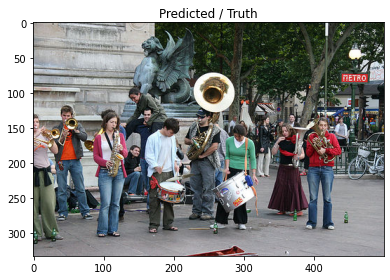

Prediction: 의 밴드는 밴드와 함께 연주합니다. 밴드는 밴드와 함께 연주합니다. 밴드는 밴드와 함께 연주합니다. 밴드는 밴드와 함께 연주합니다.[SEP] 밴드가 밴드에서 연주합니다.[SEP] 밴드가 밴드에서 연주합니다.[SEP] 밴드[SEP]는 밴드[SEP][SEP][SEP][SEP] 밴드.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 밴드.[SEP] 밴드.[SEP] 밴드.[SEP] 밴드.[SEP][SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드를 연주[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드[SEP]는 밴드[SEP]ss의 밴드.[SEP]는 밴드.[SEP]s의 밴드를 연주[SEP]s의 밴드.[SEP]는 밴드[SEP]treet는 밴드[SEP] 밴드[SEP] 밴드.[SEP]ssssssssssssssss와 함께 연주, 
Truth:  남자와 여자의 밴드가 거리에서 음악을 연주하고 있습니다. 한 무리의 사람들이 악기를 연주하고 있습니다. 밴드는이 도시에서 음악을 연주하고 있습니다. 군중을 즐겁게하는 밴드.


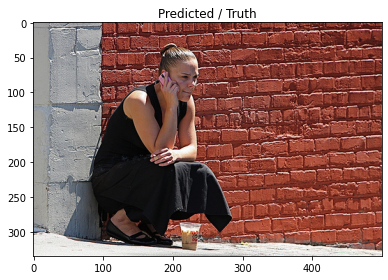

Prediction: 의 여성은 벽에 벽에 벽에 벽에 벽에 벽에 벽이 있습니다. 벽에 벽에 벽에 벽에 벽에 벽에 벽에 벽에 벽에 벽에 벽. 벽에 벽에 벽에 벽에 벽.[SEP]는 벽에 벽에 벽에 벽에 벽에 벽.[SEP]는 벽에 벽에 벽에 벽.[SEP]는 벽에 벽에 벽에 벽.[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP]oooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooooog.[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP]oooooop.[SEP][SEP][SEP][SEP]ooops.[SEP]oops.[SEP]s.[SEP]ooooooooooooooooooooooooooooooooooops.[SEP]ooooooooooooooooooooooooooooooooooooooo, 
Truth:  모든 검은 색의 한 여성은 전화를 걸면서 벽에 웅크 리고 있습니다. 여자는 핸드폰으로 말하면서 벽돌 벽에 웅크 리고 있습니다. 벽돌 벽 앞에서 분홍색 핸드폰에 대해 이야기하는 여자. 벽돌 벽 옆에 전화를 한 여성.


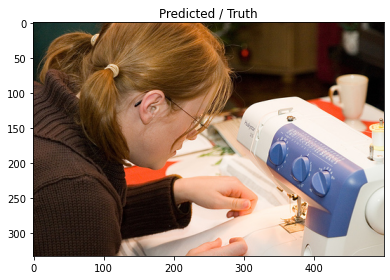

Prediction: 의자에 앉아있는 여자는 의자에 앉아 있습니다. 여자는 의자에 앉아 있습니다. 여자는 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 여자.[SEP] 의자에 앉아있는 여자.[SEP]을 먹는 여자[SEP][SEP]를 먹습니다.[SEP]을 먹는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]을 먹는[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 먹습니다.[SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP][SEP][SEP]의[SEP]의 한 여자[SEP]를 먹습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 먹습니다.[SEP]를 먹습니다.[SEP]을 먹습니다.[SEP]을 먹습니다.[SEP]을 먹습니다.[SEP]을 먹습니다.[SEP][SEP][SEP][SEP]을 먹습니다.[SEP][SEP][SEP][SEP][SEP]를 먹는 여자[SEP]는[SEP]는[SEP]는[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]를 먹습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 먹습니다.[SEP]을 먹습니다.[SEP]을 먹습니다.[SEP]을 먹습니다.[SEP]을 먹는[SEP][SEP][SEP]을 먹습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 먹습니다.[SEP]를 먹습니다.[SEP]를 먹습니다.[SEP]을 먹는[SEP]을, 
Truth:  갈색 스웨터의 한 여성이 기계에 꿰매고 있습니다. 안경을 쓴 여성은 재봉틀을 사용합니다. 갈색 스

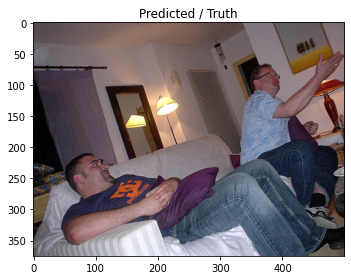

Prediction: 의자에 앉아있는 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다.[SEP] 명의 여성이 의자에 앉아 있습니다.[SEP]는 두 명의 여성.[SEP]을 위해 포즈를 취합니다[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]의자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]의자.[SEP]의자.[SEP]의자에 앉아있는[SEP]의자.[SEP].[SEP].[SEP][SEP][SEP].[SEP]의자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]의자에 앉아있는[SEP][SEP]의자에 앉아있는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]의자에 앉아있는[SEP].[SEP].[SEP]의자에 앉아있는[SEP][SEP][SEP][SEP][SEP]의[SEP]의자에 앉아있는[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP]의자.[SEP]의자에 앉아있는[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP]의자.[SEP]의자.[SEP]의자에 앉아있는[SEP]의자에 앉아있는[SEP].[SEP]의자에 앉아있는[SEP].[SEP].[SEP].[SEP]의자.[SEP]의자.[SEP].[SEP].[SEP].[SEP]의자에 앉아있는[SEP].[SEP], 
Truth:  청바지를 입은 두 남자가 흰 소파에 앉아 있습니다. 방에 소파에 앉아있는 두 남자. 두 남자가 흰 소파에 앉아 있습니다. 남자는 벽에 그림을 만지고 있습니다.


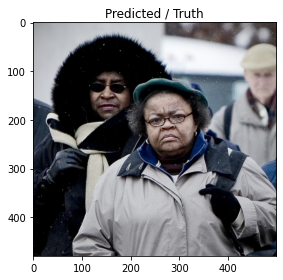

Prediction: 의 두 명의 여성이 서로 옆에 서 있습니다. 두 명의 여성이 서로 이야기하고 있습니다. 두 명의 여성이 서로 이야기하고 있습니다. 두 명의 여성이 서로 이야기합니다.[SEP]의 두 명의 여성이 서로 이야기합니다.[SEP]의 두 명의 여성이 서로 이야기합니다.[SEP][SEP][SEP][SEP][SEP]의 두 명의 여성.[SEP][SEP][SEP][SEP][SEP][SEP]에 있습니다[SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP]sss.[SEP][SEP]sbe[SEP]ss.[SEP]ssssssssssssssssssbe.[SEP]ssssssbe.[SEP]sbe[SEP]ssssssssssssbe.[SEP]s의 두 사람[SEP]ss.[SEP]ssbe.[SEP]sssbe.[SEP]sbe에있는 두 사람.[SEP]sbe[SEP]s의 두 사람[SEP]에있는 두 사람.[SEP]ssssssss의 두 명의 여성이 서로 이야기합니다.[SEP]ssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  두 사람이 무거운 옷을 입고 있습니다. 겨울 장비의 여성과 남자. 두 명의 여성이 눈 덮인 날에 묶여있었습니다 겨울 옷을 입은 두 사람.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 12 summary:
Train loss: 2.1440, validation loss: 2.5180
Train accuracy: 0.3896, validation accuracy: 0.3562
Time per 12 epoch: 118.0 minutes
Prediction after 12 epoch.


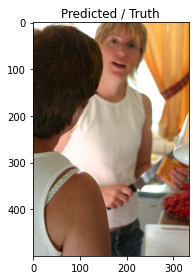

Prediction: 의 여성은 흰 셔츠를 입은 여성이 흰 셔츠를 입은 여자를보고 있습니다. 흰 셔츠를 입은 여성이 흰 셔츠를 입은 여자를보고 있습니다. 흰 셔츠를 입은 여자가 흰 셔츠를 입고 셔츠를 입은 여자를보고 있습니다.[SEP] 셔츠를 입은 여자가 흰 셔츠를 입은 여자가 셔츠를보고 있습니다.[SEP]를 입은 여자가 흰 셔츠를보고 있습니다.[SEP]를 입은 여자.[SEP]를 입은 여자가 셔츠를 입은 여자가 흰 셔츠를 입은 여자.[SEP]를 입은 여자가 셔츠를 입은 여자.[SEP]를 입은 여자가 셔츠를 입은 여자.[SEP]을보고 있습니다.[SEP]을보고 있습니다.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]를 입은 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]는 여자.[SEP]을보고있는[SEP][SEP][SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는[SEP]을보고있는[SEP]을보고있는[SEP]을보고있는[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는 여자.[SEP]을보고있는[SEP]을보고있는[SEP]을, 
Truth:  짧은 머리카락을 가진 두 명의 여성이 서로 마주보고 있고 금발 한 명이 이야기하고 있습니다. 칼을 청소하는 두 여자가 부엌에서 이야기하고 있습니다. 흰색 티셔츠를 입은 두 명의 여성, 한 명은 칼을 잡고 생과자를 얇게 썬다. 빵을 얇게 썰면서 흰색 탑 채팅의 여자.
13/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

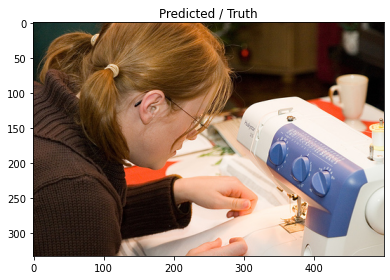

Prediction: 의 여성은 컴퓨터를보고 있습니다. 여자가 컴퓨터를보고 있습니다.[SEP]를하는 여자.[SEP]를하는 여자.[SEP]을보고있는 여자.[SEP]를보고있는[SEP][SEP].[SEP]를보고있는[SEP][SEP].[SEP][SEP][SEP][SEP][SEP].[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP]를하는[SEP].[SEP][SEP][SEP][SEP][SEP][SEP]를[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를[SEP].[SEP][SEP][SEP][SEP][SEP].[SEP]를[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]를[SEP]를[SEP].[SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]를[SEP]를[SEP]를[SEP]를하는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP]를[SEP][SEP][SEP]를[SEP]를[SEP]를[SEP]를하는[SEP][SEP][SEP][SEP]를[SEP][SEP][SEP][SEP].[SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]를하는[SEP]를[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]를[SEP]를[SEP]를[SEP]를[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]를[SEP]를[SEP].[SEP].[SEP]를하는[SEP]를

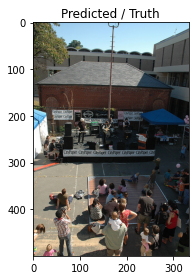

Prediction: 의 사람들은 교회에서 교회에서 춤을 추고 있습니다. 사람들은 교회에서 춤을 추고 있습니다. 사람들은 춤을 추고 있습니다.[SEP]는 춤을 추고 있습니다.[SEP]는 춤을 추고 있습니다.[SEP]는 춤을 추고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiii.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ss.[SEP]ssssssssssss.[SEP]sssssssssss의 그룹.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 연주 용기.[SEP]는 바이션.[SEP]tsssssssssss는 바이, 
Truth:  외부의 작은 군중 앞에서 연주하는 밴드. 도시 어린이를위한 오락. 밴드는 손님을 위해 외부에서 공연합니다. 주차장에서 콘서트.


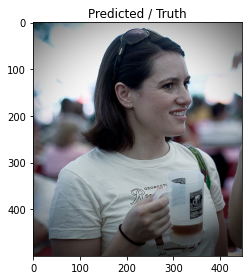

Prediction: 의 셔츠를 입은 소녀는 흰 셔츠를 입고 있습니다. 셔츠를 입은 소녀는 흰 셔츠를 입고 있습니다. 셔츠를 입은 소녀는 흰 셔츠를 입고 있습니다. 셔츠를 입은 소녀가 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 소녀가 셔츠를 입고 있습니다.[SEP]는[SEP]을[SEP]을[SEP]는[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 가진[SEP]를 가진[SEP]습니다.[SEP]습니다.[SEP][SEP]의 소녀[SEP]의 소녀[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP].[SEP]에[SEP][SEP][SEP][SEP][SEP][SEP]에[SEP][SEP][SEP]에[SEP]에[SEP][SEP][SEP][SEP]을 가진[SEP]을 가진[SEP]을 가진 소녀.[SEP]을 가진 소녀[SEP]을 가진[SEP][SEP] 있습니다.[SEP]의 소녀[SEP]에[SEP]을 가진[SEP]에[SEP]에[SEP]에[SEP]에[SEP]에[SEP]는 소녀.[SEP]는[SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP]을 가진[SEP]습니다.[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]습니다.[SEP][SEP][SEP][SEP]는 소녀[SEP]는 소녀[SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP].[SEP]을 가진[SEP]을 가진[SEP] 있습니다.[SEP].[SEP].[SEP]는 소녀.[SEP]는 소녀[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP].[SEP], 
Truth:  이 여자는 흰색 티셔츠를 입고 컵을 들고 있습니다. 음료를 들고 웃는 여자. 여자는 음료를 마시고 미소를지었습니다. 여자는 음료를 가지고 있습니다.


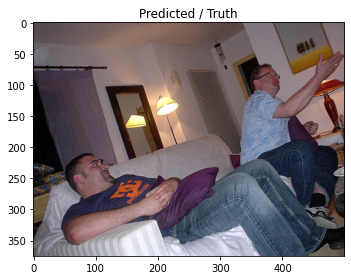

Prediction: 의자에 앉아있는 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다. 두 남자가 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 두 남자.[SEP] 의자에있는 두 남자.[SEP] 의자에있는 두 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]iiiiiiii.[SEP]의 남자.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ers.[SEP]ers.[SEP]의.[SEP]의.[SEP]의.[SEP]iiiiiiiiiiii[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의.[SEP][SEP][SEP][SEP]의.[SEP]의.[SEP]의.[SEP]의.[SEP].[SEP]의.[SEP]의.[SEP]의.[SEP]의.[SEP]에 앉아있는[SEP][SEP][SEP][SEP][SEP][SEP]의[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP][SEP][SEP]의 남자.[SEP]의[SEP]의.[SEP]의.[SEP]에 앉아 있습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP]의.[SEP]의.[SEP]의.[SEP]의.[SEP]에 앉아 있습니다.[SEP].[SEP][SEP].[SEP]는[SEP]에 있습니다.[SEP]스트[SEP][SEP][SEP].[SEP].[SEP]스트[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]이[SEP]iiiii, 
Truth:  청바지를 입은 두 남자가 흰 소파에 앉아 있습니다. 방에 소파에 앉아있는 두 남자. 두 남자가 흰 소파에 앉아 있습니다. 남자는 벽에 그림을 만지고 있습니다.


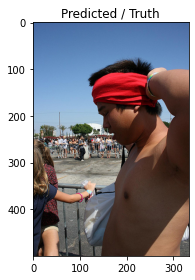

Prediction: 의 여성은 의자에 앉아 있습니다. 한 여성이 도시의 의자에 앉아 있습니다. 한 여성이 도시의 거리에 앉아 있습니다.[SEP]의 한 여성이 도시 거리에 앉아 있습니다.[SEP]의 한 여성이 도시의 의자에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]의 한 여성.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 한 여성.[SEP][SEP][SEP][SEP][SEP]의 한 여성이[SEP]을 위해 포즈를 취합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 한 여성.[SEP]의 한 여성.[SEP]의 한 여성이[SEP]의 한 여성이[SEP]의 한 여성이[SEP]에[SEP]의 한 여성이[SEP]에[SEP]에[SEP]에 앉아 있습니다.[SEP]를 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP][SEP]을 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다.[SEP]을[SEP]을[SEP][SEP][SEP][SEP]을[SEP]을[SEP]습니다.[SEP]습니다.[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]습니다.[SEP]을 위해 포즈를 취합니다.[SEP]을[SEP][SEP][SEP][SEP]습니다.[SEP]는 여자[SEP][SEP]을 위해 포즈를 취합니다.[SEP]을 위해 포즈를 취합니다[SEP]을, 
Truth:  한 남자는 셔츠가없는 동안 머리 위로 손을 대고있다. 빨간 수건을 가진 셔츠가없는 남자는 그의 머리 주위에 감싸고 있습니다. 나는 C

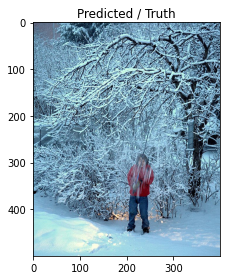

Prediction: 의 붉은 머리카락을 가진 여자는 눈을 덮고 있습니다. 붉은 머리의 여자는 눈을 덮인 산을 오르고 있습니다. 눈을 오르는 여자. 여자가 눈을 덮인 덮인 산을 오르고 있습니다.[SEP]을 오르는 여자.[SEP]을 오르는 여자[SEP]을 덮인합니다.[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP]을 덮인[SEP]을 덮인[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을 덮인[SEP][SEP]을 덮인[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 덮인[SEP]을 덮인[SEP]을 덮인 산을 덮인 산을 덮인[SEP] 있습니다.[SEP]을 덮인[SEP]을 덮인[SEP]을 덮인[SEP] 덮인[SEP]을 덮인[SEP]을 덮인[SEP]습니다.[SEP]습니다.[SEP]을 덮인[SEP]을 덮인[SEP]을 덮인[SEP]습니다.[SEP]을 덮인[SEP]는 여자.[SEP]을 입은 여자.[SEP]을 덮인[SEP]을 덮인[SEP]을 덮인[SEP]을 덮인 산을 덮인[SEP]을 덮인[SEP]을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산을 덮인 산, 
Truth:  빨간 재킷을 입은 소년은 막대기로 눈 덮인 나무를 때립니다. 빨간 재킷을 입은 사람은 눈 덮인 나무 아래에 서 있습니다. 아이는 눈 덮인 나무 아래에 서 있습니다. 어린 소년이 나무에서 눈을 흔들립니다.


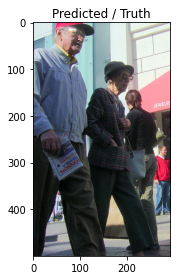

Prediction: 의 두 명의 여성이 서로를보고 있습니다. 두 명의 여성이 서로 이야기하고 있습니다. 두 명의 여성이 서로 이야기하고 있습니다.[SEP]는 서로 이야기하고 있습니다.[SEP]는 서로 이야기합니다.[SEP]의 두 명의 여성이 서로 이야기합니다[SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP]iiiii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주하는 두 명의[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]를합니다.[SEP]를 연주하는 두 명의[SEP].[SEP].[SEP]s.[SEP][SEP][SEP][SEP][SEP]에 서 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 서 있습니다.[SEP]를하는 두 남자.[SEP][SEP][SEP][SEP].[SEP]에 서 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 서 있습니다.[SEP]에 서 있습니다.[SEP]에 서있는[SEP]에 서있는 두 남자.[SEP]에 서있는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 남자.[SEP][SEP]를 연주하는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP]s.[SEP]를 연주하는 두 남자.[SEP]에 서있는 두 남자.[SEP][SEP]에 서있는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP]에 서있는 두 남자.[SEP]에 서있는 두 남자.[SEP]에 서 있습니다.[SEP]에 서있는, 
Truth:  나이

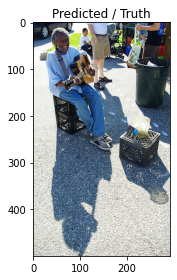

Prediction: 의 붉은 머리카락을 가진 여성은 붉은 색의자에 앉아 있습니다. 한 여성은 붉은 붉은 색의자에 앉아 있습니다. 한 여성은 붉은 색의자에 앉아 있습니다. 한 여성이 붉은 붉은 색의자에 앉아 있습니다.[SEP] 붉은 색의자에 앉아있는 여자는 붉은 붉은 붉은 색의자에 앉아 있습니다.[SEP] 붉은 붉은 색의자에 앉아 있습니다.[SEP] 붉은 색의자에 앉아 있습니다.[SEP]를 입은 여자는 붉은 붉은 붉은 붉은 붉은 붉은 붉은 붉은 색의자에 앉아 있습니다.[SEP] 색의자에 앉아 있습니다.[SEP] 붉은 붉은 색의자에 앉아있는 여자는 붉은 붉은 붉은 색의자에 앉아 있습니다.[SEP]를 입은 여자는 색의자에 앉아 있습니다.[SEP]를 입은 여자는 붉은 붉은 붉은 붉은 붉은 붉은 붉은 붉은 붉은 붉은 색의자에 앉아 있습니다.[SEP]를 입은 여자는 붉은 붉은 붉은 붉은 붉은 붉은 색의자에 앉아 있습니다.[SEP]를 입고 있습니다.[SEP]을, 
Truth:  청바지와 파란색 셔츠를 입은 웃는 사람이 다른 여러 사람들 앞에서 기타를 연주합니다. 하루 동안 끈 기타를 연주하는 두 개의 식료품 상자에 앉아있는 늙은 흑인. 나이가 많은 신사는 화창한 날에 거리에서 기타를 밟는 동안 미소를 짓습니다. 기타를 연주하고 웃는 사람.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 13 summary:
Train loss: 2.0774, validation loss: 2.4960
Train accuracy: 0.3932, validation accuracy: 0.3579
Time per 13 epoch: 126.0 minutes
14/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

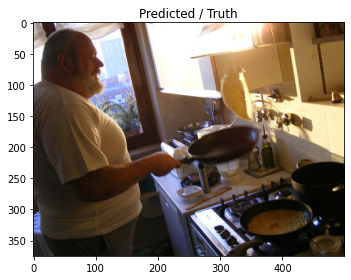

Prediction: 의 요리사가 음식을 준비하는 요리사. 요리사가 음식을 준비하는 요리사. 요리사가 음식을 준비하는 요리사. 요리사가 음식을 준비하는 요리사.[SEP]는 요리사로에서 음식을 요리합니다.[SEP]는 요리합니다[SEP][SEP]를 준비합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ii를합니다.[SEP] 요리를 요리합니다[SEP]는 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP][SEP][SEP][SEP][SEP]iii를 요리합니다.[SEP]를 요리합니다[SEP][SEP]를 요리합니다[SEP]는 요리합니다[SEP]를 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다[SEP]를 요리합니다[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 요리합니다.[SEP] 요리합니다[SEP][SEP][SEP] 있습니다.[SEP] 요리합니다[SEP]를 요리합니다[SEP]를 요리합니다[SEP]를 요리합니다[SEP]를 요리합니다[SEP]는 요리합니다[SEP]는 요리합니다[SEP]는 요리합니다[SEP]는 요리합니다[SEP]습니다.[SEP]를 요리합니다.[SEP]습니다.[SEP]는 요리합니다[SEP]는 요리합니다[SEP]는 요리합니다[SEP]는 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP]는 요리합니다.[SEP]를 요리를 요리를 요리를 요리를 요리합니다[SEP][SEP][SEP][SEP]를 요리합니다.[SEP] 있습니다.[SEP]를 요리합니다[SEP][SEP] 요리합니다[SEP] 요리를 요리를 요리합니다[SEP] 요리합니다[SEP]를 요리합니다[SEP]iiiii, 
Truth:  나이가 많은 과체중 남자는 아침을 만드는 동안 팬케이크를 뒤집

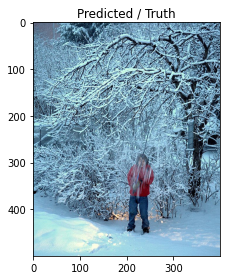

Prediction: 의 붉은 머리카락과 붉은 머리를 가진 여자는 눈을 감고 있습니다. 한 여성이 눈을 감고 눈을 감고 있습니다. 한 여성이 눈을 감고 눈을 감고 있습니다. 여자는 눈을 감고 있습니다.[SEP]을 감고있는 여자.[SEP]을 덮인 산을 오르는 여자.[SEP]을 가진[SEP]는 여자.[SEP]을 덮인[SEP]을 가진[SEP]을 스키.[SEP]는[SEP]는[SEP]을[SEP][SEP]는[SEP]을[SEP]습니다.[SEP]는[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을 입고 있습니다.[SEP]을 입고 있습니다.[SEP]을 입고 있습니다.[SEP]ssss.[SEP][SEP]을 입고 있습니다.[SEP][SEP][SEP][SEP][SEP]에[SEP]에[SEP][SEP]을 입고 있습니다.[SEP]을 입은 여자.[SEP]는 여자.[SEP]을 입은 여자.[SEP]sssssssssssssss.[SEP]ssssssss.[SEP]s.[SEP]을 입은 여자.[SEP]을 가진[SEP]을 가진[SEP]을 입은 여자.[SEP]을 가진[SEP]을[SEP]을[SEP]을 입고 있습니다.[SEP]을[SEP]을[SEP]을[SEP]을 가진[SEP]을 가진 여자.[SEP]s.[SEP]을 입고 있습니다.[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP], 
Truth:  빨간 재킷을 입은 소년은 막대기로 눈 덮인 나무를 때립니다. 빨간 재킷을 입은 사람은 눈 덮인 나무 아래에 서 있습니다. 아이는 눈 덮인 나무 아래에 서 있습니다. 어린 소년이 나무에서 눈을 흔들립니다.


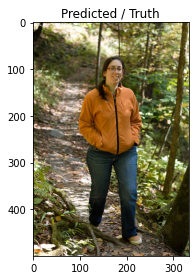

Prediction: 의 나무가 우거진 지역에서 나무를 들고있는 남자. 나무가 우거진 지역에서 나무를 들고있는 남자. 나무가 우거진 지역에서 나무를 들고있는 남자. 나무에 서있는 남자.[SEP] 나무에 서있는 남자.[SEP]에있는 남자가 나무에 서 있습니다.[SEP]는[SEP]에 서 있습니다.[SEP]는[SEP]에 서 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ss.[SEP]ssssssssssssssssss.[SEP]ssss.[SEP]s.[SEP]ss.[SEP]sssss의[SEP]s의[SEP]sss.[SEP]ssssssssssssssssss에 서 있습니다.[SEP]s에 서 있습니다.[SEP]ssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss습니다.[SEP]tsssssssssssssssssssssss, 
Truth:  오렌지 코트를 입은 여자와 푸른 청바지가 숲에서 좁은 길을 걷고 있습니다. 안경을 쓴 여자와 광야 트레일을 따라 걷는 오렌지 재킷. 안경과 주황색 재킷을 곁들인 뚱뚱한 괴상한 숲을 통과합니다. 오렌지 재킷과 청바지를 입은 여자가 트레일을 걷는다.


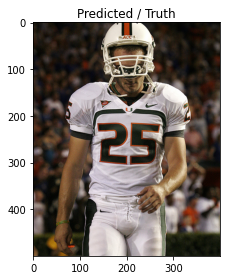

Prediction: 의 레드 셔츠를 입은 남자는 흰색 셔츠와 흰색 반바지에 있습니다. 흰색 셔츠를 입은 남자가 흰색 셔츠를 입고 있습니다. 흰색 셔츠를 입은 남자가 흰색 셔츠를 입고 있습니다. 흰 셔츠를 입은 남자가 흰 셔츠를 입고 있습니다.[SEP] 셔츠를 입은 남자가 흰 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP] 흰 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP]를 입은 남자가 흰 셔츠를 입은 남자가 셔츠를 입은 남자가게됩니다.[SEP]를 입은 남자가 흰 셔츠를 입고 있습니다.[SEP]을 위해 셔츠를 입고 있습니다.[SEP]를 입은 남자가 셔츠를 입고 있습니다.[SEP]를 입은 남자가 흰 셔츠를 입은 남자가게합니다[SEP]습니다.[SEP]습니다.[SEP]를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP]을 위해 셔츠를 입은 남자가 셔츠를 입고 있습니다.[SEP]을 위해 흰 흰 셔츠를 입고 있습니다.[SEP]을 위해 흰 셔츠를 입은 남자가 흰 셔츠를 입고 있습니다.[SEP], 
Truth:  흰색 유니폼을 입은 축구 선수가 산책하고 내려다 본다. 마이애미 대학교 축구 선수, 25. 축구 선수는 25 번을 가지고 있습니다. 축구 선수의 근접 촬영, 25.


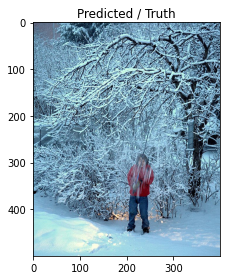

Prediction: 의 눈 덮인 산을 오르는 두 명의 여성. 두 명의 여성이 눈 덮인 산을 오르고 있습니다. 두 명의 여성이 눈 덮인 산을 오르고 있습니다. 두 명의 여성이 눈 덮인 산을 오르고 있습니다.[SEP] 덮인 산을 오르는 두 명의 여성.[SEP]을 오르는 두 명의 여성.[SEP]을 즐기는 두 명의 여성.[SEP]을합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]을합니다.[SEP]을합니다.[SEP]을합니다.[SEP]을합니다[SEP]sssss.[SEP]을[SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 소녀[SEP]s.[SEP]sssssssssssssssssssssssssssssssssssssssss.[SEP]s.[SEP]s.[SEP]s.[SEP]sss.[SEP]sssss.[SEP]tsssssssss.[SEP]를하는 두 명의[SEP]ssssssssssssssssssssss, 
Truth:  빨간 재킷을 입은 소년은 막대기로 눈 덮인 나무를 때립니다. 빨간 재킷을 입은 사람은 눈 덮인 나무 아래에 서 있습니다. 아이는 눈 덮인 나무 아래에 서 있습니다. 어린 소년이 나무에서 눈을 흔들립니다.


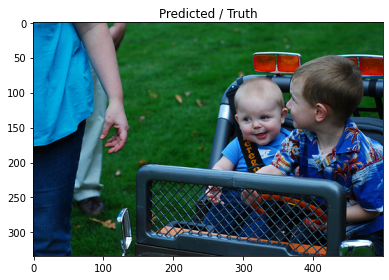

Prediction: 의 유아가 공원에서 놀고 있습니다. 어린 소년이 공원에서 놀고 있습니다. 공원에서 놀고있는 어린 소년.[SEP]는 공원에서 놀고있는 아이.[SEP]는 공원에서 놀고 있습니다.[SEP]는 아이[SEP]를합니다[SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]를하는 아이[SEP][SEP][SEP][SEP]를 즐기는 아이[SEP][SEP]습니다.[SEP]는[SEP]를 즐기는[SEP][SEP][SEP]를합니다[SEP]를합니다.[SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP]를합니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP][SEP][SEP]를 즐기는 아이[SEP]를합니다[SEP]를합니다[SEP]를합니다[SEP]를 즐기는 아이[SEP]를 즐기는 아이[SEP]는 아이[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP]는 아이[SEP]는 아이[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는 아이[SEP]를 즐기는 아이[SEP]를 즐기는[SEP][SEP][SEP][SEP]를 즐기는 아이[SEP][SEP]를 즐기는 아이[SEP][SEP][SEP][SEP]를 즐기는 아이[SEP]를 즐기는 아이[SEP]를 즐기는 아이[SEP]를 즐기는[SEP][SEP][SEP], 
Truth:  어린 아이의 장난감 차량

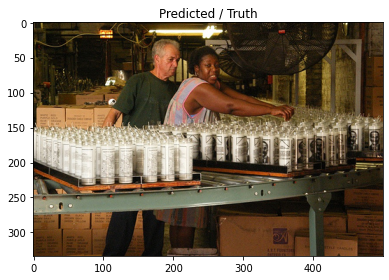

Prediction: 의 여성은 금속 의자에 앉아 있습니다. 여자는 의자에 앉아있는 동안 의자에 앉아 있습니다. 여자는 의자에 앉아있는 동안 앉은 여자는 앉은 여자가 앉은 여자를 봅니다.[SEP] 프레비큐에 앉아있는 여자.[SEP]는 프레젠테이션을하고 있습니다.[SEP]는 여자.[SEP]을하고 있습니다.[SEP]는[SEP]을[SEP]는[SEP]는[SEP]를합니다.[SEP]는[SEP]는[SEP]을[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP]는[SEP]는[SEP]를 뜨개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]을 만들고 있습니다.[SEP]을[SEP][SEP][SEP][SEP]듭니다.[SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP]는 여자[SEP]는 여자[SEP]는 여자[SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]를 뜨개질에 앉아 있습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]습니다.[SEP]는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP][SEP][SEP]습니다.[SEP]을[SEP]습니다.[SEP]습니다.[SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP]을 만들고 있습니다.[SEP][SEP]을[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]를 위해 뜨리넷을 만들고 있습니다.[SEP]을 위해 뜨리넷을, 
Truth:  흑인 여성과 백인 남자는 촛불을 상자에 넣은 항아리를 포장하는 공장에서 일하는 백인. 여자는 녹색 셔츠를 입은 남자가 그녀의 뒤에 서서 하얀 키 큰 양초를 분류하고 있습니다

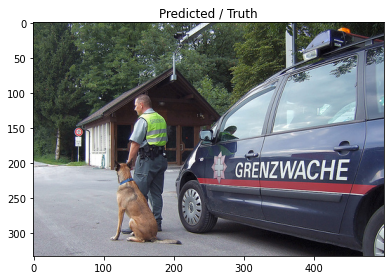

Prediction: 의 남자는 밴 옆에있는 트럭과 함께 트럭을 운전하고 있습니다. 트럭과 함께 트럭을 운전하는 남자. 트럭과 함께 트럭을 운전하는 남자. 트럭과 트럭을 운전하는 남자.[SEP] 트럭을 운전하는 남자.[SEP] 트럭.[SEP] 트럭을 운전하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ssss.[SEP]heeeeeeeeeeeeeeeeeeeeeeeee를하는 남자.[SEP]an.[SEP]sssssssssssssssssssssssssssssssss에있는 남자.[SEP]hn.[SEP]를 입고있는 남자.[SEP]hn.[SEP]ssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  훈련 된 경찰견은 경찰 밴 앞의 핸들러 옆에 앉아 있습니다. 그의 시계 개를 가진 보안 담당자가 무언가를 찾고 있습니다. 경찰관은 독일 셰퍼드 개와 함께 서 있습니다. 경찰관이 수색견과 함께 거리에서 멈 춥니 다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 14 summary:
Train loss: 2.0120, validation loss: 2.4921
Train accuracy: 0.4011, validation accuracy: 0.3575
Time per 14 epoch: 134.0 minutes
Prediction after 14 epoch.


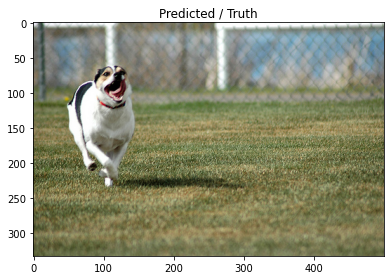

Prediction: 의 개가 들판에서 달리고 있습니다. 필드에서 달리는 개. 개가 들판에서 달린다.[SEP]를 통과하는 개.[SEP]를 통과하는 개.[SEP]이버는 들판에서 달린다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]이버.[SEP]를 위해 달려갑니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 달려갑니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]이버.[SEP]이버.[SEP][SEP][SEP][SEP]이버.[SEP]이버.[SEP]이버.[SEP][SEP][SEP]를 위해 달린다.[SEP]는 들판에서 달린다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 달린다.[SEP]습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]를 위해 달려갑니다.[SEP]이버.[SEP]이버.[SEP]이버.[SEP][SEP][SEP]이버.[SEP][SEP][SEP]이버.[SEP]를 위해 달려갑니다.[

  0%|          | 0/891 [00:00<?, ?it/s]

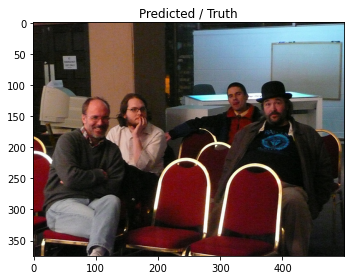

Prediction: 의 의자에 앉아있는 사람들의 그룹. 한 무리의 사람들이 의자에 앉아 있습니다. 한 무리의 사람들이 의자에 앉아 있습니다. 한 무리의 사람들이 의자에 앉아 있습니다.[SEP]에 앉아있는 사람들.[SEP]이 의자에 앉아 있습니다.[SEP]는[SEP]iiiiiie.[SEP]는[SEP]iiiiiiii를합니다[SEP]는[SEP]는[SEP]를합니다[SEP]를합니다[SEP]는[SEP]를합니다[SEP]를합니다[SEP]는[SEP]는 남자[SEP]습니다.[SEP]는 남자.[SEP]습니다.[SEP]는 남자[SEP]는 의 그룹[SEP]를합니다[SEP]를합니다[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]는 남자[SEP]를합니다[SEP]를합니다[SEP]를합니다[SEP]는 남자[SEP]는 남자.[SEP]는 남자.[SEP]이션[SEP]에 앉아 있습니다.[SEP] 있습니다.[SEP]오.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]를 즐기는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]를 즐기는 남자.[SEP]습니다.[SEP]를 즐기는 남자[SEP]습니다.[SEP]습니다.[SEP]는 남자[SEP]는 남자[SEP] 있습니다.[SEP][SEP][SEP]n.[SEP]ert[SEP]는 남자.[SEP]ert[SEP]를 연주를 연주를 연주를 연주합니다[SEP]스트[SEP]n.[SEP] 있습니다.[SEP] 있습니다.[SEP]를 연주합니다[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]를 연주합니다[SEP]이는 남자.[SEP]이, 
Truth:  사진을 위해 포즈를 취하는 4 명의 괴상한. 빨간 의자에 앉아있는 남자 그룹. 의자에 앉아 4 명의 행복한 사람들. 4 명의 남자가 빨간 의자에 앉아 있습니다.


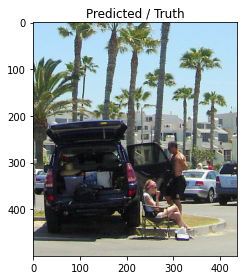

Prediction: 의 한 여성이 도시 거리에서 무릎을 꿇고 있습니다. 한 여성이 도시 거리에서 무릎을 꿇고 있습니다. 한 여성이 보도에서 무릎을 꿇고 있습니다. 한 여성이 보도에서 무릎을 꿇고 있습니다.[SEP]을 가진 여자가 차를 들고 있습니다.[SEP]는 차를 들고 있습니다.[SEP]는[SEP]를 들고 있습니다.[SEP][SEP][SEP]를 기다리는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다.[SEP]습니다.[SEP]습니다.[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP][SEP]를 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다[SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다.[SEP]는 남자.[SEP]는 남자.[SEP]습니다.[SEP]는 남자.[SEP]습니다.[SEP]습니다.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP][SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다[SEP]는 남자.[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]를 위해 포즈를 취합니다[SEP]는 남자., 
Truth:  접이식 의자에있는 여성은 한 남자가 연석에 주차 된 차 문 안으로 쳐다 보는 동안 먹는다. 남자가

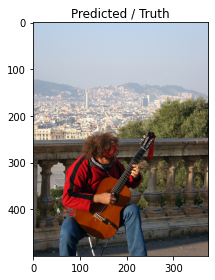

Prediction: 의 바이올린을 연주하는 셔츠를 입은 남자. 바이올린을 연주하는 바이올린을 연주하는 남자. 바이올린을 연주하는 남자. 바이올린을 연주하는 남자.[SEP]을 연주하는 바이올린을 연주.[SEP]는 바이올린을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 기타를 연주합니다.[SEP] 기타를 연주합니다.[SEP] 기타를 연주합니다.[SEP] 기타를 연주합니다.[SEP] 기타를 연주합니다.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 기타를 연주하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP]ers.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자.[SEP] 기타를 연주하는 남자[SEP] 기타를 연주하는 남자[SEP] 기타, 
Truth:  한 남자가 도시의 전망을 그의 배경으로 기타를 연주하고 앉아 있습니다. 도시를 간과하면서 영감 때문에 기타를 집어 들었습니다. 빨간색과 검은 색 셔츠를 입은 남자가 도시 앞에서 기타를 연주하고 있습니다. 그의 기타를 연주하는 히피.


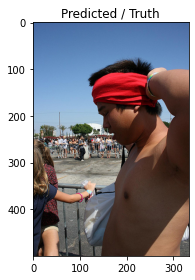

Prediction: 의 여성은 도시의 거리에 서 있습니다. 한 여성이 도시의 거리에 서 있습니다. 한 여성이 도시의 거리에 서 있습니다.[SEP]에 서있는 여자.[SEP]는 도시의 거리에 서 있습니다.[SEP]에있는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에 있습니다.[SEP]에[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는[SEP][SEP][SEP][SEP].[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는[SEP].[SEP]에있는[SEP].[SEP]의 여성.[SEP]의 한 여성.[SEP]에있는[SEP]에있는[SEP]에[SEP]에[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는[SEP]에있는[SEP]에있는[SEP][SEP][SEP][SEP].[SEP].[SEP]에있는 여자.[SEP]에있는 여자.[SEP][SEP][SEP][SEP][SEP]에있는[SEP]에있는[SEP]에있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP]에있는 여자.[SEP][SEP][SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는 여자.[SEP][SEP][SEP]에있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP].[SEP].[SEP]에있는 여자.[SEP]에있는[SEP]에있는[SEP]에있는[SEP][SEP][SEP]에있는[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 모자에있는 여자.[SEP]에

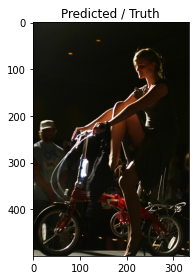

Prediction: 의 밴드는 밴드와 함께 연주합니다. 밴드는 밴드에서 연주합니다. 밴드는 밴드와 함께 연주합니다. 밴드는 밴드에서 연주합니다.[SEP] 밴드가 무대에서 연주합니다[SEP]을 연주합니다.[SEP] 밴드[SEP]을[SEP]는 밴드[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주합니다.[SEP]을 연주하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]을[SEP].[SEP][SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]을[SEP][SEP][SEP]는 남자.[SEP]는 남자.[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을 위해 공연합니다.[SEP]을[SEP]을 위해 공연합니다.[SEP]을[SEP][SEP][SEP][SEP]을[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]는 밴드.[SEP]을 위해 공연합니다.[SEP]는 밴드.[SEP]을 위해 노래.[SEP]을[SEP]을[SEP]을[SEP][SEP]을[SEP]을[SEP]을[SEP]는 밴드.[SEP]을[SEP]을[SEP]는 밴드.[SEP]을 연주.[SEP]을 연주하는 밴드.[SEP]을[SEP]을 위해 공연.[SEP]을 위해 노래.[SEP]을 위해 노래.[SEP]을 위해 노래.[SEP]을 위해 노래[SEP]을 연, 
Truth:  검은 드레스와 하이힐을 가진 여성이 자전거를 타고 있습니다. 하이힐을 가진 여성은 작은 바퀴로 자전거를 타고 있습니다. 미니 자전거를 타는 젊은 여성. 작은 자전거 위에있는 여자.


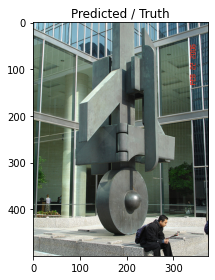

Prediction: 의 연단에 서있는 두 남자가 연못의 연단에 서 있습니다. 두 남자가 연단에 서서 연주하고 있습니다. 두 남자가 연못 옆에 서 있습니다. 두 남자가 연석에 서 있습니다.[SEP]을하는 두 남자.[SEP]을 연주하는 두 남자[SEP]을[SEP]습니다.[SEP]는 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을합니다[SEP]을[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]습니다.[SEP]을[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]는[SEP][SEP]을[SEP]을[SEP]을[SEP]을[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP]는[SEP]습니다.[SEP]을 연주합니다.[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP][SEP][SEP]는 연주합니다.[SEP]는[SEP]는[SEP]는[SEP][SEP][SEP][SEP]을 연주합니다[SEP]습니다.[SEP]을 연주합니다[SEP]습니다.[SEP]을 연주합니다.[SEP]을 연주합니다[SEP]는[SEP]을 연주합니다[SEP][SEP]을 연주합니다.[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP][SEP][SEP][SEP]을 연주합니다.[SEP][SEP]을 연주합니다[SEP]을 연주합니다.[SEP]을 연주, 
Truth:  검은 색의 남자는 유리 건물 앞 현대 미술 구조 옆에 앉아 있습니다. 한 남자는 사무실 건물 외부의 조각품으로 신문을 읽고 읽습니다. 건물 앞에 금속 조각 앞에 앉아있는 남자. 남자는 큰 동상 근처에 앉아 있습니다.


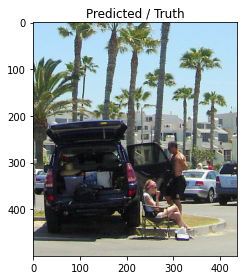

Prediction: 의 한 남자가 밴 앞에서 무릎을 꿇고 다른 남자가 밴조를하고 있습니다. 한 남자가 밴 옆에 무릎을 꿇고 다른 남자가 그를 들고있는 동안 다른 남자가 그를 들고있는 동안 다른 남자가 그를보고있는 동안 다른 남자가 그를보고있는 동안 다른 남자가 그를 보는 동안 남자가 밴조를 보면서 다른 남자가 그를 보면서 다른 남자가 그를 보는 동안 다른 남자가 그를 보는 동안 다른 남자가 그를 보는 동안 다른 남자가 그를 보는 동안 다른 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그를 보는 동안 남자가 그, 
Truth:  접이식 의자에있는 여성은 한 남자가 연석에 주차 된 차 문 안으로 쳐다 보는 동안 먹는다. 남자가 스포츠 유틸리티 차량을 겪고있는 동안 여자가 의자에 앉아 있습니다. 주차 된 차 밖에서 접는 의자에 앉아있는 젊은 아가씨. 남자와 여자는 품목으로 가득 찬 차 밖에 있습니다.


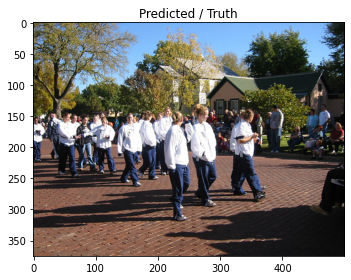

Prediction: 의 그룹은 흰색 드레스를 입은 그룹이 거리에서 걷고 있습니다. 흰색 드레스를 입은 그룹이 보도를 걷고 있습니다. 흰색 드레스를 입은 그룹은 흰색 드레스를 입은 그룹이 보도를 걷고 있습니다. 흰색 드레스를 입은 그룹이 보도를 걷고 있습니다.[SEP] 그룹은 길을 걷고 있습니다.[SEP] 팀[SEP]를 걷는 그룹[SEP] 그룹[SEP]를 걷는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP] 팀[SEP]를 입고 있습니다.[SEP] 그룹[SEP] 팀[SEP] 팀[SEP] 팀[SEP] 팀[SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 그룹[SEP]는 그룹[SEP]는 그룹[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP]s의 그룹[SEP]sssss[SEP]s[SEP]s[SEP]sssssssssssss.[SEP]s.[SEP]s.[SEP]s의 그룹[SEP]s의 그룹[SEP]s의 그룹[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]itch[SEP]ssssssssssssssssssssssss, 
Truth:  한 무리의 사람들이 퍼레이드로 길을 걸어가는 것과 같은 옷을 입었습니다. 흰색 재킷에있는 사람들이 마을 거리에서 걷고 있습니다. 흰 셔츠를 입은 많은 아이들이 동네를 걷고 있습니다. 벽돌 도로를 걷는 흰색 칼라 셔츠의 아이들.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 15 summary:
Train loss: 1.9512, validation loss: 2.4884
Train accuracy: 0.4065, validation accuracy: 0.3597
Time per 15 epoch: 142.0 minutes


  0%|          | 0/100 [00:00<?, ?it/s]

test_bleu1: 0.0212 test_bleu4: 0.0053 
16/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

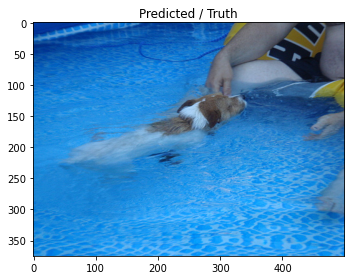

Prediction: 의 개가 수영장에서 수영을하고 있습니다. 수영장에서 수영하는 개. 수영장에서 수영하는 개.[SEP]이 수영장에서 수영을하고 있습니다.[SEP]는 수영장에서 수영을합니다.[SEP]이 수영장에서 수영합니다.[SEP]이 수영장에서 수영합니다.[SEP]이 수영합니다.[SEP]이 수영합니다[SEP]이 수영합니다.[SEP]이 수영합니다[SEP] 수영합니다.[SEP] 수영장에서 수영합니다.[SEP]이버.[SEP]이버[SEP]이버[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]이버[SEP]습니다.[SEP]습니다.[SEP]er.[SEP]이버[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]이버[SEP]이버[SEP]습니다.[SEP]습니다.[SEP]이버[SEP]이버[SEP]이버[SEP]이버[SEP]이버[SEP]습니다.[SEP]습니다.[SEP]이버[SEP]습니다.[SEP]이버[SEP]습니다.[SEP]이버[SEP]습니다.[SEP]이버[SEP]이버[SEP]이버[SEP]이버[SEP]이버[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]이버는 수영합니다[SEP]습니다.[SEP]습니다.[SEP]이버는 수영합니다[SEP]이버는 수영합니다[SEP]이버[SEP]이버[SEP]이버[SEP]이버[SEP]이버[SEP]이버는 수영합니다[SEP]이버는 수영합니다.[SEP]이버[SEP]이버[SEP]이버는 수영합니다.[SEP]습니다.[SEP], 
Truth:  수영장에서 일부를 향해 수영하는 갈색과 흰 개 작은 개는 수영장의 물을 통해 얕은 것입니다. 작은 갈색과 흰 개가 수영장에 있습니다. 개가 사람 근처의 수영장에서 수영합니다.


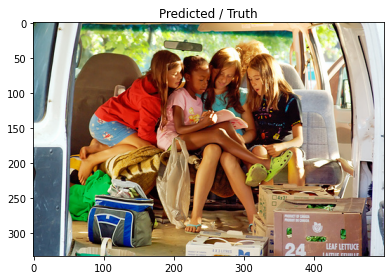

Prediction: 의 여성은 앉아서 앉아서 음료를 마시고 있습니다. 음료를 마시는 음료를 마시는 여성. 음료를 마시는 음료를 마시는 여자. 술집에 앉아있는 여자.[SEP]판에 앉아있는 여자.[SEP]운지에 앉아있는 여자.[SEP]목에 앉아있는 사람들.[SEP]iiiiiiiiiiiiii.[SEP]는[SEP]를 즐기는[SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiiiiii를합니다.[SEP]는[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는[SEP]는[SEP].[SEP]s.[SEP]는[SEP].[SEP].[SEP]의 그룹.[SEP]의 그룹.[SEP]iiiiiiii를 즐기는[SEP]를 즐기는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]는[SEP]습니다.[SEP]습니다.[SEP]를 즐기는[SEP]습니다.[SEP]s.[SEP]는[SEP]는[SEP]s.[SEP]s의 그룹.[SEP]s의 그룹.[SEP]s의 그룹.[SEP]ie의 그룹.[SEP]n.[SEP]s의 그룹.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]스트는[SEP]는[SEP]s의 그룹.[SEP]sssssssssssssss의 그룹., 
Truth:  4 명의 어린 소녀들이 농산물 상자와 함께 차 뒤에 책을 읽는 책을 읽습니다. 책을보고 함께 밴 뒤에 앉아있는 아이들의 그룹. 몇몇 어린 소녀들이 미니 밴에 앉아 있습니다. 어린 소녀 그룹이 책을 들여다 보았습니다.


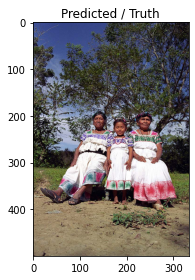

Prediction: 의 나무에 앉아있는 두 명의 여성이 나무와인을 가지고 있습니다. 두 명의 여성이 나무로 둘러싸인 길을 따라 나무를 들고 있습니다. 두 명의 여성이 나무로 둘러싸인 길을 따라 나무를 들고 있습니다. 두 명의 여성이 나무로 둘러싸인 길을 따라 나무를 들고 있습니다.[SEP]는 나무로 둘러싸인 길을 따라 나무를 걷는 두 명의 여성.[SEP]는 두 명의 여성.[SEP]는 두 명의 여성.[SEP]nssssssssssssssssssssssss와 함께 나무를 들고 있습니다.[SEP]n.[SEP]nnnnn.[SEP]nsssssssssssssssssssssss와 함께 나무를 들고 있습니다.[SEP]n.[SEP]n.[SEP]ns와 함께 나무를 들고있는 두 명의 여성.[SEP]nnsss를 들고있는 두 명의 여성.[SEP]nssssssssssssssssssss와 함께 나무를 들고있는 두 명의 여성.[SEP]nnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnnn, 
Truth:  세 명의 여성, 모두 같은 유형의 흰색이지만 화려한 드레스를 입고 앉아서 빛나는 것처럼 보입니다. 나무 앞에서 먼지가 많은 청소에 앉아 흰색 드레스를 입은 다른 연령대의 세 여성. 두 명의 여자와 한 여자가 야외에서 사진을 찍기 위해 옷을 입었습니다. 두 명의 나이 많은 여성과 소녀가 백그라운드에서 숲과 함께 앉아 있습니다.


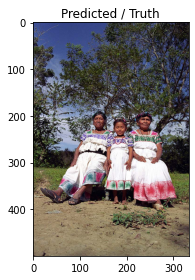

Prediction: 의 두 명의 여성이 나무가 늘어선 나무로 둘러싸인 길을 따라 앉아 있습니다. 두 명의 여성이 나무가 늘어선 길을 따라 앉아 있습니다. 두 명의 여성이 나무로 둘러싸인 길을 따라 앉아 있습니다. 두 명의 여성이 나무가 우거진 지역에 앉아 있습니다.[SEP]는 두 명의 여성이 우거진 지역에 앉아 있습니다.[SEP]을 즐기는 두 명의 여성.[SEP]을 즐기는[SEP]는[SEP]습니다.[SEP]는[SEP][SEP][SEP]을합니다[SEP]을합니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP]을합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을합니다.[SEP]n.[SEP]n.[SEP][SEP]n.[SEP]n.[SEP]n.[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 두 명의[SEP]n.[SEP]n.[SEP]는[SEP]는[SEP][SEP]는[SEP]n.[SEP]n.[SEP]를하는[SEP]를하는[SEP]n.[SEP]는[SEP]n.[SEP]n.[SEP]는[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP], 
Truth:  세 명의 여성, 모두 같은 유형의 흰색이지만 화려한 드레스를 입고 앉아서 빛나는 것처럼 보입니다. 나무 앞에서 먼지가 많은 청소에 앉아 흰색 드레스를 입은 다른 연령대의 세 여성. 두 명의 여자와 한 여자가 야외에서 사진을 찍기 위해 옷을 입었습니다. 

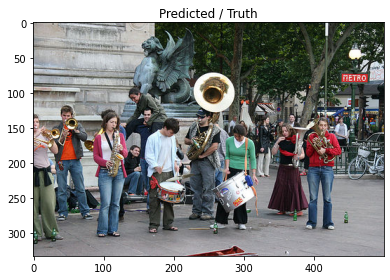

Prediction: 의 밴드는 밴드와 함께 연주합니다. 밴드는 밴드와 함께 연주합니다. 밴드는 밴드와 함께 연주합니다. 밴드는 밴드와 함께 연주합니다.[SEP] 밴드는 밴드에서 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 연주합니다.[SEP] 밴드가 연주하고 있습니다[SEP] 밴드[SEP]을[SEP]을[SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을[SEP]을[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]을 위해 공연합니다[SEP]는[SEP]을[SEP]을[SEP]을[SEP]을[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP]을 위해 공연합니다[SEP]습니다.[SEP]는[SEP]는[SEP]을[SEP]을 위해 공연합니다.[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는 밴드[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]는[SEP]는 밴드.[SEP]는 밴드[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연하는[SEP]습니다.[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다[SEP]을 위해 공연합니다, 
Truth:  남자와 여자의 밴드가 거리에서 음악을 연주하고 있습니다. 한 무리의 사람들이 악기를 연주하고 있습니다. 밴드는이 도시에서 음악을 연주하고 있습니다. 군중을 즐겁게하는 밴드.


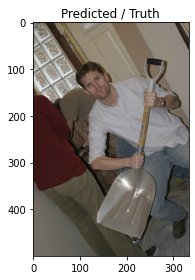

Prediction: 의 흰 셔츠를 입은 남자가 의자에 앉아 있습니다. 흰 셔츠를 입은 남자가 의자에 앉아 있습니다. 의자에 앉아있는 남자. 흰 셔츠를 입은 남자가 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 남자[SEP] 의자에 앉아있는 남자.[SEP]는 의자에 앉아 있습니다.[SEP]는[SEP]습니다.[SEP]을[SEP]습니다.[SEP]는[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP][SEP][SEP]습니다.[SEP]iiii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP]을합니다.[SEP]을[SEP].[SEP] 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP]i.[SEP][SEP]는[SEP]는[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]iiiiii.[SEP]습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을[SEP]을[SEP]습니다.[SEP]을[SEP]습니다.[SEP]습니다.[SEP]을[SEP]을[SEP]을[SEP][SEP][SEP].[SEP]습니다.[SEP]을[SEP] 있습니다.[SEP]을[SEP].[SEP].[SEP]습니다.[SEP]스트[SEP]스트[SEP]을[SEP]을[SEP]을[SEP]을[SEP]는[SEP].[SEP]을, 
Truth:  흰색 티셔츠를 입은 남자가 스노우 삽을 들고 있습니다. 스노우 삽을 들고 흰 셔츠를 입은 남자. 한 남자가 무기처럼 삽을 들고 있습니다. 이 사

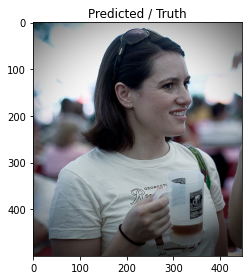

Prediction: 의 흰 셔츠를 입은 금발 머리를 가진 남자가 흰 셔츠를 입고 있습니다. 금발 머리를 가진 남자가 흰 셔츠를 입고 금발 머리를 셔츠를 입고 있습니다. 금발의 남자가 축구를하고 있습니다. 축구를하는 남자.[SEP] 셔츠가 축구를 입은 남자.[SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]를 셔.[SEP]의.[SEP]의 남자.[SEP]의.[SEP]을 셔츠.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 남자.[SEP]을 셔츠.[SEP]을 셔츠.[SEP][SEP][SEP][SEP]을 셔츠.[SEP]을 셔츠.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 축구를 셔츠.[SEP]는 축구를 셔츠.[SEP]는 축구를 가진 남자.[SEP]을 셔츠를 셔츠.[SEP]는 축구를 셔츠.[SEP]는 축구를 셔츠.[SEP][SEP]을 셔츠를 셔츠를 입은 남자.[SEP]을 셔츠.[SEP]을 셔츠.[SEP]을 셔츠[SEP]을 셔츠.[SEP]을 위해 셔츠.[SEP]을 셔츠.[SEP]을 셔츠를 입고 있습니다.[SEP]을, 
Truth:  이 여자는 흰색 티셔츠를 입고 컵을 들고 있습니다. 음료를 들고 웃는 여자. 여자는 음료를 마시고 미소를지었습니다. 여자는 음료를 가지고 있습니다.


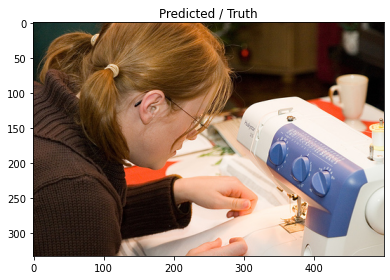

Prediction: 의 여성이 그녀의 손에 음료를 마시고 있습니다. 그녀의 손에 음료를 마시는 여자. 음료를 마시는 여자. 음료를 마시는 여자.[SEP] 컵에서 음료를 마시는 여자.[SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP]를 마시는[SEP]를 마시고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를[SEP]를[SEP]는[SEP]고 있습니다.[SEP]를[SEP]를 즐기는[SEP]습니다.[SEP]습니다.[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 여자.[SEP][SEP][SEP][SEP][SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP]를 즐기는 여자.[SEP][SEP][SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP][SEP][SEP][SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는 여자.[SEP]를 만듭니다.[SEP]를 즐기는[SEP][SEP], 
Truth:  갈색 스웨터의 한 여성이 기계에 꿰매고 있습니다. 안경을 쓴 여성은 재봉틀을 사용합니다. 갈색 스웨터의 여자가 바느질하고 있습니다. 재봉틀을 사용하는 여성.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 16 summary:
Train loss: 1.8874, validation loss: 2.4895
Train accuracy: 0.4128, validation accuracy: 0.3585
Time per 16 epoch: 160.0 minutes
Prediction after 16 epoch.


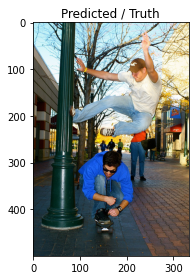

Prediction: 의 나무 의자에 앉아있는 두 남자. 두 남자가 나무 나무 구조물에 앉아 있습니다. 두 남자가 나무 구조물에 앉아 있습니다. 두 남자가 나무에 앉아 있습니다.[SEP] 나무에 앉아있는 두 남자[SEP] 십대[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ity[SEP]akers에 앉아 있습니다.[SEP]aeeeee에 앉아있는 두 남자.[SEP]akeeee[SEP]lacke[SEP]tie[SEP]lacke에 앉아있는 남자.[SEP]lacke[SEP]lacke에 앉아있는 남자.[SEP]ak[SEP]ak[SEP]ak[SEP]n.[SEP]ie[SEP]an[SEP]treet에 앉아있는 남자.[SEP]acke[SEP]treet의 남자.[SEP]treet에 앉아있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP]treet.[SEP]tres에 앉아있는 두 남자.[SEP]는 두 남자.[SEP]tres에 앉아있는 두 남자.[SEP]s에 앉아있는 두 남자.[SEP]lackeeeeeeeeeee[SEP]tres.[SEP]lackeeeeeeeee의 한 남자.[SEP]treet에 앉아있는 남자.[SEP]tone에 앉아있는 남자.[SEP]tress의 한 남자.[SEP]tres에 앉아있는 두 남자.[SEP]tre, 
Truth:  한 남자는 가라테가 라이트 포스트를 걷어차는 동안 선글라스를 입은 다른 친구는 그의 다리 아래에 스케이트 보드입니다. 그의 친구가 그 아래에 웅크 리고있는 동안 한 남자가 조명 기둥을 차고 있습니다. 남자 스케이트 보드가 있고 다른 남자가 그의 머리 위로 뛰어 다니고 있습니다. 한 사람이 가벼운 게시물을 사용하여 다른 사람을 뛰어 넘습니다.
17/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

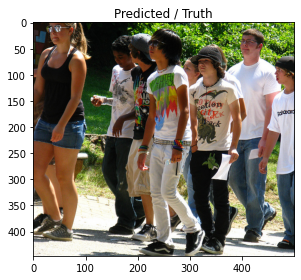

Prediction: 의 여성은 흰색 드레스를 입은 여자와 함께 걷는다. 흰색 드레스를 입은 여성이 길을 걷고 있습니다. 흰색 드레스를 입은 여성이 길을 걷고 있습니다. 셔츠를 입은 여자는 길을 걷고 있습니다.[SEP] 흰색 드레스를 입은 여자.[SEP] 셔츠를 입은 여자[SEP][SEP][SEP][SEP]를 입은 여자.[SEP]을 걷는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]s.[SEP]ssssssssssssssssssssssssssssssssssss.[SEP]sssssss.[SEP]sssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  밝은 화창한 날에 밖으로 걷는 캐주얼 옷을 입은 몇몇 젊은이들. 한 무리의 아이들이 밝은 날에 함께 걷습니다. 젊은 십대 그룹이 야외에서 걷고 있습니다. Preteens 그룹이 강 근처에서 걷는다.


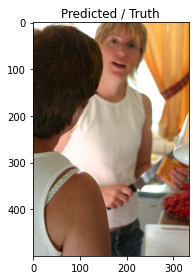

Prediction: 의 흰 셔츠를 입은 여자가 흰 셔츠를 입은 여자의 손을 잡고 있습니다. 흰 셔츠를 입은 여자가 흰 셔츠를 입은 여자의 손을 잡고 있습니다. 흰 셔츠를 입은 여자가 흰 셔츠를 입은 여자를 돕고 있습니다. 셔츠를 입은 여자가 흰 셔츠를 입은 여자에게 키스하고 있습니다.[SEP]는 여자.[SEP]는 여자.[SEP]를 만드는[SEP]를 만드는[SEP]는[SEP]는[SEP]습니다.[SEP]를 만듭니다.[SEP]습니다.[SEP]를 만듭니다.[SEP]는[SEP]를 만듭니다.[SEP]는[SEP]를 만듭니다.[SEP]는[SEP]를 만듭니다.[SEP]를 만듭니다.[SEP]는[SEP]는[SEP]는 여자[SEP]를 만듭니다.[SEP][SEP][SEP]를 만듭니다.[SEP]를 만듭니다.[SEP]를 만들고 있습니다.[SEP]를 만드는[SEP]는 여자.[SEP]는 여자[SEP]는[SEP]는[SEP]는[SEP]는 여자[SEP]를 만듭니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP]는[SEP]를 만들고 있습니다.[SEP]는 여자[SEP]를 요리합니다[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP]를 만들고 있습니다.[SEP]는[SEP]를 흰 흰 셔츠를 만들고 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP]를 만들고 있습니다.[SEP]를 흰 셔츠를 흰 셔츠를 셔츠를 셔, 
Truth:  짧은 머리카락을 가진 두 명의 여성이 서로 마주보고 있고 금발 한 명이 이야기하고 있습니다. 칼을 청소하는 두 여자가 부엌에서 이야기하고 있습니다. 흰색 티셔츠를 입은 두 명의 여성, 한 명은 칼을 잡고 생과자를 얇게 썬다. 빵을 얇게 썰면서 흰색 탑 채팅의 여자.


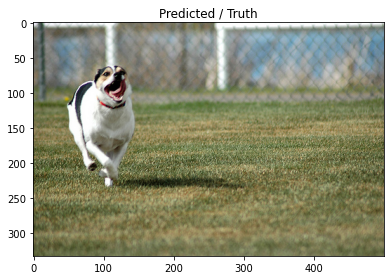

Prediction: 의 개가 잔디밭에서 달리고 있습니다. 잔디에서 달리는 개.[SEP]의 개가 들판에서 달리고 있습니다.[SEP]를 통과하는 개.[SEP]를 통과하는 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]er.[SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP]를[SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP]이트합니다.[SEP]합니다.[SEP][SEP]er.[SEP]이트에서 달리는[SEP]를합니다.[SEP]를합니다.[SEP]를합니다.[SEP]를합니다.[SEP]를 연주하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를 연주합니다.[SEP]를 연주하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][

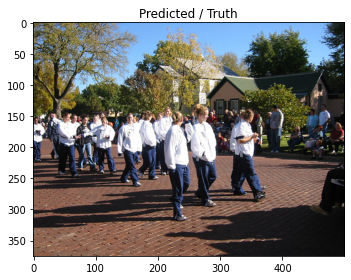

Prediction: 의 군중은 교회에서 춤을 추고 있습니다. 춤을 추는 춤을 추는 사람들의 그룹. 춤을 추는 사람들의 그룹.[SEP] 춤을 추는 사람들의 그룹.[SEP] 춤을 추는 사람들의 그룹.[SEP]의 그룹[SEP]iiiiii를 연주합니다.[SEP]의 그룹[SEP]iiiiiiiiiiiiiiiiiiii.[SEP]의 그룹.[SEP]는[SEP][SEP][SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 그룹.[SEP]는[SEP]의 그룹.[SEP]는[SEP][SEP]의 그룹[SEP]의 그룹[SEP]의 그룹[SEP]의 그룹.[SEP]의 그룹.[SEP]는[SEP]는[SEP]의 그룹[SEP]는[SEP]는[SEP]의 그룹[SEP][SEP]s의 그룹.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 연주.[SEP]iiiiiiiiiiiiiiiiiiiiiii, 
Truth:  한 무리의 사람들이 퍼레이드로 길을 걸어가는 것과 같은 옷을 입었습니다. 흰색 재킷에있는 사람들이 마을 거리에서 걷고 있습니다. 흰 셔츠를 입은 많은 아이들이 동네를 걷고 있습니다. 벽돌 도로를 걷는 흰색 칼라 셔츠의 아이들.


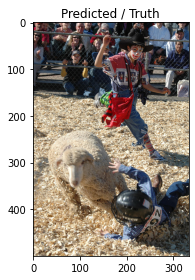

Prediction: 의 흙에서 흙에서 흙을 쫓는 사람들. 흙에서 흙길에서 흙길을 쫓는 사람들. 흙에서 흙길에서 흙길을 쫓는 사람들. 흙에서 흙길을 쫓는 사람들.[SEP]는 흙에서 흙을 흙길합니다.[SEP]는 흙에서 흙을 흙길습니다.[SEP]는[SEP]는[SEP]는 흙.[SEP]를 흙.[SEP]를 흙.[SEP]는[SEP]는[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]는[SEP][SEP][SEP]를 흙.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 흙에서[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP]를 흙에서 흙에있는[SEP]를 흙.[SEP]를 흙.[SEP]를 흙.[SEP]는[SEP][SEP][SEP][SEP]를 흙.[SEP]를 흙에있는[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]를 흙 흙 흙.[SEP][SEP][SEP][SEP][SEP][SEP]를 흙.[SEP]는[SEP]는[SEP]습니다.[SEP]를 흙에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]n.[SEP]n.[SEP]를 흙 흙 흙 흙에서 흙 흙 흙 흙 흙 흙 흙 흙, 
Truth:  양에서 떨어진 헬멧의 작은 아이를 향해 달려가는 검은 모자를 쓴 젊은 로데오 광대. 경쟁에서 양을 잡으려고하는 남자와 로데오 광대가 도와 주려고 노력했다. 파란색 셔츠를 입은 소년은 배경에 로데오 광대와 씨름하는 양입니다. 두 아이가 양을 만들려고하는 주니어 로데오 이벤트.


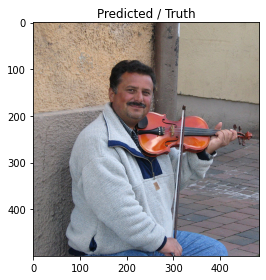

Prediction: 의 뮤지션은 기타를 연주하는 동안 흰색 셔츠를 입은 남자가 기타를 연주하고 있습니다. 흰색 셔츠를 입은 남자가 기타를 연주하고 기타를 연주하고 있습니다. 기타를 연주하는 셔츠를 입은 남자. 기타를 연주하는 흰 셔츠를 입은 남자.[SEP] 기타를 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을[SEP]는 기타를 연주하는 남자.[SEP]을[SEP]을[SEP]는 기타를 연주합니다[SEP]시오.[SEP]을[SEP]는 기타를 연주합니다[SEP]을[SEP]을[SEP]을[SEP]는 기타를 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다[SEP]합니다[SEP]는 기타를 연주합니다.[SEP]시오습니다.[SEP]을 연주합니다[SEP]시오습니다.[SEP][SEP]를 연주하는 남자.[SEP][SEP][SEP][SEP]를 연주하는 남자.[SEP]시스트.[SEP]는 기타를 연주하는 남자.[SEP]는 기타를 연주하는 남자.[SEP]는 기타를 연주하는 남자.[SEP][SEP][SEP][SEP]는 기타를 연주하는 남자.[SEP][SEP][SEP][SEP]을 연주하는 남자.[SEP]을 연주하는 남자.[SEP]을[SEP]을 연주하는 남자.[SEP][SEP][SEP][SEP]시도.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]시스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]을 연주하는[SEP]스트.[SEP][SEP][SEP][SEP]을, 
Truth:  바이올린을 연주하는 회색 풀오버 스웨터를 입은 남자. 한 남자가 보도에서 외부 바이올린을 연주하고 있습니다. 한 남자가 바깥 쪽 바이올린을 구부리고 안고 있습니다. 남자는 웃으면 서 바이올린을 연주합니다.


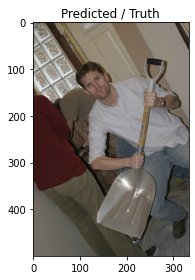

Prediction: 의 나무 바닥에 앉아있는 두 명의 여성. 두 명의 여성이 나무 바닥에 앉아 있습니다. 두 명의 여성이 의자에 앉아 있습니다. 두 명의 여성이 나무 바닥에 앉아 있습니다.[SEP] 의자에 앉아있는 두 명의 여성.[SEP]는 의자에 앉아 있습니다.[SEP]는[SEP]는[SEP]를합니다[SEP]습니다[SEP]를합니다[SEP]습니다.[SEP]는[SEP]를합니다[SEP]는[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP]를합니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]s.[SEP].[SEP].[SEP]s.[SEP][SEP][SEP] 있습니다.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiii.[SEP]는[SEP][SEP]는[SEP]를[SEP]를[SEP]를[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]를[SEP]는[SEP]는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]스트[SEP]스트[SEP][SEP][SEP].[SEP]스트[SEP]스트.[SEP]스트[SEP]스트[SEP]스트.[SEP]스트.[SEP]iiiiii, 
Truth:  흰색 티셔츠를 입은 남자가 스노우 삽을 들고 있습니다. 스노우 삽을 들고 흰 셔츠를 입은 남자. 한 남자가 무기처럼 삽을 들고 있습니다. 이 사람은 

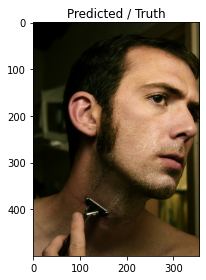

Prediction: 의 셔츠를 입은 남자가 나무를 들고 있습니다. 나무가있는 나무를 들고있는 남자. 나무를 들고있는 남자. 나무를 들고있는 남자.[SEP]을 가진 남자.[SEP]을 가진[SEP]는 셔츠를 입고 있습니다.[SEP]을 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을[SEP]는[SEP][SEP][SEP]을[SEP]을합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]을[SEP]을[SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 남자.[SEP][SEP][SEP][SEP]을[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP]을[SEP].[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP]을[SEP].[SEP].[SEP][SEP][SEP][SEP].[SEP]을[SE

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 17 summary:
Train loss: 1.8297, validation loss: 2.4939
Train accuracy: 0.4205, validation accuracy: 0.3598
Time per 17 epoch: 168.0 minutes
18/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

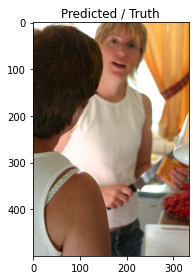

Prediction: 의 여성이 맥도날드를 굽고 있습니다. 여자가 맥도날드를 굽고 있습니다. 여자가 맥도날드를 굽고 있습니다. 여자가 음식을 요리하고 있습니다.[SEP]를 요리하는 여자.[SEP]를 요리하는[SEP][SEP][SEP][SEP][SEP]를 요리하는 여자.[SEP]를[SEP][SEP][SEP][SEP][SEP][SEP]를 요리하는 여자.[SEP]를 즐깁니다.[SEP]를[SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를[SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP]를[SEP]를[SEP]습니다.[SEP]습니다.[SEP]를 즐[SEP]는[SEP]를 즐[SEP]를 즐[SEP]를 즐[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐깁니다.[SEP]를 즐깁니다.[SEP]는[SEP]는[SEP]를 즐깁니다.[SEP][SEP][SEP]를 요리합니다[SEP]를 요리합니다[SEP]를 요리합니다[SEP]를 요리합니다[SEP]를 요리합니다[SEP]를 즐깁니다.[SEP]는[SEP]는[SEP]는 여자[SEP]를 즐깁니다.[SEP]를 즐깁니다.[SEP]는 여자[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐깁니다.[SEP]를 즐깁니다.[SEP]는 여자[SEP]를 셔[SEP][SEP][SEP][SEP][SEP]를 즐[SEP]를 즐깁니다.[SEP]를 즐깁니다.[SEP]를 셔[SEP]를 흰색[SEP]를 셔[SEP]를 흰색, 
Truth:  짧은 머리카락을 가진 두 명의 여성이 서로 마주보고 있고 금발 한 명이 이야기하고 있습니다. 칼을 청소하는 두 여자가 부엌에서 이야기하고 있습니다. 흰색 티셔츠를 입은 두 명의 여성, 한 명은 칼을 잡고 생과자를 얇게 썬다. 빵을 얇게 썰면서 흰색 탑 채팅의 여자.


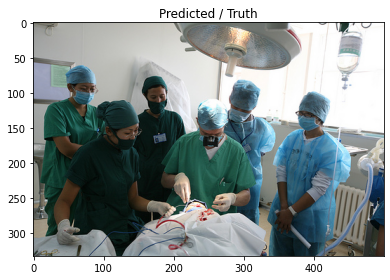

Prediction: 의 여성들은 흰색 티셔츠를 입은 여성 그룹이 사진을 찍습니다. 한 무리의 사람들이 사진을 찍고 있습니다. 한 무리의 사람들이 사진을 찍고 있습니다. 한 무리의 사람들이 사진을 찍고 있습니다.[SEP]에있는 사람들.[SEP]는 사진을 찍는 사람들의 그룹.[SEP]는 그룹.[SEP]는 사진을 위해 포즈를 취합니다.[SEP]는 그룹.[SEP]는[SEP]를 촬영합니다.[SEP].[SEP].[SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP]iiiiiiiiiiiiiiiiii.[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP].[SEP]는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]는[SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]를 즐기는[SEP].[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP], 
Truth:  외과의는 수술을 수행하는 녹색 스크럽에서 의사를 관찰합니다. 녹색 스크럽의 남자가 수술을 수행하고 있습니다. 외과 의사 팀이 환자를 위해 일하고 있습니다. 의사들은

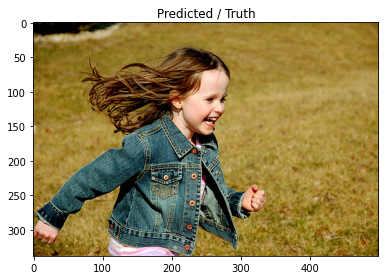

Prediction: 의 여성이 마이크로 말하고 있습니다. 마이크로 말하는 여성이 말하고 있습니다. 마이크에 서있는 여자.[SEP] 필드에 서있는 여자.[SEP] 필드에 서있는 여자.[SEP] 필드에 서있는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 가진[SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP]s의 한 여성이 마이 마이크에 있습니다.[SEP]를 들고 있습니다.[SEP]를 가진[SEP]ie[SEP]를 가진[SEP]를 가진[SEP]를 들고 있습니다.[SEP]를 입은 여자[SEP]를 들고 있습니다.[SEP]를 들고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]이 마이터.[SEP][SEP][SEP]를 입은 여자[SEP][SEP][SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP]를 입은 여자[SEP]를 가진[SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입은 여성이 마이 마이커.[SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP]를 입은[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP]를 입고 있습니다.[SEP]스트.[SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP]를 입고 있습니다, 


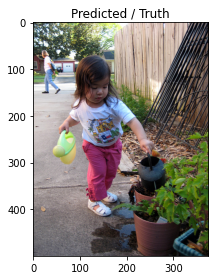

Prediction: 의 유아가 잎과 함께 놀고 있습니다. 어린 소녀가 잎과 함께 놀고 있습니다. 어린 소녀가 잎을 가지고 놀고 있습니다. 어린 소녀가 잎을 가지고 놀고 있습니다.[SEP]는 장난감으로 놀고 있습니다.[SEP]는 장난감을 가지고 놀고 있습니다[SEP][SEP][SEP][SEP]는 어린 소녀[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ee를 가지고 놀아요.[SEP]neeeee를 가지고 놀고 있습니다.[SEP]n.[SEP]는 장난감을 가지고 놀고 있습니다.[SEP]neee[SEP]를 가지고 놀고 있습니다.[SEP]는 장난감을 가지고 놀고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]neeeeeeeeeeeeee[SEP]n이터에서 놀고 있습니다.[SEP]를 가지고 놀고있는[SEP]를 가지고 놀고있는[SEP]n.[SEP]는 장난감을 가지고 노는 장난감을 가지고 노는 장난감을 가지고 놀고있는[SEP]를 가지고 놀고있는[SEP]는 장난감을 가지고 놀고있는 어린 소녀[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]는 장난감을 가지고 노는 장난감을 가지고 놀고있는[SEP]n.[SEP][SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]nertressssssssssssbe를 가지고 노는 장난, 
Truth:  아시아 소녀는 여자가 보도에서 지나갈 때 차도 옆에 식물을 공급합니다. 작은 소녀가 보도에 식물에 물을 뿌리며 여자가 백그라운드에서 걸어갑니다. 분홍색 바지를 곁들인 유아는 물을 작은 식물에 붓습니다. 어린 아이는 식물에 물을 뿌립니다.


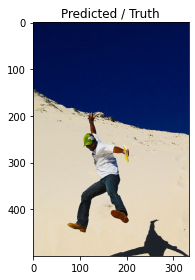

Prediction: 의 모래에 서있는 동안 남자가 모래에 손을 잡고 있습니다. 모래에있는 남자가 모래에 서 있습니다. 모래에 서있는 남자. 모래에 서있는 남자.[SEP] 가라테를하는 남자.[SEP]에있는 남자.[SEP]에있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를하는 남자.[SEP]을 위해[SEP]는[SEP][SEP]을합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP]를하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP]s.[SEP]를하는 남자.[SEP]를합니다.[SEP][SEP][SEP][SEP][SEP]를하는 남자.[SEP]를하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 남자.[SEP]s.[SEP]를하는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]s.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP]s.[SEP]를하는 남자.[SEP]을[SEP]을[SEP]을합니다.[SEP][SEP][SEP].[SEP]을합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]를하는 남자.[SEP][SEP]을 위해 쳤

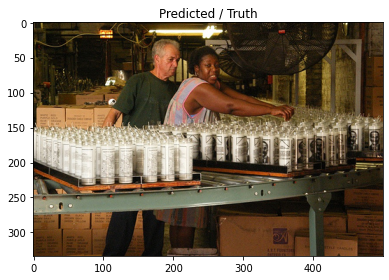

Prediction: 의 피아노를 연주하는 셔츠를 입은 남자. 피아노에서 피아노를 연주하는 남자. 피아노에서 피아노를 연주하는 남자. 피아노에서 피아노를 연주하는 남자.[SEP] 피아노를 연주하는 남자.[SEP] 피아노를 연주하는 남자.[SEP]을 연주하는[SEP]는[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를[SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트.[SEP]스트.[SEP]스트가[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]를[SEP]를[SEP]습니다.[SEP]습니다.[SEP]를[SEP]습니다.[SEP][SEP][SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP], 
Truth:  흑인 여성과 백인 남자는 촛불을 상자에 넣은 항아

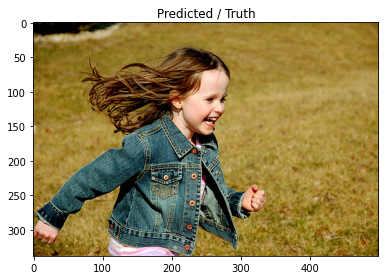

Prediction: 의 갈색 머리카락을 가진 여자는 들판을 가로 질러 걷고 있습니다. 녹색 재킷을 입은 여성이 들판을 가로 질러 걷고 있습니다. 녹색 재킷을 입은 여성이 들판을 가로 질러 걷고 있습니다. 녹색 재킷을 입은 여성이 들판을 가로 질러 걷고 있습니다.[SEP]는 녹색 재킷을 입고 있습니다.[SEP]는 여자[SEP]을 입고 있습니다[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ssssssssssssssss.[SEP]ssssssss.[SEP]s.[SEP]ssssssssss.[SEP]n.[SEP]sssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  필드에서 달리는 동안 웃는 블루 진 재킷을 가진 어린 소녀. 진 재킷을 입은 어린 소녀가 달리고 웃고 있습니다. 필드를 통과하는 데님 재킷을 입은 어린 소녀. 어린 소녀가 잔디에서 달리고 웃고 있습니다.


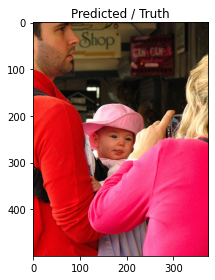

Prediction: 의 여성은 붐비는 거리에서 춤을 추고 있습니다. 붉은 머리 여자는 붉은 머리 여자와 헬멧을 착용합니다. 여자는 붉은 머리 여자와 헬멧을 착용합니다. 여자는 붉은 머리를 가진 남자가 춤을 추고 있습니다.[SEP]는 빨간 셔츠를 입은 여자를 입은 여자.[SEP]는 붉은 머리를 가진 여자.[SEP]고 있습니다.[SEP]는 여자[SEP]고 있습니다.[SEP]는[SEP]는 여자[SEP]는 여자[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]를 가진[SEP]는 여자[SEP]를 가진[SEP]를 춤을[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐깁니다.[SEP]습니다.[SEP]습니다.[SEP]는 여자[SEP]로봇.[SEP][SEP][SEP][SEP][SEP][SEP]sss습니다.[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]습니다.[SEP]는 여자[SEP]는 여자[SEP]는 여자[SEP]습니다.[SEP]습니다.[SEP]를 가진[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 여자[SEP]는 여자[SEP]ssss.[SEP]s습니다.[SEP]는 여자[SEP]는 여자[SEP]yondy[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]t[SEP] 있습니다.[SEP] 있습니다.[SEP]를 가진[SEP]ssssssssssssssssssssss, 
Truth:  여자가 아기의 사진을 찍는 동안 남자가 아기를 안고 있습니다. 핑크 모자를 쓴 아기, 남자가 빨간색으로 붙잡고 여자가 분홍색으로 여자. 여자는 남자가 붙잡는 아기의 사진을 찍습니다. 여자는 분홍색 모자로 아기 사진을 찍고 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 18 summary:
Train loss: 1.7688, validation loss: 2.5083
Train accuracy: 0.4276, validation accuracy: 0.3602
Time per 18 epoch: 175.0 minutes
Prediction after 18 epoch.


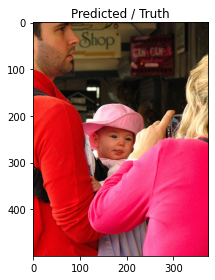

Prediction: 의 여성은 붐비는 거리에서 깃발을 들고 있습니다. 깃발을 들고있는 여자가 깃발을 들고 있습니다. 깃발을 들고있는 여자. 여자가 깃발을 들고 있습니다.[SEP] 깃발을 들고있는 여자.[SEP] 깃발을 들고있는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]ssss의 여자.[SEP]y Stssssss.[SEP]sssssssssssssssssssssss.[SEP]treet에서[SEP]treet에서 남자.[SEP]y Street.[SEP]s.[SEP]ey Street에서 남자가 셔츠를 들고 있습니다.[SEP]n Dey Stres습니다.[SEP]n Dops를 들고있는 여자[SEP]를 들고있는 여자.[SEP]s.[SEP]s.[SEP]sssssss습니다.[SEP]ey Stres를 입은 남자가 셔츠를 들고있는 여자.[SEP]s습니다.[SEP]sssssssss.[SEP]tres습니다.[SEP]tres의 한 여성이있는 여자.[SEP]tres의 한 여성이크 리버를 들고있는 여자가 셔츠를 들고있는 여자.[SEP]tressssssss를 들고있는 여자.[SEP]tre, 
Truth:  여자가 아기의 사진을 찍는 동안 남자가 아기를 안고 있습니다. 핑크 모자를 쓴 아기, 남자가 빨간색으로 붙잡고 여자가 분홍색으로 여자. 여자는 남자가 붙잡는 아기의 사진을 찍습니다. 여자는 분홍색 모자로 아기 사진을 찍고 있습니다.
19/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

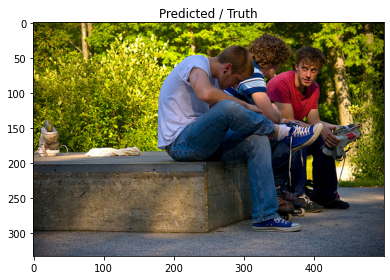

Prediction: 의 두 명의 여성이 함께 앉아서 이야기하고 있습니다. 두 명의 여성이 돌 계단에 앉아 있습니다. 두 명의 여성이 계단에 앉아 있습니다. 두 명의 여성이 계단에 앉아 있습니다.[SEP]을 즐기는 두 명의 여성[SEP] 명[SEP] 명[SEP]를 입고 있습니다[SEP]는 두 명의 여성[SEP] 명[SEP] 명[SEP] 명[SEP]를합니다[SEP] 명[SEP] 명[SEP] 명[SEP] 명[SEP] 명[SEP] 명[SEP] 명[SEP] 명[SEP]를 입고 있습니다.[SEP] 명[SEP]sbe의 두 명의 여성이 앉아 있습니다.[SEP]sbehnersbehnersbe에 앉아 있습니다.[SEP]nersbe에 앉아있는 두 명의 여성이 함께 앉아있는 두 명의 여성[SEP]를 즐기는 두 명의 여성[SEP]nertreet에서 이야기합니다.[SEP]nersbe에 앉아 있습니다.[SEP]ners에 앉아 있습니다.[SEP]에 앉아있는 두 명의 여성[SEP]를 즐기는 두 명의 여성.[SEP]nsbe한 부부[SEP]습니다.[SEP]습니다.[SEP]ranke에 앉아있는 두 명의 여성[SEP]nersbe를 즐기는 두 명의 여성이 함께 앉아있는 두 명의 여성.[SEP]nertoneeeeeee를 즐기는 두 명의 여성이 함께 앉아있는 두 명의 여성.[SEP]n.[SEP]n.[SEP]를 즐기는 두 명의 여성이 함께 앉아있는 두 명의 여성이 함께 앉아있는 두 명의 여성이 함께 앉아있는 두 명의 여성, 
Truth:  흰 셔츠, 청바지, 그리고 다른 두 소년 옆에 앉아있는 밝은 파란색 신발을 입은 청년. 한 남자가 대화를 나누는 두 남자 옆에 파란 스니커즈를 확인하고 있습니다. 3 명의 십대 소년들에게 앉아서 신발을 고치고 있습니다. 한 무리의 젊은이들이 스케이트 보드와 함께 공원에서 나눠집니다.


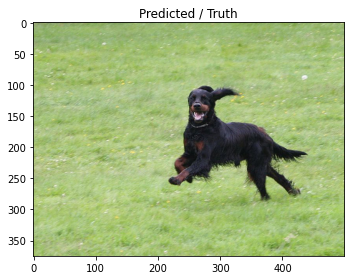

Prediction: 의 개는 잔디밭에서 달리고 있습니다. 잔디에서 달리는 검은 개. 잔디에서 달리는 검은 개.[SEP] 달리는 검은 개[SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]은 개가 잔디에서 달린다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]sbee를 통과하는 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]sbe[SEP][SEP][SEP]sbe[SEP][SEP][SEP][SEP][SEP]s.[SEP]s.[SEP][SEP][SEP]s.[SEP][SEP]sbee[SEP][SEP][SEP]sbe를합니다.[SEP]sbeeeeeeeeeeeeeeeee를 입고 있습니다.[SEP]sbe를 입고 있습니다.[SEP][SEP][SEP]sbe를 입고 있습니다.[SEP]sbe를 입고[SEP]sbe를 입고 있습니다.[SEP]sbe를 입고 있습니다.[SEP]sbe를 입고 있습니다.[SEP]sbe를 입고있는[SEP]sbe를 입고있는[SEP]sbe를 연주하는 개.[SEP]sbe를 입고 있습니다.[SEP]sbe를 입고 있습니다.[SEP]sbe를 통과하는 개[SEP]sbe를 입고 있습니다.[SEP]sbe를 입고있는[SEP]sbe를 입고 있습니다.[SEP]tie를 입고 있습니다, 
Truth:  검은 색과 갈색 모피 개가 잔디에서 달리고 있습니다. 잔디밭을 통과하는 갈색과 검은 개 입이 열린 푸른 잔디에 달리는 검은 개. 잔디밭에 큰 개 광학.


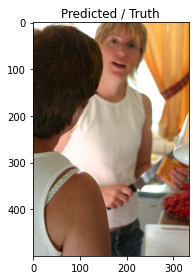

Prediction: 의 여성은 흰색 셔츠를 입은 여자에게 음료를 마시고 있습니다. 여자는 음료를 마시면서 음료를 마시는 음료를 마신다. 음료를 마시는 여자. 음료를 마시는 여자.[SEP] 맥주를 마시는 여자.[SEP] 맥주를 마시는 여자.[SEP]를 마시는 여자.[SEP]를 마시는[SEP]를 마시는[SEP]를 마시고 있습니다.[SEP][SEP]는[SEP][SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 마시는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]를 마시는 여자.[SEP][SEP][SEP] 있습니다.[SEP] 있습니다.[SEP]를 마시는 여자.[SEP][SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 마시는 여자.[SEP][SEP][SEP][SEP][SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP]를 마시는 여자.[SEP]시는 여자.[SEP]시는 여자.[SEP] 있습니다.[SEP]를 위해 요리합니다.[SEP]시는 여자.[SEP]를 마시는 여자.[SEP]를 위해 요리합니다.[SEP]를 위해 요리, 
Truth:  짧은 머리카락을 가진 두 명의 여성이 서로 마주보고 있고 금발 한 명이 이야기하고 있습니다. 칼을 청소하는 두 여자가 부엌에서 이야기하고 있습니다. 흰색 티셔츠를 입은 두 명의 여성, 한 명은 칼을 잡고 생과자를 얇게 썬다. 빵을 얇게 썰면서 흰색 탑 채팅의 여자.


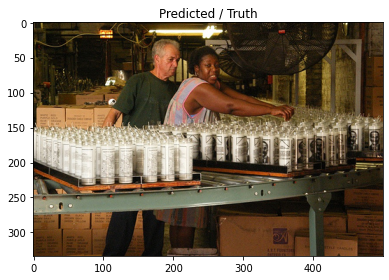

Prediction: 의 나무 의자에 앉아있는 두 명의 여성. 두 명의 여성이 나무 의자에 앉아 있습니다. 두 명의 여성이 나무 의자에 앉아 있습니다. 두 명의 여성이 나무 의자에 앉아 있습니다.[SEP] 의자에 앉아있는 두 명의 여성.[SEP] 명의 여성이 의자에 앉아 있습니다.[SEP]는[SEP]n.[SEP]n.[SEP]n.[SEP]n[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]s[SEP]를 위해 있습니다.[SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 함께[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]는[SEP]는[SEP]는[SEP]습니다.[SEP]n.[SEP]n.[SEP]습니다.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]tone[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]시오스크를 위해 함께[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t[SEP]t, 
Truth:  흑인 여성과 백인 남자는 촛불을 상자에 넣은 항아리를 포장하는 공장에서 일하는 백인. 여자는 녹색 셔츠를 입은 남자가 그녀의 뒤에 서서 하얀 키 큰 양초를 분류하고 있습니다. 직원을 지원하는 창고 관리자. 어셈블리 라인에서 일하는 두

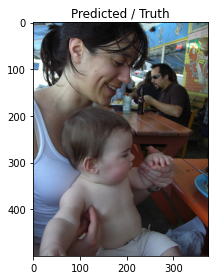

Prediction: 의 여성은 어머니와 아들은 어머니와 아들을 즐기고 있습니다. 어머니와 아들은 어머니와 아들이 의자에 앉아 있습니다. 어머니와 아들은 어머니는 어머니와 아들에게 먹습니다. 어머니와 아들은 어머니와 아들은 어머니에게 먹습니다.[SEP]는 어머니와 아들을 먹고 있습니다.[SEP]는 어머니.[SEP]에게 먹는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP]에게 먹이를주합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]칩니다.[SEP][SEP][SEP][SEP][SEP][SEP]h.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]e[SEP]e[SEP][SEP]e[SEP]e[SEP]e[SEP]e[SEP]e.[SEP]e.[SEP]r.[SEP]e[SEP]e[SEP]e[SEP]r.[SEP]r.[SEP]r.[SEP]he[SEP]e[SEP]r.[SEP]r.[SEP]ee[SEP]e[SEP]r.[SEP]r.[SEP]r에게 먹이를 즐기는 여자[SEP]r.[SEP]r에게 먹이를 즐기는 여자.[SEP]r.[SEP]는 여자.[SEP]r에게 키스하는 여자.[SEP]r.[SEP]r.[SEP]t.[SEP]toneeeeeeee[SEP]r.[SEP]t.[SEP]ton[SEP]r에게 키스하는 동안[SEP]r에게 먹이를주하는 여자.[SEP]t.[SEP]t.[SEP]toneee[SEP]r., 
Truth:  흰색 탱크 탑에있는 여자와 아기가 테이블에 앉아 먹을 것을 얻습니다. 행복한 엄마는 아기를 테이블 위의 접시에서 멀리두고 있습니다. 어머니가 식당에서 무릎에 아기를 안고 있습니다. 아기는 웃는 여자의 무릎에 앉아 있습니다.


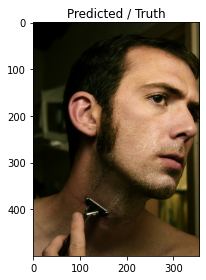

Prediction: 의 젖은 머리카락을 가진 여자가 젖은 머리카락을 가진 여자의 근접 촬영. 젖은 여자가 젖은 머리카락을 가진 여자의 머리카락을 가진 남자의 근접 촬영. 젖은 여자가 젖은 머리카락을 가진 남자의 머리카락을 가진 남자.[SEP] 젖은 여자의 머리카락을 가진 남자.[SEP] 젖은[SEP]을 가진 남자.[SEP]고 있습니다.[SEP]는[SEP][SEP]을 가진[SEP]을 가진[SEP]는[SEP]을 가진[SEP]습니다.[SEP]을 가진[SEP]습니다.[SEP][SEP][SEP]을 가진[SEP]을[SEP]을[SEP]을[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP]을 가진 남자.[SEP]을 가진 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 근[SEP]의 근[SEP]의 근.[SEP]을 가진[SEP].[SEP].[SEP][SEP][SEP].[SEP]의 근.[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]을 가진[SEP].[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP]을 가진[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]을 가진[SEP].[SEP]스트.[SEP].[SEP]스트.[SEP]스트.[SEP]스트.[SEP].[SEP].[SEP]스트.[SEP].[SEP].[SEP]., 
Truth:  젊은 성인 남성은 면도기가 목을 내려 가면서 얼굴을 면도했다. 한 남자는 목을 면도하지만 수염은 아닙니다. 한 남자가 조심스럽게 수염을 깎습니다. 면도기와 목을 깎는 남자.


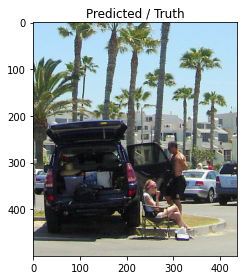

Prediction: 의 두 명의 여성이 차 안에서 일하고 있습니다. 두 명의 여성이 차 안에서 일하고 있습니다. 두 명의 여성이 차에서 일하고 있습니다. 두 명의 여성이 차 안에서 일하고 있습니다.[SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성.[SEP]를하는 두 명의 여성.[SEP]를보고있는[SEP][SEP][SEP][SEP][SEP].[SEP]를 가진[SEP]를 가진[SEP]를 즐기는 두.[SEP].[SEP].[SEP]를 즐기는[SEP][SEP].[SEP]를 즐기.[SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]를 즐기는[SEP].[SEP][SEP][SEP][SEP].[SEP].[SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 두 사람.[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP], 
Truth:  접이식 의자에있는 여성은 한 남자가 연석에 주차 된 차 문 안으로 쳐다 보는 동안 먹는다. 남자가 스포츠 유틸리

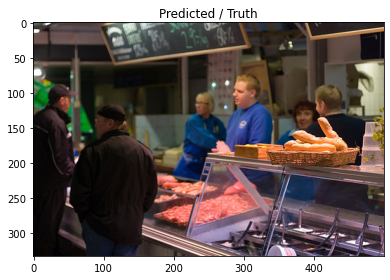

Prediction: 의 음식을 먹는 사람들의 그룹. 사람들은 음식을 먹습니다. 음식을 먹는 사람들의 그룹.[SEP] 음식을 먹는 사람들.[SEP] 음식을 먹는 사람들.[SEP]는 사람들[SEP]를 먹습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ere St.[SEP]ie에서 음식을 먹습니다.[SEP]는[SEP]를 먹습니다.[SEP]습니다[SEP]는[SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]를 먹고 있습니다.[SEP][SEP]습니다[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다.[SEP][SEP][SEP]습니다[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiie[SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]wie[SEP]습니다.[SEP] 고객.[SEP] 고객은[SEP] 고객.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 먹습니다[SEP]를 먹습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]를 먹습니다.[SEP]습니다.[SEP] 고객은[SEP]습니다[SEP]iiiiiiiiie[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]A[SEP] 있습니다[SEP] 있습니다[SEP]스트[SEP]를 먹습니다[SEP]습니다.[SEP]스트가 먹고 있습니다.[SEP]를 먹습니다[SEP]습니다.[SEP]iiii, 
Truth:  직원이 기다리는 동안 고객은 육류 카운터를 탐색합니다. 델리에서 무언가를 

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 19 summary:
Train loss: 1.7119, validation loss: 2.5212
Train accuracy: 0.4328, validation accuracy: 0.3585
Time per 19 epoch: 183.0 minutes
20/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

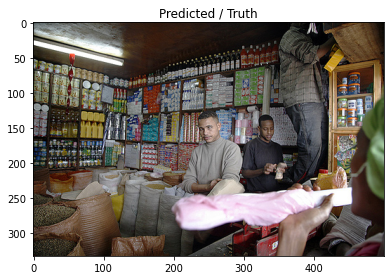

Prediction: 의 사람들은 의자에 앉아있는 동안 의자에 앉아 있습니다. 의자에 앉아있는 사람들의 그룹은 의자에 앉아 있습니다. 의자에 앉아있는 사람들. 의자에 앉아있는 사람들.[SEP]는 의자에 앉아 있습니다.[SEP]는[SEP]iiiiiiiii를 기다리고 있습니다.[SEP]는 바쁘게[SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP]에게 말합니다.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 바쁘게[SEP]는 바쁘게[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]는 바쁘게[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 바쁘게[SEP]는 바쁘게[SEP]는 바쁘게[SEP]는 바쁘게를 연주를 연주를 연주고 있습니다.[SEP]습니다.[SEP]는 바쁘게[SEP]는 바쁘게[SEP] 있습니다.[SEP] 있습니다.[SEP]는 바쁘게[SEP]는 바쁘게됩니다.[SEP]는 바쁘게를 연주고 있습니다.[SEP]는 바쁘게티스트는 바쁘게를 연주고 있습니다.[SEP]는 바쁘게티스트는 바쁘게를 연주얼어납니다.[SEP]는 바, 
Truth:  몇몇 남자들은 재고 선반과 곡물 가방 사이에 상점 안에 있습니다. 일반 상점에서 품목 유형에 도달하는 사람. 두 청년은 상점 뒷방에서 다른 남자를 도와줍니다. 품목을 구입하여 상점에서 일하는 세 남자


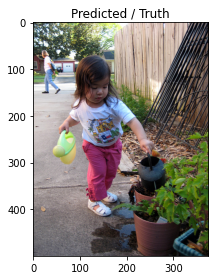

Prediction: 의 유아는 나무 바닥에 앉아 있습니다. 어린 소녀가 나무를 가지고 놀고 있습니다. 어린 소녀가 나무를 가지고 놀고 있습니다. 어린 소녀가 나무를 가지고 놀고 있습니다.[SEP]로 가득 찬 테이블에서 놀고있는 어린 소녀.[SEP]로 놀고있는 어린 소녀[SEP][SEP][SEP][SEP]nertie에서 놀고 있습니다.[SEP]는 놀고 있습니다.[SEP]는[SEP]nert[SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 위해 놀고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]nertone로 놀고 있습니다.[SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 놀고 있습니다.[SEP][SEP]n.[SEP]n.[SEP]n.[SEP]는[SEP]를 위해 놀고 있습니다.[SEP]를 위해 놀고 있습니다.[SEP][SEP][SEP][SEP]nert[SEP]n.[SEP]nert[SEP]n.[SEP]n.[SEP]n.[SEP]nert[SEP]nertone를 위해 놀고 있습니다.[SEP]n.[SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]nert[SEP]nert[SEP]nert[SEP]nert[SEP]nert[SEP]nert[SEP]n, 
Truth:  아시아 소녀는 여자가 보도에서 지나갈 때 차도 옆에 식물을 공급합니다. 작은 소녀가 보도에 식물에 물을 뿌리며 여자가 백그라운드에서 걸어갑니다. 분홍색 바지를 곁들인 유아는 물을 작은 식물에 

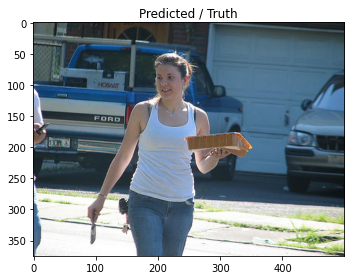

Prediction: 의 여성이 핸드폰으로 말하고 있습니다. 한 여성이 핸드폰으로 말하고 있습니다. 핸드폰에서 전화를 들고있는 여자. 전화를 들고있는 여자.[SEP] 핸드폰으로 이야기하는 여자.[SEP] 핸드폰에있는 여자.[SEP] 핸드폰에있는 여자.[SEP] 핸드폰.[SEP]를 가진[SEP][SEP][SEP]를 들고있는 여자.[SEP]를 들고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 들고있는 여자.[SEP]는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]시오.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 들고있는 여자.[SEP]를 위해 핸드, 
Truth:  흰색 탱크 탑에있는 여성은 붓과 페인트 트레이가 손에 있습니다. 흰색 탱크 탑에있는 여자가 손에 무언가를 가지고 걷고 있습니다. 한 여성이 페인트 트레이와 붓을 외부로

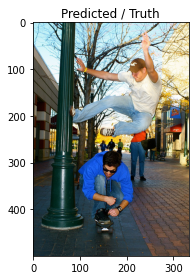

Prediction: 의 두 명의 여성이 도시 거리에서 놀고 있습니다. 두 명의 여성이 도시 거리에서 놀고 있습니다. 두 명의 여성이 도시 거리에서 놀고 있습니다. 두 명의 여성이 도시에서 놀고 있습니다.[SEP]lacks에있는 두 명의 여성.[SEP]lackeeeee의 두 명의 여성.[SEP]lackeeeeeeeeee를 마시는 두 명의 여성.[SEP]lackeeeeeeeeeeeee의 두 명의 여성.[SEP]lackeeeean.[SEP]treet에서 마당에있는 두 명의 여성.[SEP]lackeeeeeeean.[SEP]an은[SEP]treet에서 마당에있는 두 명의 여성이 마당에있는 두 명의 여성이 마당에있는 두 명의 여성.[SEP]를 마당에있는 두 명의 여성.[SEP]treet.[SEP]treet.[SEP]는 두 명의 여성이 마당에있는 두 명의 여성이 마당에있는 두 명의 여성.[SEP]treet.[SEP]treet에서 마스크를 즐기는 두 명의 여성.[SEP]treet.[SEP]treet에서 두 명의 여성이 마스크를 마스크를 마당에있는 두 명의 여성이 마당에있는 두 명의 여성.[SEP]treet에서 마스크를 마스크를 마스크를 마스크를 마스크를 마스크, 
Truth:  한 남자는 가라테가 라이트 포스트를 걷어차는 동안 선글라스를 입은 다른 친구는 그의 다리 아래에 스케이트 보드입니다. 그의 친구가 그 아래에 웅크 리고있는 동안 한 남자가 조명 기둥을 차고 있습니다. 남자 스케이트 보드가 있고 다른 남자가 그의 머리 위로 뛰어 다니고 있습니다. 한 사람이 가벼운 게시물을 사용하여 다른 사람을 뛰어 넘습니다.


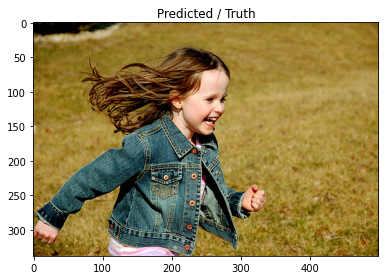

Prediction: 의 갈색 머리카락을 가진 여자는 공원에서 밖에 있습니다. 녹색 셔츠를 입은 여자가 밖에서 손을 뻗어 있습니다. 녹색 셔츠를 입은 여자가 밖에서 밖에서 놀고 있습니다. 녹색 셔츠를 입은 여자가 밖에서 놀고 있습니다.[SEP]을 가진 여자가 밖에서 놀고 있습니다.[SEP]로프[SEP]를하는 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 입고[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP][SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 입고 있습니다.[SEP]를 입고 있습니다.[SEP]을 입고 있습니다.[SEP][SEP][SEP]을 입고 있습니다.[SEP][SEP][SEP][SEP]를 입고 있습니다.

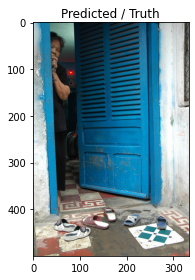

Prediction: 의 한 여성이 나무 창문을 통해 씻고 있습니다. 한 여성이 창문을 통해 창문을 청소하고 있습니다. 창문을 청소하는 여자.[SEP]는 창문을 청소하고 있습니다.[SEP]는 창문을 청소하고 있습니다.[SEP]는 창문을 청소합니다.[SEP]는 창문을 청소합니다[SEP]는 창[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]a.[SEP]는 창문을 씻는[SEP]a[SEP]를 씻[SEP]칩니다.[SEP]는[SEP]는 남자[SEP]는[SEP]습니다.[SEP]를 튜브[SEP]는[SEP]는[SEP]습니다.[SEP]를 튜브를 튜브[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 튜브[SEP]습니다.[SEP]습니다.[SEP]는 남자[SEP]는 남자[SEP]칩니다.[SEP][SEP][SEP][SEP]afafaf.[SEP]를 튜브를 튜브를 튜브를 튜브를 튜브[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP]는 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP]n[SEP]ns[SEP]는 남자[SEP]는 남자[SEP]n De[SEP]는 남자[SEP]n.[SEP]는 남자[SEP][SEP]n[SEP]nssss[SEP]n[SEP]를 튜브를 튜브를 튜브를 튜브를 튜브를 튜브를, 
Truth:  약간의 늙은 여자는 파란 출입구 뒤에서 3 쌍의 플라스틱 샌들을 밟습니다. 푸른 문이 열리고 여자가 왼쪽에서 엿볼 수 있습니다. 늙은 아시아 여성은 푸른 출입구 뒤에서 보입니다. 파란 출입구 주위를 들여다 보는 아시아 여성.


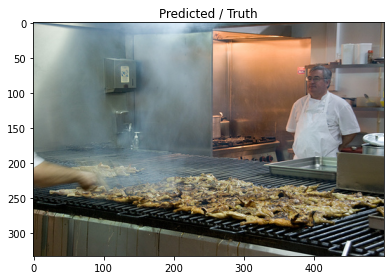

Prediction: 의 요리사는 음식을 요리하고 있습니다. 요리사는 음식을 준비하고 있습니다. 요리사가 음식을 준비하고 있습니다. 요리사.[SEP] 요리사는 음식을 준비합니다.[SEP] 요리사[SEP]을 준비하는 요리사.[SEP]A[SEP]을[SEP]는 요리사.[SEP] 요리[SEP][SEP][SEP][SEP][SEP][SEP]A[SEP][SEP][SEP][SEP][SEP]습니다[SEP][SEP][SEP][SEP][SEP]itch[SEP][SEP][SEP][SEP][SEP][SEP]A.[SEP]d을 요리[SEP]습니다.[SEP]A[SEP]A[SEP]습니다.[SEP] 요리[SEP] 요리[SEP]습니다[SEP]습니다.[SEP] 요리[SEP] 요리[SEP] 요리.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP]습니다.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리.[SEP] 요리.[SEP] 요리.[SEP] 요리.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리.[SEP] 요리.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리.[SEP]습니다.[SEP] 요리.[SEP]습니다.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리.[SEP]습니다.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP]습니다.[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리[SEP] 요리.[SEP

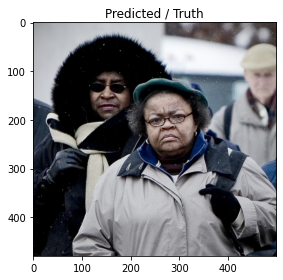

Prediction: 의 얼굴에 칠해진 두 남자가 사진을 찍고 있습니다. 두 남자가 사진을 찍고 있습니다. 두 남자가 사진을 찍고 있습니다.[SEP]를하는 두 남자.[SEP]는 두 남자[SEP] 사진을 찍습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]r.[SEP]의 사진을 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]y[SEP]y[SEP]y[SEP]y[SEP]습니다.[SEP]y[SEP]y[SEP]의 남자.[SEP]r.[SEP]의 남자[SEP]A[SEP]A[SEP]y[SEP]y[SEP]y[SEP][SEP][SEP][SEP][SEP]의 사진을 위해 포즈를 취합니다.[SEP]A[SEP]y[SEP]y[SEP]one[SEP]y Swe[SEP]r.[SEP]one[SEP]on[SEP]y[SEP]의 남자.[SEP][SEP][SEP][SEP][SEP][SEP]A[SEP][SEP]의 남자.[SEP]A[SEP]r.[SEP]A[SEP]A[SEP]A[SEP]r.[SEP]ran은 사진을 위해 포즈를 취합니다.[SEP]ran[SEP]ran[SEP]A[SEP]A[SEP]A[SEP]ss[SEP]yone[SEP]we[SEP]we[SEP]r.[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]we[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]we[SEP]we[SEP]y Swe[SEP]s[SEP]s[SEP]ran은 사진을 위해 포즈를 취합니다., 
Truth:  두 사람이 무거운 옷을 입고 있습니다. 겨울 장비의 여성과 남자.

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 20 summary:
Train loss: 1.6518, validation loss: 2.5395
Train accuracy: 0.4417, validation accuracy: 0.3593
Time per 20 epoch: 191.0 minutes
Prediction after 20 epoch.


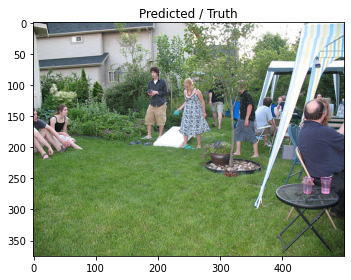

Prediction: 의 피크닉 테이블에 나무가있는 사람들의 그룹. 피크닉 테이블에 앉아있는 사람들의 그룹. 피크닉 테이블에 앉아있는 사람들의 그룹. 피크닉 테이블에 앉아있는 사람들의 그룹.[SEP] 명이 피크닉을합니다[SEP]는 사람들[SEP]iiiiiiiiiiiiiii를합니다.[SEP]는 그룹[SEP]는 피크닉 테이블에 앉아 있습니다.[SEP]는 피크닉[SEP]는 피크닉을합니다[SEP]는 피크닉을하고 있습니다.[SEP]는 피크닉을하고 있습니다[SEP][SEP][SEP][SEP]는 피크닉을하고 있습니다.[SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를 즐기는 피크닉[SEP]는 사람들[SEP]는 피크닉[SEP]는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 사람들[SEP]는 사람들[SEP]는 그룹[SEP]는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiie의 그룹[SEP]n.[SEP]n.[SEP]iie의 그룹, 
Truth:  외부 파티에서 토스 게임을하는 어린 소녀와 청년. 남자와 여자는 파티에서 옥수수 구멍을합니다. 콩 주머니와 남성과 여성 게임. 많은 사람들이 마당에서 이완됩니다.


  0%|          | 0/100 [00:00<?, ?it/s]

test_bleu1: 0.0237 test_bleu4: 0.0052 
21/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

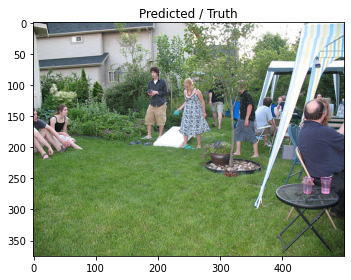

Prediction: 의 여성은 공원에서 피크닉 테이블 주위에 앉아 있습니다. 피크닉 테이블 주위에 앉아있는 사람들. 피크닉 테이블 주위에 앉아있는 사람들. 한 무리의 사람들이 피크닉 테이블에 앉아 있습니다.[SEP]obe에서 밖에 앉아있는 사람들.[SEP]odsbeee를 즐기는 그룹.[SEP]sbeee를 즐기는 그룹.[SEP]eeee를 즐기는 그룹.[SEP]ie를 즐기는[SEP]if.[SEP]iiiiiif.[SEP]는 그룹.[SEP]는 사람들.[SEP]iie를 즐기는 그룹[SEP]는 그룹[SEP][SEP][SEP]ie를 즐기는[SEP]iiiiif.[SEP]ie를 즐기는 사람들.[SEP]if.[SEP]n.[SEP][SEP][SEP]ie를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 사람들.[SEP]는 사람들.[SEP]ifffft[SEP]는 그룹[SEP]는 그룹[SEP]s와 함께 연주고 있습니다.[SEP]ifffts습니다.[SEP]s습니다.[SEP]ts습니다.[SEP]tiftiftife를 연주고 있습니다.[SEP]ts습니다.[SEP]ts습니다.[SEP]tsssss는 그룹[SEP]t[SEP]iftie를 연주를 연주를 연주를 연주합니다[SEP]tie를 연주, 
Truth:  외부 파티에서 토스 게임을하는 어린 소녀와 청년. 남자와 여자는 파티에서 옥수수 구멍을합니다. 콩 주머니와 남성과 여성 게임. 많은 사람들이 마당에서 이완됩니다.


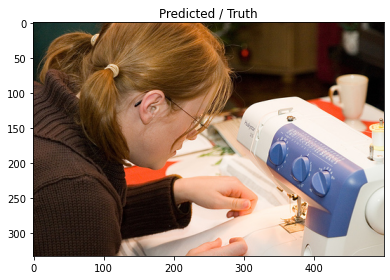

Prediction: 의 여성이 그녀의 뒤에있는 동안 종이를 읽고 있습니다. 여자는 종이를 읽는 동안 종이를 읽고 있습니다. 종이를 읽는 여자. 여자는 종이를 읽고 있습니다.[SEP]를 읽는 여자.[SEP]를 읽는 여자.[SEP]가 읽는[SEP]를 읽습니다.[SEP]는[SEP]를 읽습니다.[SEP]에게 읽는[SEP][SEP][SEP].[SEP].[SEP]에게 읽는[SEP]에게 읽는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP]를하는 여성.[SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP]이를하는 여성.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 여성.[SEP]r.[SEP]를하는 여성.[SEP]r.[SEP][SEP][SEP][SEP][SEP]r.[SEP]r.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]r.[SEP]r.[SEP]r.[SEP]r.[SEP]r.[SEP]r.[SEP].[SEP].[SEP]에게 키스[SEP]이를하는 여성이를하는 여성이를하는 여성이를하는 여성이를하는 여성이를하는 여성이를하는 동안[SEP]시를하는 여성이를, 
Truth:  갈색 스웨터의 한 여성이 기계에 꿰매고 있습니다. 안경을 쓴 여성은 재

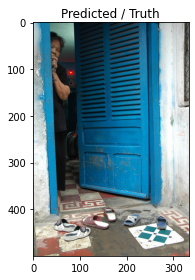

Prediction: 의 한 여성이 큰 파란색 셔츠와 청바지를 입고 있습니다. 파란색 셔츠를 입은 여자는 파란색 셔츠와 함께 파란색 셔츠를 입은 남자 옆에 서 있습니다. 파란색 셔츠를 입은 여자는 파란색 셔츠와 함께 파란색 셔츠를 입은 남자 옆에 서 있습니다. 파란색 셔츠를 입은 여자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자 옆에 서 있습니다.[SEP] 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자 옆에 서 있습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자 옆에 서 있습니다.[SEP]는 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔츠를 입은 남자가 파란색 셔, 
Truth:  약간의 늙은 여자는 파란 출입구 뒤에서 3 쌍의 플라스틱 샌들을 밟습니다. 푸른 문이 열리고 여자가 왼쪽에서 엿볼 수 있습니다. 늙은 아시아 여성은 푸른 출입구 뒤에서 보입니다. 파란 출입구 주위를 들여다 보는 아시아 여성.


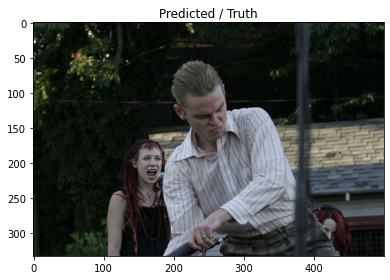

Prediction: 의 두 남자가 서로 옆에 서서 서로 옆에 앉아 있습니다. 두 남자가 서로 옆에 앉아 있습니다. 두 남자가 서로 옆에 앉아 있습니다. 두 남자가 서로 옆에 앉아 있습니다.[SEP]에있는 두 남자[SEP][SEP][SEP]에 앉아있는 두 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ere SUV.[SEP]rankee[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e에 앉아있는 두 남자.[SEP]ran.[SEP]e Make Make Make[SEP]e[SEP]ran은 서로 옆에 앉아있는 두 남자.[SEP]ran은 서로 옆에 앉아있는 두 남자가 웃고 있습니다.[SEP]e[SEP]treet에 앉아있는 두 남자.[SEP]treet의 두 남자가 웃고 있습니다.[SEP]를 즐기는 두 남자가 서로 옆에 앉아있는 두 남자.[SEP]를 즐기는 두 남자.[SEP]는 두 남자.[SEP]는 두 남자가 서로 옆에 앉아 있습니다.[SEP]습니다.[SEP]ran[SEP]ran은[SEP]e[SEP]sssssssssbe[SEP]treet습니다.[SEP]e[SEP]treet습니다.[SEP]treet습니다.[SEP]treet에서 웃고 있습니다.[SEP]treet에서 웃고 있습니다.[SEP]ssssssssssssssssssss를 즐기는, 
Truth:  두 명의 붉은 머리 여자 앞에 흰색 버튼 업 셔츠를 가진 금발의 남자는 다른 하나는 마이크를 사용하여 헤드폰을 착용하고 있습니다. 줄무늬 셔츠를 입은 남자가 배경에있는 여자가 노래하는 동안 무언가를 흔들려고합니다. 남자가 줄무늬 셔츠를 입고 여자가 노래하고 있습니다. 여자가 밴드에서 노래하고 있습니다.


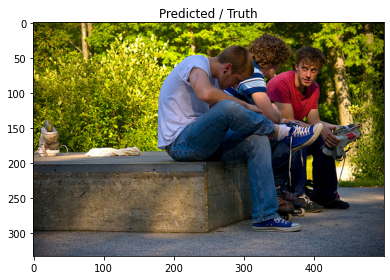

Prediction: 의 여성은 나무 의자에 앉아있는 동안 손을 잡고 있습니다. 한 여성이 의자에 앉아있는 동안 십대 소녀를 십대 소녀를 쳐다보고 있습니다. 젊은 여성은 십대들은 공원 벤치에 앉아 있습니다. 한 무리의 젊은 여성이 공원 벤치에 앉아 있습니다.[SEP] 명의 소녀들이 공원 벤치에 앉아 있습니다.[SEP]는 공원 벤치에 앉아 있습니다.[SEP]는[SEP]는[SEP]를 기다리고 있습니다.[SEP]는[SEP]는[SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]오버[SEP]는[SEP]는[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 포즈를 취합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]sbe[SEP][SEP][SEP][SEP][SEP][SEP][SEP]sbe[SEP]를 위해 포즈를 취합니다.[SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP]를 위해 포즈를 취합니다.[SEP]를 위해 포즈를 취합니다[SEP]습니다.[SEP]습니다.[SEP]를 입고 있습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]는[SEP][SEP][SEP]습니다.[SEP]는[SEP]tsbe[SEP]tsbe[SEP]tone[SEP]는[SEP]tonee를 입고 있습니다.[SEP]tsbe[SEP]를 즐기는[SEP]tsbe[SEP]ts습니다.[SEP]를 즐기는 남자[SEP]tssssbe[SEP]tssbee를 위해 함께 앉아 있습니다, 
Truth:  흰 셔츠, 청바지, 그리고 다른 두 소년 옆에 앉아있는 밝은 파란색 신발을 입은 청년. 한 남자가 대화를 나누는 두 남자 옆에 파란 스니커즈를 확인하고 있습니다. 3 명의 십대 소년들에게 앉아서 신발을 고치고 있습니다. 한 무리의 젊은이들이 스케이트 보드와 함께 공원에서 나눠집니다.


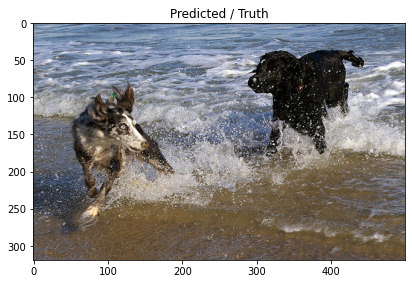

Prediction: 의 검은 개가 물을 통해 달리고 있습니다. 검은 개가 물을 통해 달리고 있습니다. 검은 개가 물을 통해 달리고 있습니다. 검은 개가 물을 통과합니다.[SEP]핑에서 달리는 검은 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]ersbersbersbe에서 놀고있는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 튀는 개[SEP]습니다.[SEP]ersbersbersbersbersbersbersbersbersbersber[SEP][SEP][SEP][SEP][SEP][SEP][SEP]ersber[SEP][SEP][SEP]er[SEP]er[SEP]ersbersbersbersbe에서 놀고 있습니다.[SEP]ersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersber는 개.[SEP]ersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersbersb, 
Truth:  해변에서 물을 통과하는 두 마리의 개. 두 마리의 개가 서핑을 통해 달리고 있습니다. 두 마리의 개가 오션 레이크에서 떨어집니다. 두 마리의 개가 서핑에서 놀아요.


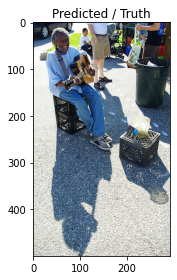

Prediction: 의 여성은 구석에 구석에 구석에 구석을 뿌립니다. 한 여성이 구석에 구석에 구석에 구석에 구석에 구석에 구석을 뿌립니다. 구석에 구석에 구석에 구석에 구석에 앉아있는 여자.[SEP]는 구석에 구석에 구석에 구석에 구석에 앉아 있습니다.[SEP]는 여자와 아이.[SEP]는 여자와 아이.[SEP]는 여자와 함께 앉아 있습니다.[SEP]는 아이.[SEP]는[SEP]nertresbehnersbehnersbe에서 여자.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]는[SEP]는 여자[SEP]s습니다.[SEP]n의 구멍에 앉아 있습니다.[SEP]n의 구멍에 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP]에 앉아있는 여자와 함께 앉아 있습니다.[SEP]는 여자와 함께 앉아 있습니다.[SEP]는 여자와 함께 앉아 있습니다.[SEP]는 여자.[SEP]는 여자.[SEP]nerssss습니다.[SEP]는 여자와 함께 앉아 있습니다.[SEP]n.[SEP]n.[SEP]ners와 함께 앉아있는 여자.[SEP]n의 한 여자.[SEP]n의 한 여자.[SEP]n.[SEP]n의 한 여자.[SEP]n의 한 여자.[SEP]n의 한 여자.[SEP]n은[SEP]treet에서 여자와 함께 앉아 있습니다.[SEP]t, 
Truth:  청바지와 파란색 셔츠를 입은 웃는 사람이 다른 여러 사람들 앞에서 기타를 연주합니다. 하루 동안 끈 기타를 연주하는 두 개의 식료품 상자에 앉아있는 늙은 흑인. 나이가 많은 신사는 화창한 날에 거리에서 기타를 밟는 동안 미소를 짓습니다. 기타를 연주하고 웃는 사람.


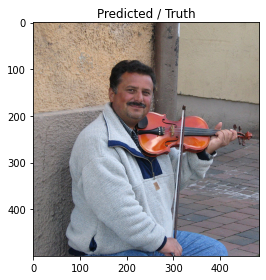

Prediction: 의 여성은 흰색 티셔츠와 담배를 피우고 있습니다. 담배를 피우는 여성이 담배를 피우는 동안 담배를 피우고 있습니다. 담배를 피우는 여성은 담배를 피우고 담배를 피우고 있습니다. 담배를 피우는 담배를 피우는 여성.[SEP]iks의 한 여성이 담배를 피우고 있습니다.[SEP]ie의 한 여성이 담배를 피우고 있습니다.[SEP]ikakaker.[SEP]는 담배를 피.[SEP]iikakakakaker.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ie의 한 여성.[SEP][SEP]s의 한 여성이 담배를 피우고 있습니다.[SEP][SEP][SEP][SEP]ke의 한 여성이 담배를 피.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iker.[SEP]ik[SEP][SEP][SEP][SEP]ke의 한 여성이 담배를 피.[SEP]iker.[SEP]tikakakakakaker.[SEP]tres.[SEP]tiker.[SEP]tike의 한 여성이 담배를 피.[SEP]t의 한 여성이 담배를 피로 연주를 연주하고 있습니다.[SEP]tiks.[SEP]tsssssssk은[SEP]tike의, 
Truth:  바이올린을 연주하는 회색 풀오버 스웨터를 입은 남자. 한 남자가 보도에서 외부 바이올린을 연주하고 있습니다. 한 남자가 바깥 쪽 바이올린을 구부리고 안고 있습니다. 남자는 웃으면 서 바이올린을 연주합니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 21 summary:
Train loss: 1.5927, validation loss: 2.5515
Train accuracy: 0.4489, validation accuracy: 0.3588
Time per 21 epoch: 209.0 minutes
22/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

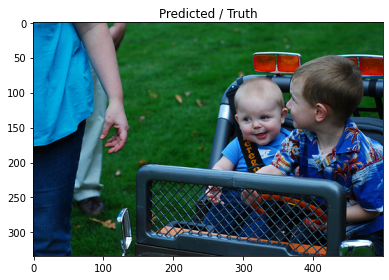

Prediction: 의 유아는 라켓을 들고있는 동안 미소를 짓습니다. 어린 소년은 라켓을 들고있는 동안 미소를 짓습니다. 어린 소년이 라켓을 들고있는 동안 미소를 짓습니다. 어린 소년이 라켓을 들고 있습니다.[SEP]를 즐기는 아이.[SEP]를 즐기는 아이.[SEP]는[SEP]를 즐기는 아이[SEP]습니다.[SEP]를 즐기는[SEP]습니다.[SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP][SEP][SEP]n.[SEP]n.[SEP][SEP]를 즐기는 소년[SEP][SEP][SEP]를 즐기는 소년[SEP]를 즐기는 아이.[SEP]n.[SEP]rind합니다.[SEP]를 즐기는 소년[SEP]rankerssssssssssssssssssssss[SEP]n.[SEP]nersssssssss습니다.[SEP]nerssssssssssssssssssssssssssssssssssssssssee, 
Truth:  어린 아이의 장난감 차량을 타는 두 명의 아이들. 두 명의 작은 소년이 잔디 위에 장난감 차에 앉아 있습니다. 두 명의 작은 소년이 장난감 트럭을 타십시오. 타이어 트럭에있는 소년과 아기.


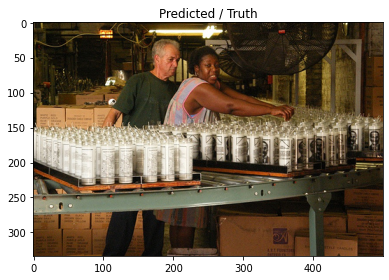

Prediction: 의 여성은 나무 테이블에 앉아있는 동안 테이블에 앉아 있습니다. 여자는 앉은 여자와 함께 테이블에 앉아 있습니다. 여자가 테이블에 앉아있는 여자. 여자가 테이블에 앉아 있습니다.[SEP]는 저녁 식사를합니다.[SEP]는 여자.[SEP]를 위해 테이블에 앉아 있습니다.[SEP]는[SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를합니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]를 위해[SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트.[SEP]er.[SEP]r.[SEP]스트.[SEP]riner.[SEP]를 위해 함께 앉아 있습니다.[SEP]를 위해 함께[SEP]를 위해 함께[SEP]를 위해 함께[SEP]를합니다[SEP]습니다.[SEP]는 여자[SEP][SEP]습니다.[SEP]습니다.[SEP]ran[SEP]습니다.[SEP]습니다.[SEP]ran[SEP]ran[SEP]를 위해 함께[SEP]는 여자[SEP]스트합니다[SEP][SEP][SEP][SEP][SEP]r.[SEP]습니다.[SEP]는 여자[SEP]습니다.[SEP]스트합니다[SEP]습니다.[SEP]를 즐기는 여자[SEP][SEP][SEP]스트를 즐기는 여자[SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트.[SEP]스트를 위해 함께 앉아 있습니다.[SEP]r, 
Truth:  흑인 여성과 백인 남자는 촛불을 상자에 넣은 항아리를 포장하는 공장에서

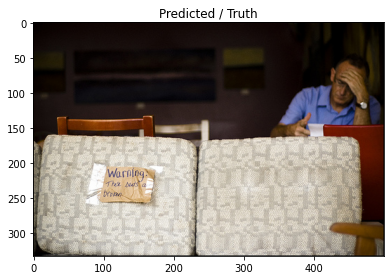

Prediction: 의 여성은 의자에 앉아있는 동안 그림을 그립니다. 여자는 그림을 그립니다. 여자는 그림을 그립니다. 여자는 그림을 그리는 그림을 그립니다. 여자는 그림에 그림을 그립니다.[SEP]는 그림을 그립니다.[SEP]는 그림을 그립니다.[SEP]는 그림을 그립니다.[SEP]는 여자.[SEP] 칠하고 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]의 여성.[SEP][SEP][SEP][SEP][SEP]에 앉아 있습니다.[SEP]의 여성.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의 여성.[SEP]의 여성.[SEP]의 여성.[SEP]지에 앉아 있습니다.[SEP][SEP][SEP]의 여성.[SEP]스트립니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]의 여성.[SEP]의 여성.[SEP]의 여성이 바구.[SEP]의 여성이지에 앉아 있습니다.[SEP]의 여성이지[SEP] 있습니다.[SEP]의 여성이 바보입니다.[SEP]스트[SEP]스트립니다.[SEP] 및[SEP] 및[SEP] 및[SEP][SEP][SEP][SEP][SE

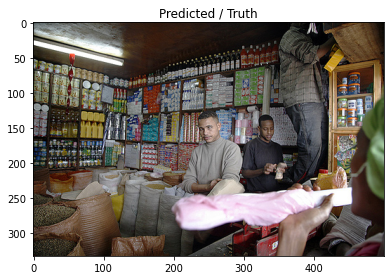

Prediction: 의 여성은 의자에 앉아있는 동안 의자에 앉아 있습니다. 한 여성이 붐비는 거리의자에 앉아 있습니다. 한 여성이 의자에 앉아 있습니다. 사람들은 밤에 붐비는 거리에 앉아 있습니다.[SEP]는 밤에 붐비는 거리.[SEP]는 거리에 앉아 있습니다.[SEP]는 밤에 앉아있는 사람들.[SEP]는[SEP]iiiiiiiik[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]s.[SEP]s[SEP]습니다.[SEP]ssk[SEP]sssskak[SEP]ss의 그룹.[SEP]s.[SEP]ak[SEP]ak[SEP][SEP][SEP]s.[SEP]iiiiiiiik[SEP]s.[SEP]s습니다.[SEP]n.[SEP]s습니다.[SEP]s습니다.[SEP]k은[SEP]iiiiiiiik[SEP]는 바이있는[SEP]는 바이있는[SEP]는 바이있는[SEP]는 바이있는[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]n의 그룹.[SEP]ind을 듣습니다.[SEP]n의 그룹이 바이 바이 바이올린은[SEP]n의 그룹이 듣습니다.[SEP]스트는 바이 듣습니다.[SEP]ssssssssssssssssss습니다., 
Truth:  몇몇 남자들은 재고 선반과 곡물 가방 사이에 상점 안에 있습니다. 일반 상점에서 품목 유형에 도달하는 사람. 두 청년은 상점 뒷방에서 다른 남자를 도와줍니다. 품목을 구입하여 상점에서 일하는 세 남자


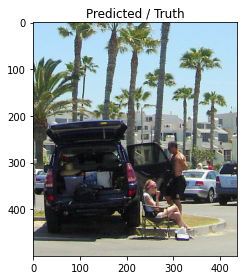

Prediction: 의 두 명의 여성이 차량 근처에서 일하고 있습니다. 두 명의 여성이 차량 근처에서 일하고 있습니다. 두 명의 여성이 차량에서 일하고 있습니다. 두 명의 여성이 차량에서 일하고 있습니다.[SEP]에서 일하는 두 명의 여성.[SEP]를보고있는 두 명의 여성.[SEP][SEP][SEP][SEP]를보고있는[SEP].[SEP][SEP][SEP][SEP]를 본다.[SEP]를 위해[SEP]를 본다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP]를 위해[SEP]를 위해[SEP]합니다.[SEP]합니다.[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는 두 사람.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP].[SEP]를 즐기는 두 남자.[SEP][SEP][SEP][SEP][SEP].[SEP]를 즐기는[SEP].[SEP].[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]를 즐기는[SEP].[SEP]를 즐기는 두 사람.[SEP].[SEP]를 즐기는[SEP]를 위해 함께[SEP].[SEP].[SEP], 
Truth:  

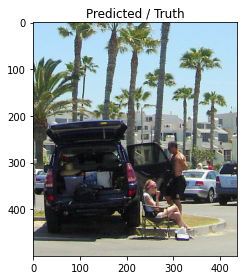

Prediction: 의 두 남자가 차량 근처에 앉아 있습니다. 두 남자가 차량 근처의 밴에 앉아 있습니다. 두 남자가 차량 근처에서 일하고 있습니다. 두 남자가 차량 근처에서 일하고 있습니다.[SEP]를하는 두 남자.[SEP]를보고있는 두 남자.[SEP]를보고있는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를합니다.[SEP][SEP][SEP][SEP][SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP][SEP][SEP][SEP][SEP]합니다.[SEP][SEP][SEP]합니다.[SEP][SEP][SEP][SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]합니다.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기, 
Truth:  접이식 의자에있는 여성은 한 남자가 연석에 주차 된 차 문 안으로 쳐다 보는 동안 먹는다. 남자가 스포츠 유

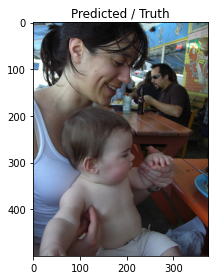

Prediction: 의 여성은 어머니와 딸이 그녀의 딸이 그녀의 뒤에 앉고 있습니다. 어머니와 딸이 그녀의 딸이 그녀의 뒤에 앉고 있습니다. 어머니는 어머니와 딸에게 먹는 것을 돕는 여자. 어머니와 딸이 그녀의 딸에게 먹는 것을 돕는 것을 본다.[SEP]는 어머니에게 먹는 여자.[SEP]를주고있는 여자.[SEP]를 먹는 여자.[SEP]는 어머니에게 먹습니다.[SEP]를주고 있습니다.[SEP]를주고 있습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP]를주고 있습니다.[SEP][SEP][SEP][SEP][SEP]는 여자[SEP]를주고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를주고 있습니다.[SEP][SEP][SEP][SEP][SEP]를주합니다.[SEP][SEP][SEP][SEP][SEP]를주하는 여자.[SEP][SEP][SEP][SEP][SEP]는 여자.[SEP]를주고 있습니다.[SEP]를주고 있습니다.[SEP]는 여자.[SEP][SEP][SEP]는 여자.[SEP]는 여자.[SEP][SEP][SEP][SEP][SEP][SEP]를주합니다.[SEP]는 여자.[SEP]는 여자.[SEP]는 여자[SEP]를주고 있습니다.[SEP][SEP][SEP][SEP]스트[SEP]n.[SEP][SEP][SEP]스트[SEP]를주고 있습니다.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]를주고 있습니다.[SEP]r.[SEP]r.[SEP], 
Truth:  흰색 탱크 탑에있는 여자와 아기가 테이블에 앉아 먹을 것을 얻습니다. 행복한 엄마는 아기를 테이블 위의 접시에서 멀리두고 있습

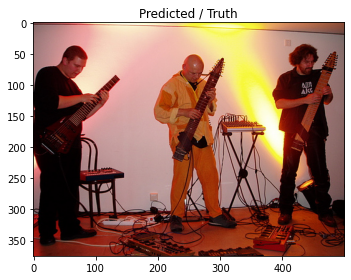

Prediction: 의 음악가 그룹이 음악을 연주하고 있습니다. 음악가 그룹은 음악을 연주하고 있습니다. 음악가 그룹이 음악을 연주하고 있습니다. 음악가 그룹이 음악을 연주합니다.[SEP]을 연주하는 밴드.[SEP]을위한 콘서트.[SEP]는 음악을 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP]스트가가가가가가가[SEP]를 연주하고 있습니다.[SEP]를 연주합니다[SEP]을[SEP]습니다[SEP]습니다.[SEP]을 위해 공연합니다[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]를 연주합니다[SEP]을[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]스트[SEP]스트[SEP]스트합니다[SEP]스트[SEP]스트[SEP]스트[SEP]를 연주합니다[SEP]를 연주합니다[SEP][SEP][SEP]를 연주합니다[SEP]스트합니다[SEP]스트합니다[SEP]스트[SEP]습니다.[SEP][SEP]스트[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]를 연주합니다[SEP]스트는[SEP]스트는[SEP]스트[SEP]스트[SEP][SEP][SEP]스트를 연주합니다[SEP]스트는[SEP]스트가 그룹[SEP]스트가 그룹[SEP]스트가 무대에서 음악가 그룹[SEP]스트를 연주합니다[SEP][SEP]스트[SEP]스트[SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP]스트를 연주합니다[SEP][SEP][SEP][SEP], 
Truth:  세 남자는 무대 전체에 전선과 장비로 뮤지컬 세트를하고 있으며 악기와 같은 독특한 기타를 들고 있습니다. 세 남자가 전자의 현악기를 연주하고 있습니다. 세 명의 뮤지션이 악기를 연주하

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 22 summary:
Train loss: 1.4608, validation loss: 2.5289
Train accuracy: 0.4682, validation accuracy: 0.3625
Time per 22 epoch: 217.0 minutes
Prediction after 22 epoch.


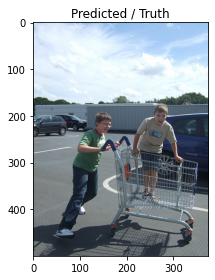

Prediction: 의 여성은 자전거를 타고 있고, 2 명은 여자, 2 명은 자전거를 타고 있습니다. 두 명의 여성이 자전거를 타고 있고, 하나는 자전거를 타고 있습니다. 두 명의 여성이 자전거를 타고 있고, 하나는 자전거를 타고 있습니다. 두 명의 여성이 자전거를 타고 있고, 하나는 자전거를 타고 있습니다.[SEP]는 자전거를 타고 있습니다.[SEP]를 타는 두 명의 여성이 자전거를 타고 있습니다.[SEP]를 타는 두 명의 여성[SEP]를 타고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 가진[SEP]를 즐기는 남자[SEP][SEP][SEP][SEP]를 즐기는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 가진[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 가진 남자.[SEP]를 즐기지[SEP]를 입고 있습니다.[SEP]를 가진[SEP]를 가진 남자.[SEP]를 즐기는 남자.[SEP][SEP][SEP][SEP][SEP][SEP]를 가진 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 남자.[SEP][SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자, 
Truth:  한 소년은 다른 작은 소년과 함께 쇼핑 카트를 밀어 넣습니다. 열정적 인 소년이 웃는 소년이 들어있는 쇼핑 카트를 밀어냅니다. 두 명의 작은 소년이 주차장에서

  0%|          | 0/891 [00:00<?, ?it/s]

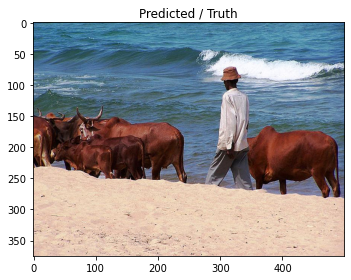

Prediction: 의 말이 서있는 두 개의 갈색 개가 해변에 서 있습니다. 두 마리의 개가 해변에 서 있습니다. 해변에있는 두 마리의 개가있는 해변에 서 있습니다. 해변에있는 두 마리의 개.[SEP] 마리의 개가 해변에 서 있습니다.[SEP] 마리의 개가 해변에 서 있습니다.[SEP]ssssssssssssssssssssseee[SEP]e[SEP]e[SEP]eee[SEP]eeeeeeeeee[SEP]e[SEP]e[SEP]e를 가지고 있습니다.[SEP]eeeeeee[SEP]e[SEP]e[SEP]e를 가지고 놀고 있습니다.[SEP]e[SEP]e[SEP]e[SEP]eeeeeeeeeeeeeeeee를 가지고 놀고 있습니다.[SEP]를 가지고 놀고 있습니다.[SEP]를 가지고 있습니다.[SEP]s를 가지고 있습니다.[SEP]s를 가지고 노는 해변에있는 두 마리의 말에있는 두 마리의 개[SEP]ssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  모자를 쓴 흑인, 해변에서 황소와 함께 걷는 흑인. 해변에서 소 떼와 함께 걷는 남자. 해변에서 하루를 즐기는 조향과 남자. 해변에서 황소를 떼어내는 남자


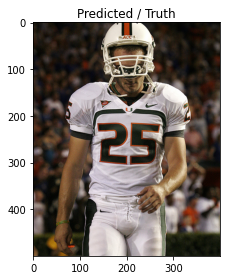

Prediction: 의 축구 선수는 그의 손에 흰색과 흰색 축구 선수를 들고 있습니다. 축구 선수는 축구 선수와 함께 진행 중입니다. 축구 선수는 축구를 들고 있습니다.[SEP] 축구 선수는 축구를 들고 있습니다.[SEP] 축구 선수는 축구를 들고 있습니다[SEP]를합니다[SEP][SEP][SEP][SEP][SEP] 선수[SEP]를합니다.[SEP] 선수가 축구를하고 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]r.[SEP]s.[SEP]r.[SEP]r.[SEP]ran[SEP]s[SEP]ran[SEP]r.[SEP]r.[SEP]r.[SEP]r.[SEP]ran[SEP][SEP][SEP][SEP][SEP]ran[SEP]ran[SEP][SEP]s[SEP]s[SEP]r.[SEP]s.[SEP]ran[SEP]ran[SEP]ranker.[SEP]r.[SEP]ran[SEP]ran[SEP]r.[SEP]rins[SEP]rins[SEP]rankers[SEP]s[SEP]sss[SEP]rank[SEP]r.[SEP]r.[SEP]rankers[SEP]ssssssssssssss[SEP]s[SEP]s.[SEP]rinders.[SEP]yonerssss[SEP]s[SEP]s.[SEP]rinderssssssssssssssssssssssssssssssssss, 
Truth:  흰색 유니폼을 입은 축구 선수가 산책하고 내려다 본다. 마이애미 대학교 축구 선수, 25. 축구 선수는 25 번을 가지고 있습니다. 축구 선수의 근접 촬영, 25.


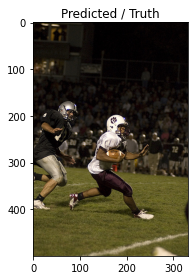

Prediction: 의 축구 선수는 공을 들고있는 동안 공을 잡으려고 시도합니다. 축구 선수는 공을 잡기 위해 공을 잡으려고합니다. 축구를하는 축구 선수.[SEP] 선수가 공을 잡기 위해 공을 잡으려고합니다.[SEP] 선수가 공을 잡기 위해 공을 잡으려고합니다.[SEP]는 축구를 잡을 위해 준비합니다.[SEP]는 축구를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]y.[SEP]y.[SEP]y[SEP]y[SEP][SEP][SEP][SEP]y[SEP]y[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]).[SEP]s.[SEP]s.[SEP]y.[SEP]y.[SEP]y.[SEP]y.[SEP] 선수가 공을합니다.[SEP] 선수가 공을합니다.[SEP] 선수가 공을합니다.[SEP]y[SEP]y[SEP]y[SEP]y[SEP]ran[SEP]ran[SEP]rank[SEP]ran[SEP]y[SEP]rankers.[SEP]y[SEP]y[SEP]sssss.[SEP]y[SEP] 선수가 공을합니다.[SEP]y[SEP]y[SEP]y[SEP]yoneam의 축구를합니다.[SEP] 선수가 공을합니다.[SEP] 선수가 공을합니다.[SEP] 선수가 공을합니다.[SEP] 선수가 공을합니다.[SEP]y[SEP]y[SEP]y[SEP]y[SEP]ssssssss.[SEP], 
Truth:  공을 들고있는 한 축구 선수는 상대 팀의 다른 축구 선수에 의해 추격됩니다. 축구를 가진 축구 선수는 다른 선수가 추구하고 있습니다. 축구를 들고있는 미드 스트라이드의 축구 선수. 축구 선수가 축구와 함께 

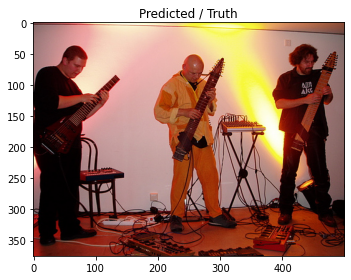

Prediction: 의 음악가 그룹이 음악을 연주하고 있습니다. 음악가 그룹은 음악을 연주하고 있습니다. 음악가 그룹이 음악을 연주하고 있습니다. 음악가 그룹이 음악을 연주합니다.[SEP]을 연주하는 밴드.[SEP]을위한 콘서트.[SEP]는 음악을 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]iii를 연주합니다.[SEP]는[SEP]을 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP]를 연주합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트라는[SEP]스트.[SEP]스트가가가가가가가가가가가가가가가가가 무대에서 음악을 연주합니다[SEP]를 연주합니다[SEP]를 연주합니다[SEP]를 연주합니다[SEP]를 연주합니다.[SEP]를 연주합니다[SEP]를 연주합니다.[SEP]를 연주합니다.[SEP]를 연주합니다.[SEP]를 연주합니다.[SEP]를 연주합니다[SEP]를 연주합니다[SEP]를 연주합니다[SEP]을 연주합니다[SEP]을 연주합니다[SEP]스트합니다[SEP]를 연주합니다[SEP]스트합니다.[SEP]스트합니다[SEP]스트합니다[SEP]를 연주합니다[SEP]를 연주합니다[SEP], 
Truth:  세 남자는 무대 전체에 전선과 장비로 뮤지컬 세트를하고 있으며 악기와 같은 독특한 기타를 들고 있습니다. 세 남자가 전자의 현악기를 연주하고 있습니다. 세 명의 뮤지션이 악기를 연주하고 있습니다. 세 남자가 함께 음악을 연주하고 있습니다.


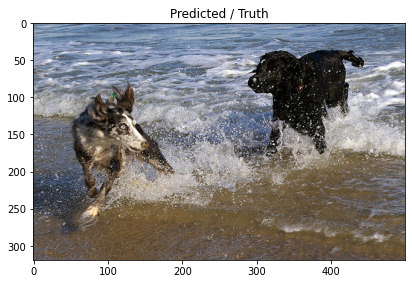

Prediction: 의 개가 물에 서 있습니다. 두 마리의 개가 물에 서 있습니다. 두 마리의 개가 물에 서 있습니다.[SEP]에 두 마리의 개.[SEP]에있는 두 마리의 개.[SEP]에있는 두 마리의 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]ersbe에서 놀고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]er.[SEP]er.[SEP]er.[SEP]er[SEP]er[SEP]er[SEP]er[SEP]er[SEP]ersber[SEP]er[SEP]er[SEP]에있는 두 마리의 개.[SEP][SEP][SEP][SEP]er[SEP]er[SEP][SEP][SEP]er[SEP]er[SEP]er[SEP]er.[SEP]에있는 두 마리의 개.[SEP]에있는 두 마리의 개가 물에있는 두 마리의 개.[SEP]에있는 두 마리의 개.[SEP] 있습니다.[SEP]er[SEP]지[SEP]지[SEP]지[SEP] 있습니다.[SEP]er[SEP]ersbers의 개가 물에있는 두 마리의 개가 물에있는 두 마리의 개가 물에있는 두 마리의 개.[SEP]er[SEP]er[SEP] 있습니다.[SEP] 있습니다.[SEP]ersb[SEP] 있습니다.[SEP]에있는 두 마리의 개가 물에있는 두 마리의 개가 물에있는 두 마리의 개가 물에있는 두 마리의 개가 물에 있습니다.[SEP] 있습니다.[SEP]er[SEP]er, 
Truth:  해변에서 물을 통과하는 두 마리의 개. 두 마리의 개가 서핑을 통해 달리고 있습니다. 두 마리의 개가 오션 레이크에서 떨어집니다. 두 마리의 개가 서핑에서 놀아요.


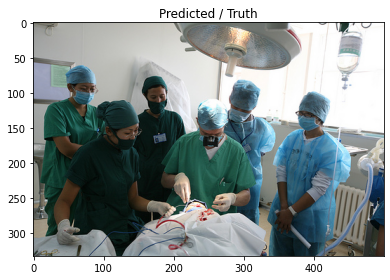

Prediction: 의 여성 그룹은 흰색 티셔츠와 파란색 모자를 쓰고 있습니다. 파란색 셔츠를 입은 몇몇 사람들은 흰색 티셔츠를 입은 남자와 함께 서 있습니다. 파란색 모자를 쓴 사람들은 파티에서 일합니다. 파티에서 일하는 사람들.[SEP]들은 파티에서 일합니다.[SEP]들은 함께 일합니다.[SEP]가[SEP]를합니다.[SEP]에게[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP]스크를합니다.[SEP]스크를합니다.[SEP].[SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP].[SEP]에게[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 팀.[SEP]에게합니다.[SEP]iiiiiiiif.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]A[SEP]에게합니다.[SEP]에게합니다.[SEP]는[SEP]스크를 즐기는[SEP][SEP].[SEP]스크를 확인합니다.[SEP]A.[SEP]A.[SEP]스크를 즐기는[SEP].[SEP].[SEP]스크를 확인합니다.[SEP]A.[SEP]스트가들은[SEP]를 즐기는[SEP]스크를 즐기는[SEP]스트립니다.[SEP]듭니다.[SEP]스크를 확인합니다[SEP]스크를, 
Truth:  외과의는 수술을 수행하는 녹색 스크럽에서 의사를 관찰합니다. 녹색 스크럽의 남자가 수술을 수행하고 있습니다. 외과 의사 팀이 환자를 위해 일하고 있습니다. 의사들은 운영 중입니다.


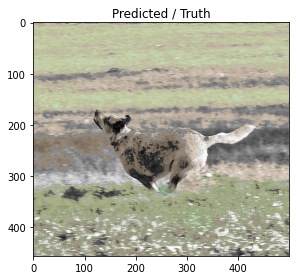

Prediction: 의 개가 모래를 통해 달리고 있습니다. 흑백 개가 모래를 통과합니다. 개가 모래를 통과합니다. 개가 모래를 통과합니다.[SEP] 개가 모래를 통과합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]n Dobe[SEP]n.[SEP]n[SEP]n[SEP]sbe를 쫓아냅니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]sb[SEP]s[SEP]sb[SEP]sb[SEP]sb[SEP]sb[SEP]sbe를 쫓아냅니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]sb[SEP][SEP][SEP][SEP][SEP]s[SEP]s[SEP]s[SEP]sssbe[SEP]n.[SEP]n.[SEP]sbe[SEP]n.[SEP]n.[SEP]n[SEP][SEP][SEP]n.[SEP]sbe를 통과합니다.[SEP]sbe[SEP]sbe[SEP]sbe를 쫓아냅니다[SEP]sbe를 쫓아냅니다[SEP]sbe[SEP]sbe를 통과하는 개[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]nersbe를 통과하는 개[SEP]n.[SEP]n.[SEP]n.[SEP]n은[SEP]n이[SEP]n.[SEP] 개[SEP]sbe를 통과합니다.[SEP]sbe를 통과합니다.[SEP]ner는 개가 모래, 
Truth:  잔디를 통해 달리는 흑백 개의 흐릿한 이미지. 흑백 발견 된 개가 밖에서 달리고 있습니다. 개는 올려다 보면서 달리고 있습니다 개가 들판을 통과하고 있습니다.


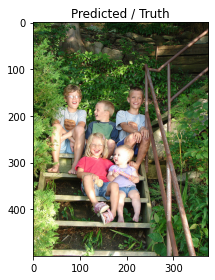

Prediction: 의 아이들은 나무로 둘러싸인 나무에 앉아 있습니다. 아이들은 나무로 둘러싸인 나무에 앉아 있습니다. 아이들은 나무에 앉아 있습니다. 아이들은 나무에 앉아 있습니다.[SEP]목에 앉아있는 아이들.[SEP]목에 앉아있는 아이들.[SEP]목에 앉아[SEP][SEP][SEP][SEP][SEP][SEP]ie[SEP][SEP][SEP][SEP][SEP]anke[SEP]oe[SEP]s.[SEP]nerskeeey[SEP]ankeeeeeeeank[SEP]ankeeeypsk[SEP]neyppske의 그룹.[SEP]neeeeey[SEP]ank[SEP]rank[SEP]n.[SEP]ie브에 앉아있는 아이들.[SEP]neymankeyps의 그룹.[SEP]nersk의 그룹.[SEP]n.[SEP]ners의 그룹.[SEP]ners의 그룹.[SEP]ners의 그룹.[SEP]ne의 그룹.[SEP]rank에 앉아있는 아이들.[SEP]rankertreet의 그룹.[SEP]neeee의 그룹.[SEP]nertreet의 그룹.[SEP]nertoneee의 그룹.[SEP]nertone의 그룹.[SEP]nertone의 그룹.[SEP]nertresk의 그룹.[SEP]treet에서 놀이있는 아이들은 나무를 즐기는, 
Truth:  다섯 명의 아이들이 나무 계단에 앉아 잎이 그들 주변에 앉아 있습니다. 5 명의 아이들이 사진을 위해 포즈를 취하는 나무 계단에 앉아 있습니다. 외부에 위치한 일련의 계단에 앉아있는 5 명의 아이들. 나무 계단에 앉아있는 가족.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 23 summary:
Train loss: 1.4297, validation loss: 2.5370
Train accuracy: 0.4731, validation accuracy: 0.3625
Time per 23 epoch: 225.0 minutes
24/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

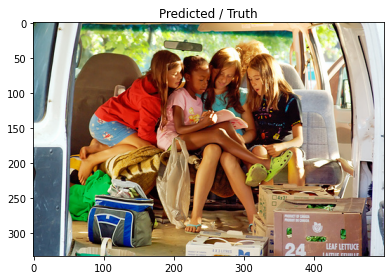

Prediction: 의 여성은 앉아서 사진을 찍습니다. 사진을 찍는 동안 사진을 찍는 여자. 사진을 찍는 여자.[SEP] 사진을 찍는 여자.[SEP] 사진을 찍는 여자.[SEP] 사진을 찍는 여자.[SEP]를 즐기는 여자.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]e의.[SEP]e의 사진을 위해 포즈를 취합니다.[SEP]e[SEP]e[SEP]e[SEP]ran.[SEP]ran[SEP]ran[SEP]e[SEP]e[SEP]e[SEP]r.[SEP]rindy의 여성.[SEP]e[SEP]rine[SEP]e[SEP]e[SEP]e[SEP]e[SEP]rine[SEP]rine[SEP]rine[SEP]ran[SEP]e[SEP]e[SEP]ton[SEP]s의 여성.[SEP]rine[SEP]rine[SEP]rine[SEP]rine[SEP]rine[SEP]rine[SEP]rinding[SEP]rine[SEP]rins의 여성.[SEP]rine의 여성.[SEP]rine[SEP]rins의 여성.[SEP]rine의 여성.[SEP]s의 여성.[SEP]rinders의 여성.[SEP]rine의 여성.[SEP]tone의 여성.[SEP]tone의 여성이 사진을 위해 포즈를 취하는 여성.[SEP]ton[SEP]rinders의 여성이 사진을 위해 포즈를 취하는 여성.[SEP]tone의 여성이 사진을 위해 포즈를 취, 
Truth:  4 명의 어린 소녀들이 농산물 상자와 함께 차 뒤에 책을 읽는 책을 읽습니다. 책을보고 함께 밴 뒤에 앉아있는 아이들의 그룹. 몇몇 어린 소녀들이 미니 밴에 앉아 있습니다. 어린 소녀 그룹이 책을 들여다 보았습니다.


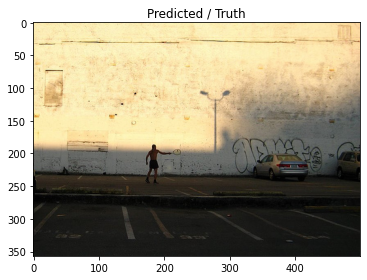

Prediction: 의 실루엣에있는 남자가 해변에서 걷고 있습니다. 한 남자가 해변을 따라 걷고 있습니다. 한 남자가 해변을 따라 걷고 있습니다. 한 남자가 해변을 따라 걷고 있습니다.[SEP]는 해변을 따라 걷는다.[SEP]을 따라 걷는 남자.[SEP]을 따라 걷는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을합니다.[SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]an.[SEP]an.[SEP]으로[SEP]으로[SEP]an.[SEP][SEP][SEP]ssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  가까운 거리에있는 한 남자가 그 근처의은 세단을 가리키고 있습니다. 남자는 테니스 라켓이 어두워지면서 벽을 향한 바깥쪽에 서 있습니다. 그 남자는 건물에 대항하여 테니스를하고 있습니다. 한 남자가 주차장에서 차를 향해 걷는다.


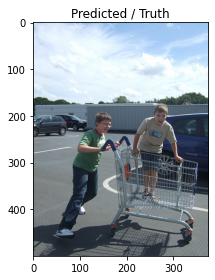

Prediction: 의 여성은 두 여성과 대화하는 동안 대화를하는 여성입니다. 두 명의 여성이 도시의 자전거를 타고 있습니다. 두 명의 여성이 도시에서 이야기하는 두 명의 여성. 두 명의 여성이 자전거를 타고 있습니다.[SEP]를 타는 두 여성.[SEP]를하는 두 명의 여성.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하고 있습니다.[SEP]를하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기.[SEP]를 즐기.[SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP]를 즐기.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP][SEP][SEP][SEP][SEP]를 즐기는 남자.[SEP]를 즐기는[SEP][SEP][SEP]를 즐기는 남자.[SEP]를 즐기는 두 사람[SEP]를 즐기는 두 사람[SEP][SEP][SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 사람[SEP]를 즐기는 두 사람.[SEP]를 즐기는 두 사람[SEP][SEP]를 즐기는 두 사람.[SEP]를 즐기는 두 사람[SEP]를 즐기는 두 사람.[SEP]를 즐기는 두 사람.[SEP]를 즐기는 두 사람[SEP]를 즐기는 두 사람.[SEP]를 즐기는 두 사람.[SEP]를 즐기지[SEP]를 즐기는 두 사람.[SEP]를 즐기는, 
Truth:  한 소년은 다른 작은 소년과 함께 쇼핑 카트를 밀어 넣습니다. 열정적 인 소년이 웃는 소년이 

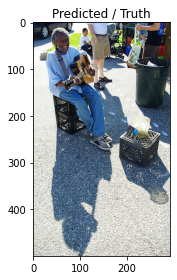

Prediction: 의 모래에 앉아있는 동안 두 명의 여성이 땅에 앉아 있습니다. 두 명의 여성이 구멍을 파고 구멍을 파고 있습니다. 두 명의 여성이 구멍을 파고 구멍을 파고 있습니다. 구멍에 구멍을 파는 두 명의 여성.[SEP]는 구멍을 파고 구멍을 파고 있습니다.[SEP]는 두 명의 여성이 구멍을 파고 있습니다.[SEP]는 두 명의 여성이 구멍을 뚫고 있습니다.[SEP]는 두 사람[SEP]습니다.[SEP]는 두 사람[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ss에 앉아 있습니다.[SEP]n.[SEP][SEP][SEP]n의 구멍에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n의 바위에[SEP]n.[SEP]n의 구멍에 앉아 있습니다.[SEP]n의 한 남자와 함께 앉아 있습니다.[SEP]ners Street.[SEP]nereertreet에서[SEP]nereereertreet의 바위에 앉아 있습니다.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n의 바위에[SEP]nersssssssssssssssssss, 
Truth:  청바지와 파란색 셔츠를 입은 웃는 사람이 다른 여러 사람들 앞에서 기타를 연주합니다. 하루 동안 끈 기타를 연주하는 두 개의 식료품 상자에 앉아있는 늙은 흑인. 나이가 많은 신사는 화창한 날에 거리에서 기타를 밟는 동안 미소를 짓습니다. 기타를 연주하고 웃는 사람.


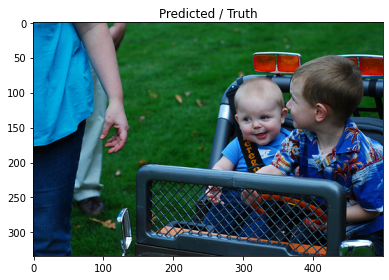

Prediction: 의 유아는 라켓을 들고있는 동안 미소를 짓습니다. 어린 소년은 라켓을 들고있는 동안 미소를 짓습니다. 어린 소년은 라켓을 들고있는 동안 미소를 짓습니다. 어린 소년이 라켓을 들고 있습니다.[SEP]를 즐기는 아이.[SEP]를 즐기는 아이[SEP]습니다.[SEP]는[SEP]를 즐기는[SEP][SEP]를합니다[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하는 소년[SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]는[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP]를 즐기는 아이.[SEP]를 즐기는 아이.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]를 즐기는 아이.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]n.[SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]를 즐기는[SEP]n.[SEP]를 즐기는 아이.[SEP]를 즐기는[SEP]를 즐기는 아이.[SEP]n.[SEP]n.[SEP]를 즐기는[SEP][SEP]n.[SEP]nereereereersssssssseere, 
Truth:  어린 아이의 장난감 차량을 타는 두 명의 아이들. 두 명의 작은 소년이 잔디 위에 장난감 차에 앉아 있습니다

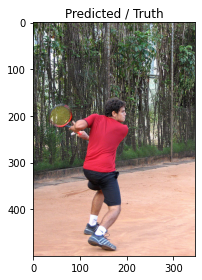

Prediction: 의 테니스 선수는 공을 쳤다. 테니스를하는 빨간 셔츠를 입은 여자. 빨간 셔츠를 입은 여자가 테니스를하고 있습니다. 테니스를하는 빨간 셔츠를 입은 여자.[SEP]를 쳤다.[SEP]를 연주하는 빨간 셔츠.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입은 여자.[SEP]를 연주하는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 쳤다.[SEP][SEP]를 쳤다.[SEP]를 쳤다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 쳤다.[SEP]를 쳤다.[SEP]를 쳤다.[SEP]sssssssssssssbe합니다.[SEP]를 쳤다.[SEP]를 쳤다.[SEP]를 쳤다.[SEP]는 테니스를 쳤다.[SEP]는 테니스를 쳤다.[SEP]는 테니스를 쳤다.[SEP]는 테니스를 연주합니다[SEP]는 테니스를 연주하는 여자[SEP]를 연주합니다[SEP]를 연주합니다.[SEP]를 연주하는 여자[SEP]를 연주하는 여자[SEP]를 연주하는 여자[SEP]를 연주하는 여자[SEP]합니다[SEP][SEP]를 연주하는 여자[SEP]를 연주하는 여자[SEP]를 연주하는 여자[SEP]를 연주하는 여자[SEP]를 연주하는, 
Truth:  방금 테니스 공을 치기 위해 흔들리는 남성 테니스 선수. 갈색 머리의 남자는 빨간 셔츠와 검은 반바지로 테니스를합니다. 한 남자가 백핸드 테니스 샷을 맞을 준비를합니다. 테니스 라켓을 스윙하는 남자.


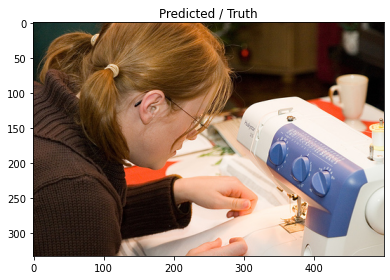

Prediction: 의 여성이 종이 접시를 들고 있습니다. 종이 접시를 들고있는 동안 종이 접시를 들고있는 여자. 여자는 종이 접시를 들고 있습니다. 여자는 종이 접시를 들고 있습니다.[SEP]를 들고있는 여자.[SEP]를 들고있는[SEP][SEP][SEP][SEP][SEP][SEP]를 가진[SEP][SEP][SEP].[SEP]를 즐기는[SEP][SEP]를 들고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를[SEP][SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP]칩니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP]이를 먹고 있습니다.[SEP][SEP][SEP][SEP]r.[SEP][SEP][SEP][SEP]를[SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]r.[SEP]r.[SEP]를 즐기는[SEP]r.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트합니다.[SEP][SEP]r.[SEP][SEP][SEP][SEP]r.[SEP]를 즐기는[SEP]r.[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP]를 즐기는[SEP]합니다.[SEP][SEP]를 즐기는[SEP][SEP].[SEP]를 즐기는[SEP].[SEP].[SEP]를 즐기는[SEP]를 즐기는[

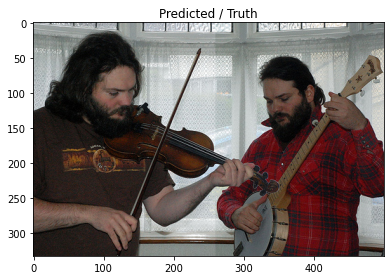

Prediction: 의 여성이 기타를 연주하고 있습니다. 두 명의 여성이 기타를 연주하고 있습니다. 두 명의 여성이 기타를 연주하고 있습니다. 두 명의 여성이 기타를 연주하고 있습니다.[SEP] 기타를 연주하는 두 명의 여성.[SEP] 기타를 연주하는 두 명의 여성[SEP][SEP][SEP]스트.[SEP]스트[SEP]스트[SEP][SEP][SEP][SEP][SEP]를 연주하는 두 명의 여성.[SEP]스트[SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]를 연주.[SEP]을 연주.[SEP][SEP][SEP]스트[SEP]스트[SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]를 연주하는 두 명의[SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트가 노래를 연주하는 두 명의[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트.[SEP]스트[SEP]스트, 
Truth:  브라운 티셔츠를 입은 남자가 바이올린을 연주하는 반면, 그와 같이 보이는 다른 남자는 그를 밴조로 동반합니다.

  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 24 summary:
Train loss: 1.4105, validation loss: 2.5428
Train accuracy: 0.4766, validation accuracy: 0.3617
Time per 24 epoch: 233.0 minutes
Prediction after 24 epoch.


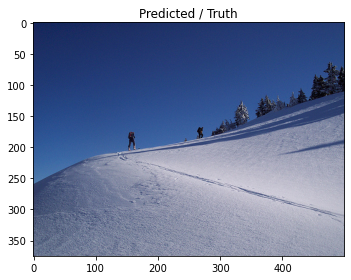

Prediction: 의 실루엣에 서있는 두 사람. 두 사람이 눈 덮인 언덕의 꼭대기에서 눈 덮인 언덕 아래로 서 있습니다. 눈 덮인 산 꼭대기에 서있는 두 사람.[SEP] 스키어가 눈 덮인 언덕 위에 서 있습니다.[SEP] 스키어가 눈 덮인 언덕 위에 서 있습니다.[SEP] 스키어.[SEP] 스키어.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]입니다.[SEP][SEP][SEP][SEP][SEP]입니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는 사람[SEP]입니다.[SEP][SEP][SEP][SEP]에있는 남자.[SEP][SEP][SEP][SEP][SEP]의 스키.[SEP]의 스키.[SEP]에있는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]입니다.[SEP][SEP]입니다.[SEP]입니다.[SEP]에있는 남자가 눈 스키.[SEP]입니다.[SEP]입니다.[SEP]입니다.[SEP][SEP] 스키.[SEP]에있는 남자가 눈 스키.[SEP][SEP]에있는 남자가 눈 스키어가 눈 스키.[SEP], 
Truth:  눈 덮인 언

  0%|          | 0/891 [00:00<?, ?it/s]

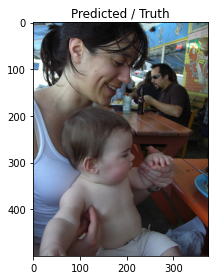

Prediction: 의 어머니는 어머니와 딸이 아기를 안고 있습니다. 어머니와 딸이 아기를 안고 있습니다. 어머니는 어머니와 아기를 안고 있습니다. 어머니와 어머니는 어머니에게 먹는 여자.[SEP]를주고 있습니다.[SEP]는 어머니.[SEP]를 먹는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]를주합니다.[SEP]r.[SEP]ran[SEP]ran[SEP]e[SEP]ran.[SEP]rinding[SEP]rinding[SEP]ran.[SEP]ran[SEP]neree[SEP]n.[SEP]rinding[SEP]rine[SEP]ran[SEP]ran[SEP]rinding[SEP]rineereereereer.[SEP]rinding[SEP]rink[SEP]rind합니다[SEP]n.[SEP]rinding[SEP]rinder.[SEP]rinders의 아기[SEP]rine의 한 여성이를 위해 아기[SEP]rinding[SEP]rinding[SEP]는 여자.[SEP]rinding[SEP]n.[SEP]rindereereeeeee의 한 여성이를 위해 아기[SEP]n.[SEP]n.[SEP]n.[SEP]rinding[SEP]rinding 한 여성이를 위해 아기 위해 아기 위해 아기 위해 아기[SEP]rin, 
Truth:  흰색 탱크 탑에있는 여자와 아기가 테이블에 앉아 먹을 것을 얻습니다. 행복한 엄마는 아기를 테이블 위의 접시에서 멀리두고 있습니다. 어머니가 식당에서 무릎에 아기를 안고 있습니다. 아기는 웃는 여자의 무릎에 앉아 있습니다.


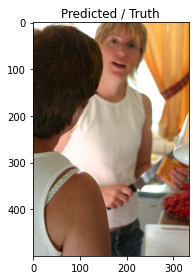

Prediction: 의 여성은 흰색 티셔츠를 입은 여자의 손을 잡고 있습니다. 여자가 음료를 붓고 있습니다. 여자가 음료를 붓고 있습니다. 여자가 음료를 붓고 있습니다.[SEP]를 붓는 여자.[SEP]를 붓는[SEP]를 붓습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 미소[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]를 위해 미소를 위해 미소를 위해 미소를 위해 요리합니다.[SEP][SEP][SEP][SEP][SEP][SEP]시지를 요리합니다.[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]를 위해 미소를 위해 요리합니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]는 여자[SEP]는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 여자.[SEP]n.[SEP]를 위해 요리합니다.[SEP][SEP]시지를 요리합니다.[SEP]시게[SEP]시게[SEP][SEP][SEP]시게[SEP]시게[SEP]시게[SEP]스트.[SEP]스트[SEP]시지[SEP]를 위해 요리를 위해 요리를 위해 요리., 
Trut

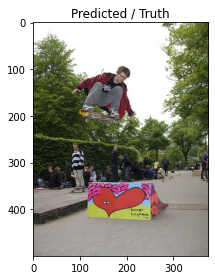

Prediction: 의 아이들은 노란색과 노란색 플라스틱 플라스틱 플라스틱 플라스틱 플라스틱 플라스틱 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색과 노란색 플라스틱 노란색 플립 플립 플립 플립 플립 플립 플롭의 아이들. 노란색과 노란색 플롭의 아이들은 플롭의 아이들이 플롭의 아이들이 플롭에 있습니다. 노란색 플롭에있는 소년. 아이들은 노란색 플롭의자에 있습니다. 아이들은 노란색과 노란색과 노란색과 노란색 플라스틱 노란색과 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색 플라스틱 노란색과 노란색 플라스틱 노란색 플라스틱 노란색, 
Truth:  회색 바지를 입은 남자와 화려한 경사로에서 검은 색과 빨간 재킷 스케이트 보드. 공중의 한 남자가 방금 다른 사람들이 그를보고 경사로를 벗어났습니다. 혼잡 한 공원의 스케이트 보드에서 경사로에서 뛰어 내리는 남자. 스케이트 보드에서 경사로를 떠나는 남자.


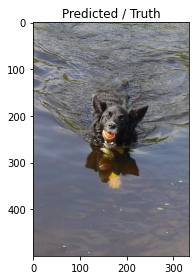

Prediction: 의 개가 물을 통해 튀어 나옵니다. 검은 개가 물을 통과합니다. 검은 개가 물에서 수영합니다. 물에서 수영하는 검은 개.[SEP]을하는 개.[SEP]을합니다[SEP]는 물에서 수영합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]ner.[SEP]ersbe에서 수영합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]er.[SEP]er.[SEP]er.[SEP]er.[SEP]er.[SEP]er.[SEP]er[SEP]er.[SEP]er[SEP]er[SEP]er[SEP]er.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]er.[SEP]스트[SEP]스트[SEP]er.[SEP]스트[SEP]스트[SEP]스트로버[SEP]er.[SEP]스트로버[SEP]스트로버[SEP][SEP][SEP][SEP][SEP][SEP]을합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]스트합니다.[SEP]스트합니다[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트합니다[SEP]er.[SEP]를합니다.[SEP]스트합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트합니다.[SEP]스트합니다[SEP]스트합니다.[SEP][SEP][SEP]스트합니다.[SEP][SEP]스트합니다.[SEP]스트합니다.[SEP]스트[SEP]스트[SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트합니다[SEP]스트합니다.[SEP]스트[SEP], 
Trut

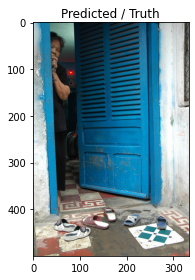

Prediction: 의 한 여성이 나무 창문을 통해 씻고 있습니다. 한 여자는 창문을 통해 창문을 씻는 창문을 청소합니다. 창문을 청소하는 여자.[SEP]는 창문을 청소합니다.[SEP]는 창문을 청소합니다.[SEP]는 창문을 청소합니다.[SEP]는 창[SEP]는 창[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiii.[SEP]는[SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP]는[SEP]는[SEP][SEP][SEP][SEP]는[SEP]는[SEP]를합니다.[SEP]는[SEP]는[SEP]는[SEP]는[SEP]를합니다.[SEP]는[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiiiiiiiiga의 부스에 있습니다.[SEP] 있습니다.[SEP]는[SEP]는 부유를합니다.[SEP][SEP][SEP]는 부유를합니다.[SEP]는 창[SEP]는 부스에 있습니다.[SEP]는 창[SEP]는 창[SEP]는 파란색입니다.[SEP]는 파란색입니다.[SEP]는 창[SEP]는 부유를 부유를 연주[SEP]n.[SEP]n.[SEP]n.[SEP]는 부는 부스에 있습니다.[SEP]는 창[SEP]는 부유를 연주고 있습니다.[SEP]n.[SEP]n.[SEP]스트는 창[SEP]는 파란색 튜브[SEP]스트는 부스에 있습니다.[SEP]n Dola의 창[SEP]는, 
Truth:  약간의 늙은 여자는 파란 출입구 뒤에서 3 쌍의 플라스틱 샌들을 밟습니다. 푸른 문이 열리고 여자가 왼쪽에서 엿볼 수 있습니다. 늙은 아시아 여성은 푸른 출입구 뒤에서 보입니다. 파란 출입구 주위를 들여다 보는 아시아 여성.


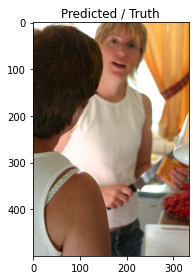

Prediction: 의 여성은 흰색 티셔츠를 입은 여자의 손을 잡고 있습니다. 여자는 음식을 제공합니다. 여자가 음식을 제공합니다. 여자가 음식을 요리하고 있습니다.[SEP]는 음식을 요리합니다.[SEP]가가 요리하고 있습니다.[SEP]는[SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]를 위해[SEP]를[SEP]습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를[SEP]를 만듭니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]시[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP]를 요리합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]시합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]를 요리를 요리합니다.[SEP]습니다.[SEP]시지[SEP][SEP][SEP][SEP]는[SEP]는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는[SEP]는[SEP]습니다.[SEP]는[SEP]습니다.[SEP][SEP]시지에있는[SEP][SEP][SEP]시지에있는[SEP] 있습니다.[SEP]시

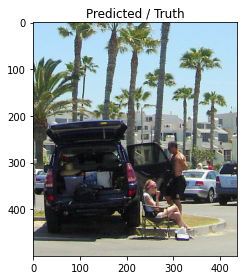

Prediction: 의 두 명의 여성이 차량 근처에서 일하고 있습니다. 두 명의 여성이 차량의 차량에서 일하고 있습니다. 두 명의 여성이 차량에서 일하고 있습니다. 두 명의 여성이 차량에서 일하고 있습니다.[SEP]A.[SEP]를하는 두 명의 여성.[SEP]를보고있는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]를하는[SEP].[SEP][SEP][SEP][SEP][SEP].[SEP]를 즐기.[SEP].[SEP].[SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP][SEP][SEP][SEP].[SEP]를 즐기는[SEP].[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP].[SEP]합니다.[SEP].[SEP]를 즐기는[SEP].[SEP].[SEP]를 즐기는[SEP].[SEP].[SEP].[SEP]를 즐기는[SEP].[SEP].[S

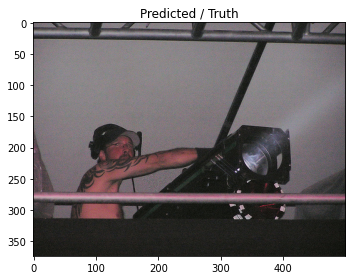

Prediction: 의 여성은 금속 금속 금속 금속 금속 금속 금속 금속 금속 금속 금속 난간에 금속 금속 금속 난다. 금속 금속 막대에서 금속 난간에 두 명의 여성이 금속 막대에 금속 막대기를 사용합니다. 두 여성이 금속 막대에 금속 막대에 금속 막대기를 사용합니다.[SEP]는 두 명의 여성이 금속 막대에 금속합니다.[SEP]는 두 명의 여성이 금속 막대에 있습니다.[SEP]습니다.[SEP]는 두 명의 여성이 금속[SEP]를하고 있습니다.[SEP]는 두 명의 여성이 금속[SEP][SEP][SEP][SEP][SEP][SEP]를하고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]를하고 있습니다.[SEP]를하고 있습니다.[SEP][SEP][SEP]를하고 있습니다.[SEP]는 두 명의 여성이 금속[SEP]는 두 명의 여성[SEP]는 두 명의 여성[SEP]를합니다.[SEP]를하고 있습니다.[SEP]를하고 있습니다.[SEP]는 두 명의 여성[SEP]는 두 명의 여성[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 두 명의 여성[SEP]는 두 명의 여성[SEP]를합니다.[SEP]는 두 명의 여성[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]니스트립니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를하고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP], 
Truth:  부족 문신을 가진 가벼운 기술자의 남자는 발코니의 스포트라이트를 목표로합니다. 문신을 가진 사람은 무대에 빛을 반사하고 있습니다. 백인이 셔츠를 입지 않고 스포트라이트를 일으킨다. 중년의 남성이 주목을 받고 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 25 summary:
Train loss: 1.3958, validation loss: 2.5487
Train accuracy: 0.4774, validation accuracy: 0.3613
Time per 25 epoch: 241.0 minutes


  0%|          | 0/100 [00:00<?, ?it/s]

test_bleu1: 0.0237 test_bleu4: 0.0054 
26/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

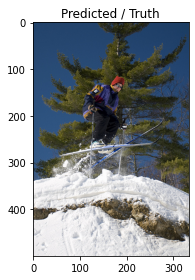

Prediction: 의 한 여성은 눈 덮인 언덕 아래로 스키를 타고 있습니다. 스키어는 언덕 아래로 스키를 타고 있습니다. 스키어는 언덕을 올라갑니다. 스키어는 언덕을 올라갑니다.[SEP] 스키어는 언덕을 올라갑니다.[SEP] 스키.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 타고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP]입니다.[SEP]입니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 스키합니다.[SEP]를 스키합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP][SEP][SEP] 스키.[SEP] 스키합니다.[SEP] 스키.[SEP]입니다.[SEP] 스키.[SEP]입니다.[SEP] 스키.[SEP] 스키.[SE

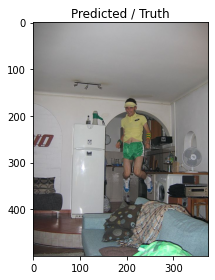

Prediction: 의 두 명의 여성이 컴퓨터 화면을보고 있습니다. 두 명의 여성이 컴퓨터 화면을보고 있습니다. 두 명의 여성이 컴퓨터 화면을보고 있습니다. 두 명의 여성이 컴퓨터 화면을보고 있습니다.[SEP]을보고있는 두 명의 여성.[SEP]을보고있는 두 명의 여성.[SEP]을보고있는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]을보고 있습니다.[SEP]는[SEP][SEP][SEP][SEP].[SEP]을합니다[SEP]는[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP][SEP][SEP][SEP]습니다.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]를합니다[SEP]를합니다[SEP]를합니다[SEP][SEP][SEP]를합니다[SEP]를합니다.[SEP]스트합니다.[SEP]스트합니다[SEP]스트[SEP]스트[SEP]스트합니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP][SEP][SEP][SEP]습니다.[SEP]스트[SEP]스트[SEP]스트합니다[SEP]스트[SEP][SEP]스트.[SEP].[SEP]는[SEP]스트합니다.[SEP]스트합니다[SEP]스트를보고 있습니다.[SEP]스트[SEP]스트[SEP]스트[SEP]스트합니다[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트합니다.[SEP]스트[SEP]스트[SEP]스트합니다[SEP]스트[SEP]스트합니다[SEP]

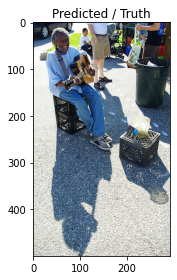

Prediction: 의 구멍에 구멍에 구멍이있는 남자. 한 남자가 구멍에 구멍에 구멍을 뚫고 있습니다. 구멍에 구멍을 뚫는 남자. 구멍에 구멍을 뚫는 남자.[SEP]는 구멍을 뚫고 있습니다.[SEP]는 구멍을 뚫고 있습니다.[SEP]는 구멍[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]칩니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]칩니다.[SEP]n.[SEP]n.[SEP]n.[SEP]n의 한 남자[SEP]nereere에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n의 한 남자[SEP][SEP][SEP][SEP]n의 한 남자[SEP]n.[SEP]nere에 앉아 있습니다.[SEP]n의 한 남자가 함께 앉아 있습니다.[SEP]에 앉아 있습니다.[SEP][SEP]n.[SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n의 한 남자가있는 남자가 바위에 앉아 있습니다.[SEP]n의 한 남자가 바위에 앉아 있습니다.[SEP]nertreet에서 앉은[SEP]nertreet습니다.[SEP]nertubeertube에 앉아 있습니다.[SEP]n의 바위에 앉아 있습니다.[SEP]n.[SEP]n.[SEP]n.[SEP]n의 바위에[SEP]nersssssssssssssssbeereer, 
Truth:  청바지와 파란색 셔츠를 입은 웃는 사람이 다른 여러 사람들 앞에서 기타를 연주합니다. 하루 동안 끈 기타를 연주하는 두 개의 식료품 상자에 앉아있는 늙은 흑인. 나이가 많은 신사는 화창한 날에 거리에서 기타를 밟는 동안 미소를 짓습니다. 기타를 연주하고 웃는 사람.


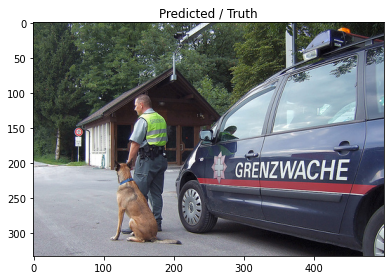

Prediction: 의 한 여성은 트럭 뒤에있는 트럭에있는 트럭 뒤에있는 다른 남자를지나갑니다. 한 여자는 트럭의 트럭 뒤에있는 트럭 뒤에 서 있습니다. 한 여성이 트럭 뒤쪽에 트럭 뒤에 서 있습니다. 한 여자는 트럭 뒤쪽에 트럭 뒤에 서 있습니다.[SEP]를하는 여자.[SEP]는 트럭 뒤에 서 있습니다.[SEP]는 트럭 뒤에 서 있습니다.[SEP]A.[SEP]A[SEP]A[SEP]A[SEP]A.[SEP]A.[SEP]습니다.[SEP]A[SEP]A[SEP]를합니다.[SEP]A[SEP]A[SEP]를합니다.[SEP]A[SEP]A[SEP]A[SEP]A[SEP]습니다.[SEP][SEP]습니다.[SEP]A[SEP]A[SEP]A[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]A.[SEP]A.[SEP]A[SEP]ity[SEP]습니다.[SEP]A[SEP]를합니다[SEP]를 내려다 본다.[SEP]를하는 여자.[SEP]A[SEP]습니다.[SEP]습니다.[SEP]A[SEP]A[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]A[SEP]A[SEP]A[SEP]A[SEP]습니다.[SEP]습니다.[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]습니다.[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A.[SEP]A.[SEP]A[SEP]A[SEP]ersssssssss, 
Truth:  훈련 된 경찰견은 경찰 밴 앞의 핸들러 옆에 앉아 있습니다. 그의 시계 개를 가진 보안 담당자가 무언가를 찾고 있습니다. 경찰관은 독일 셰퍼드 개와 함께 서 있습니다. 경찰관이 수색견과 함께 거리에서 멈 춥니 다.


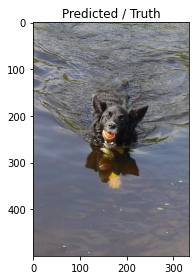

Prediction: 의 개가 물에서 수영하고 있습니다. 검은 개가 물에서 수영 중입니다. 검은 개가 물에서 수영합니다.[SEP] 튀는 검은 개.[SEP] 개가 물에서 수영합니다.[SEP] 장난감을 가지고 노는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]nersbe에서 수영.[SEP]ner.[SEP]er[SEP]er[SEP]er.[SEP][SEP][SEP]er[SEP]를합니다[SEP][SEP][SEP][SEP]er.[SEP]er.[SEP]er.[SEP]er.[SEP][SEP]er[SEP]er[SEP]er[SEP]er[SEP]er.[SEP]er[SEP]er[SEP]er[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]er.[SEP][SEP][SEP][SEP]er.[SEP]er.[SEP]스트[SEP]er.[SEP]er.[SEP]ersbe에서 수영합니다[SEP]er.[SEP][SEP][SEP]이버[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP]스트합니다[SEP]스트합니다[SEP][SEP]스트[SEP]스트[SEP] 있습니다.[SEP]er.[SEP]er.[SEP]er.[SEP]er.[SEP]er.[SEP]er[SEP]er.[SEP]스트합니다[SEP]스트가 수영합니다[SEP]스트합니다[SEP]스트합니다.[SEP]er.[SEP]스트합니다[SEP]스트합니다[SEP]스트로버[SEP]이버[SEP] 있습니다.[SEP]이버[SEP]스트로버[SEP]스트[SEP] 있습니다.[SEP]스트[SEP]스트[SEP]스트[SEP]스트로버[SEP]스트[SEP]스트[SEP]스트[SEP]스트로버[SEP]스트합니다[SEP]스트[SEP]스트, 
Truth:  검은 개는 수영을 할 때 입에 오렌지 테니스 공을 가지고 있습니다. 개는 입에 테니스 공을 들

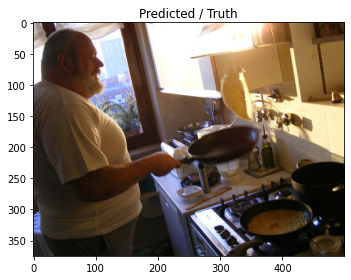

Prediction: 의 부티셔츠를 입은 남자는 부스에서 음식을 준비합니다. 부스에서 음식을 준비하는 남자. 부스에서 음식을 준비하는 남자. 부스에서 음식을 요리하는 남자.[SEP]는 부스에서 일합니다.[SEP]는 부스에서 일합니다.[SEP]는[SEP]를 요리합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP][SEP][SEP][SEP][SEP]i.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 요리합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 요리.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 요리.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 요리합니다.[SEP]스트.[SEP] 요리합니다[SEP]스트.[SEP][SEP] 있습니다.[SEP] 있습니다.[SEP] 요리를 요리합니다[SEP][SEP][SEP][SEP][SEP] 요리를 요리합니다[SEP] 요리합니다[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP]스트[SEP]스트[SEP]습니다.[SEP]를 요리를 요리합니다[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[

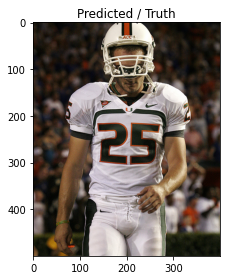

Prediction: 의 축구 선수는 그의 손에 흰색과 흰색 축구 선수를 들고 있습니다. 축구 선수는 축구 경기에서 흰색과 흰색 축구를 들고 있습니다. 축구 선수는 축구를 들고 있습니다. 축구 선수는 축구를 들고 있습니다.[SEP] 흰색과 흰색과 셔츠를 입은 남자[SEP] 흰색 축구를 들고 있습니다.[SEP] 축구 선수는 축구를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 보유하고 있습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]rankers.[SEP][SEP][SEP][SEP][SEP][SEP]rank합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP]rankers[SEP]rankers[SEP]rankers[SEP]r.[SEP]rankers.[SEP]rankers.[SEP]ssss.[SEP]rankers.[SEP]rankers.[SEP]rankers[SEP]rank[SEP]을 입고 있습니다.[SEP]rankerssssssssssssssssssssssssssssssss, 
Truth:  흰색 유니폼을 입은 축구 선수가 산책하고 내려다 본다. 마이애미 대학교 축구 선수, 25. 축구 선수는 25 번을 가지고 있습니다. 축구 선수의 근접 촬영, 25.


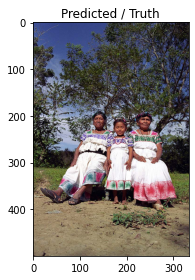

Prediction: 의 여성은 나무가 늘어선 거리에서 어울리는 동안 세 명의 여성이 나무로 둘러싸여 있습니다. 세 명의 여성이 나무가 우거진 지역에서 세 명의 여성이 나무가 우거진 지역에서 세 명의 여성이 길을 따라 세 명의 여성이 길을 따라 세 명의 여성이 가고 있습니다. 세 명의 여성이 나무가 우거진 지역에서 세 명의 여성이 세 명의 여성이 춤을 추고 있습니다.[SEP]는 세 명의 여성이 세 명의 여성이 춤을 추고 있습니다.[SEP]는 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 춤을 추고 있습니다.[SEP]는 세 명의 여성이 춤을 추고 있습니다.[SEP]에 있습니다.[SEP]는 세 명의 여성이 세 명의 여성이 세 명의 여성이 춤을 추고 있습니다.[SEP]는 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 춤을 추고 있습니다.[SEP]는 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의 여성이 춤을 추고 있습니다.[SEP]nnn이 세 명의 여성이 세 명의 여성이 세 명의 여성이 세 명의, 
Truth:  세 명의 여성, 모두 같은 유형의 흰색이지만 화려한 드레스를 입고 앉아서 빛나는 것처럼 보입니다. 나무 앞에서 먼지가 많은 청소에 앉아 흰색 드레스를 입은 다른 연령대의 세 여성. 두 명의 여자와 한 여자가 야외에서 사진을 찍기 위해 옷을 입었습니다. 두 명의 나이 많은 여성과 소녀가 백그라운드에서 숲과 함께 앉아 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 26 summary:
Train loss: 1.3813, validation loss: 2.5554
Train accuracy: 0.4792, validation accuracy: 0.3605
Time per 26 epoch: 258.0 minutes
Prediction after 26 epoch.


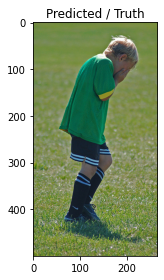

Prediction: 의 소년은 들판에서 축구를하고 있습니다. 필드에서 축구를하는 소년. 녹색 셔츠를 입은 소년이 축구를하고 있습니다. 녹색 셔츠를 입은 소년은 축구를합니다.[SEP]을 가진 소년이 들판에서 축구를합니다.[SEP]는 축구를합니다.[SEP]는 축구를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]iiiiiii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ssss.[SEP]ssssssssss.[SEP]s.[SEP]iiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiiii를합니다.[SEP][SEP][SEP][SEP][SEP]s.[SEP]s.[SEP]ssssssssssssssssssssssssssssssssssssssssssssssss.[SEP]ssssss습니다.[SEP]sssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  손바닥에 울고있는 축구 유니폼을 입은 어린 소년. 아이가 놀면서 상처를 받았기 때문에 울고 있습니다. 아이는 축구장에서 감정을 표현합니다. 축구장에서 울고있는 젊은 축구 소년
27/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

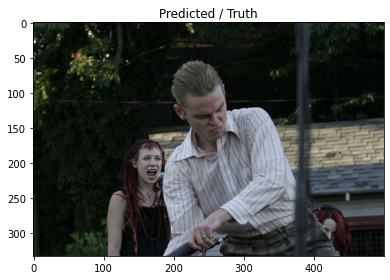

Prediction: 의 두 남자가 서로 옆에 서 있습니다. 두 남자가 서로 옆에 서 있습니다. 두 남자가 서로 옆에 서 있습니다.[SEP] 웃고있는 두 남자.[SEP] 웃고있는 두 남자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]e.[SEP]ran[SEP]ran[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e에 웃고 있습니다.[SEP]ran은 웃고 있습니다.[SEP]e Make Make Make Make[SEP]e[SEP]treet에서 웃고 있습니다.[SEP]ck[SEP]y[SEP]ran은[SEP]ck[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]treet에서 웃고 있습니다.[SEP]treet에서 웃고 있습니다.[SEP]k[SEP]k[SEP]treet에서 웃고있는 두 남자가 웃고 있습니다.[SEP]treet에서 웃고 있습니다.[SEP]는 두 남자가 웃고 있습니다.[SEP]ran은[SEP]ran[SEP]ran[SEP]ran[SEP]s를 즐기는 두 남자가 웃고 있습니다.[SEP]treet.[SEP]treet.[SEP]treet에서 웃고 있습니다.[SEP]treet에서 웃고 있습니다.[SEP]treet에서 웃고 있습니다.[SEP]스트가 웃고있는 두 남자가 웃고있는 두 남자가 웃고 있습니다.[SEP]tresssse[SEP], 
Truth:  두 명의 붉은 머리 여자 앞에 흰색 버튼 업 셔츠를 가진 금발의 남자는 다른 하나는 마이크를 사용하여 헤드폰을 착용하고 있습니다. 줄무늬 셔츠를 입은 남자가 배경에있는 여자가 노래하는 동안 무언가를 흔들려고합니다. 남자가 줄무늬 셔츠를 입고 여자가 노래하고 있습니다. 여자가 밴드에서 노래하고 있습니다.


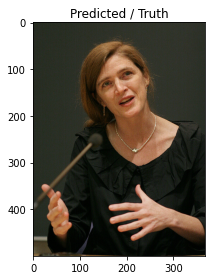

Prediction: 의 여성은 붉은 색과 빨간색을 입고 있습니다. 검은 색의 한 여성이 붉은 색을 입고 웃고 있습니다. 검은 색을 입은 여자는 빨간 옷을 입고 있습니다. 검은 색을 입은 여자가 웃고 있습니다.[SEP] 옷을 입은 여자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]가 웃고 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP]스트.[SEP] 있습니다.[SEP]스트.[SEP]의[SEP] 있습니다.[SEP]스트.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]의[SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트립니다.[SEP]스트가 웃고 있습니다.[SEP]의 여성이스트가 웃고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트가 웃고 있습니다.[SEP][SEP]스트[SEP][SEP][SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]이 웃고 있습니다.[SEP][SEP][SEP][SEP]스트가 웃고 있습니다.[SEP] 있습니다.[SEP]스트[SEP]스트[SEP]스트립니다.[SEP]스트가 웃고 있습니다.[SEP]스트가 웃고 있습니다.[SEP]스트가 웃, 
Truth:  검은 셔츠

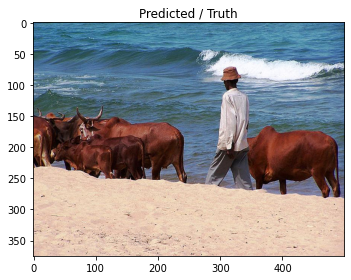

Prediction: 의 갈색 개와 젖꼭지를 가진 남자가 해안에 서 있습니다. 한 남자가 해안에 서있는 동안 해변에 서 있습니다. 한 남자가 해변에 서있는 동안 말을 타고 있습니다. 해변에있는 남자, 개, 그 중 하나의 갈색 개.[SEP] 마리의 개가 해변에 서 있습니다.[SEP]는 해변에 서 있습니다.[SEP]sssssssssssssssssssssssssssssssssssssssssssssssssssssssss.[SEP]we[SEP]sssss.[SEP]eeeeeeeeeeeeeeeeeeeeeeeeee를 타고 있습니다.[SEP]we를 타고 있습니다.[SEP]s를 타고 있습니다.[SEP]s를 타고 있습니다.[SEP]sssssssss를 타고 있습니다.[SEP]sssssssssssssssssssssssssss습니다.[SEP]weeeeeeeeeeeeeeeeeeeeeeeeeee를 타고 있습니다.[SEP]ssssssssssssssssss를 타고 있습니다., 
Truth:  모자를 쓴 흑인, 해변에서 황소와 함께 걷는 흑인. 해변에서 소 떼와 함께 걷는 남자. 해변에서 하루를 즐기는 조향과 남자. 해변에서 황소를 떼어내는 남자


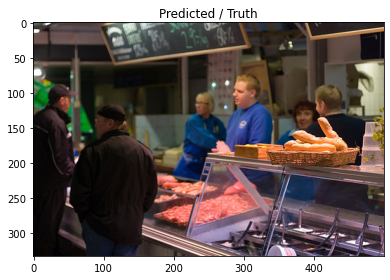

Prediction: 의 음식을 먹는 사람들의 그룹. 몇몇 사람들이 음식을 먹습니다. 음식을 먹는 사람들.[SEP]는 음식을 먹고 있습니다.[SEP]는 음식을 먹는 사람들.[SEP]는 사람들의 그룹[SEP]를 먹고 있습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP]ere[SEP][SEP]er를 먹고 있습니다.[SEP]n.[SEP]n이 음식을 먹고 있습니다.[SEP]칩니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]칩니다.[SEP]s[SEP][SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]sss[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]ers습니다.[SEP]스트[SEP]스트[SEP]습니다.[SEP] 고객은[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 고객은[SEP]를 먹습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]스트립니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]스트가있는[SEP]스트가있는[SEP]스트[SEP]스트[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]스트가있는[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]스트가 요리를 먹습니다.[SEP]스트가 요리를 먹습니다.[SEP]스트립니다.[SEP]스트립니다[SEP]스트[SEP]스트가 요리를 먹습니다.[SEP]습니다, 
Truth:  직원이 기다리는 동안 고객은 육류 카운터를 탐색합니다. 델리에서 무

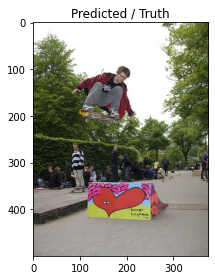

Prediction: 의 아이들은 나무가 늘어선 거리에서 놀고 있습니다. 노란색과 노란색 줄무늬 셔츠를 입은 소년이 나무 줄기를 타고 있습니다. 노란색과 노란색 셔츠를 입은 소년이 나무 줄기를 타고 있습니다.[SEP]는 나무 줄기를 타고 있습니다.[SEP]는 나무 줄기를 타고 있습니다.[SEP]는[SEP]는[SEP]를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]nsshnssssssss를 즐기는[SEP]ns를 즐기는[SEP]ns를 즐기는[SEP]nertres를 즐기는[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]nertoneertone[SEP]n.[SEP]n.[SEP]n.[SEP]nertone[SEP]n.[SEP]n이빙합니다[SEP]nsssssssssssssseereere, 
Truth:  회색 바지를 입은 남자와 화려한 경사로에서 검은 색과 빨간 재킷 스케이트 보드. 공중의 한 남자가 방금 다른 사람들이 그를보고 경사로를 벗어났습니다. 혼잡 한 공원의 스케이트 보드에서 경사로에서 뛰어 내리는 남자. 스케이트 보드에서 경사로를 떠나는 남자.


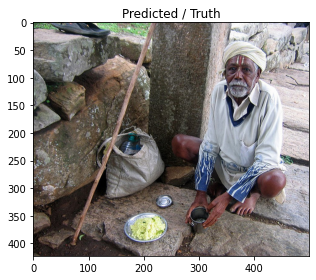

Prediction: 의 바위 위에 앉아있는 흰색 셔츠를 입은 남자. 흰색 바지를 입은 남자는 바위 위에 앉아 있습니다. 흰색 바위와 파란색 바위가 많은 구멍을 뚫습니다. 바위가 많은 구멍을 곁들인 남자.[SEP]는 바위 위에 앉아 있습니다.[SEP]는 바위 위에 앉아 있습니다.[SEP]는 바위가.[SEP]을 만들고 있습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP]습니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 바위한[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]는 바위한[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]스트가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위가 바위, 
Truth:  흰 셔츠를 입은 노인이 손에 컵을 가지고 돌로 길을 쪼그리고 앉고 있습니다. 노인이 땅에 음식 한 접시 앞에 앉아 있습니다. 어두운 피부를 가진 남자는 음식 한 접시 앞에서 쪼그리고 앉습니다. 음식, 가방 및 스틱으로 쪼그리고 앉는 노인.


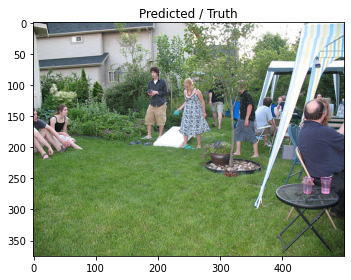

Prediction: 의 여성은 공원에서 피크닉 테이블 주위에 앉아 있습니다. 한 무리의 사람들이 공원에서 피크닉 테이블에 앉아 있습니다. 한 무리의 사람들이 공원에서 피크닉 테이블에 앉아 있습니다. 공원에서 피크닉 테이블에 앉아있는 사람들.[SEP]는 공원에서 피크닉을합니다[SEP]는 사람들.[SEP]는 공원에서 피크닉을합니다[SEP]는 사람들[SEP]는 그룹[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]e[SEP]e의 그룹[SEP]e[SEP][SEP][SEP]e[SEP]e[SEP]e의 그룹.[SEP]ere의 그룹[SEP]e에 앉아 있습니다.[SEP]n.[SEP]n.[SEP]n.[SEP]n의 그룹[SEP]e[SEP]e의 그룹[SEP]e의 그룹[SEP]n.[SEP]e의 그룹[SEP]n.[SEP]e의 그룹[SEP]n의 그룹[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n의 그룹[SEP]ee에 앉아 있습니다[SEP]n의 그룹[SEP]eeeeee의 그룹[SEP]e에 앉아 있습니다.[SEP]e[SEP]e[SEP]e[SEP]e의 그룹[SEP]n이 모여 들판에 앉아 있습니다.[SEP]e의 그룹[SEP]e의 그룹[SEP]eeeeeee의 그룹[SEP]n.[SEP]n이 모여 들판에 앉아 있습니다.[SEP]n이 모여 들었습니다[SEP]e[SEP]ee의 그룹[SEP]tie[SEP]tie의 그룹[SEP]tieeee, 
Truth:  외부 파티에서 토스 게임을하는 어린 소녀와 청년. 남자와 여자는 파티에서 옥수수 구멍을합니다. 콩 주머니와 남성과 여성 게임. 많은 사람들이 마당에서 이완됩니다.


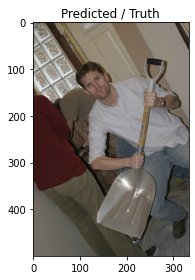

Prediction: 의 나무 바닥에 앉아있는 동안 흰색 티셔츠를 입은 남자. 흰 셔츠를 입은 남자가 바닥에 나무 바닥에 앉아 있습니다. 나무 바닥에 앉아있는 남자는 바닥에 나무 바닥에 앉습니다. 바닥에 앉은 남자가 바닥에 나무 바닥에 앉아 있습니다.[SEP]는 나무 바닥에 앉습니다.[SEP]는 남자가 바닥에 나무 바닥에 앉아 있습니다.[SEP]고 있습니다.[SEP]는[SEP]는[SEP]는[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다[SEP][SEP]습니다[SEP]습니다[SEP][SEP][SEP][SEP][SEP]습니다.[SEP]스트[SEP]스트[SEP]습니다[SEP]습니다.[SEP]스트립니다.[SEP]스트립니다.[SEP]스트[SEP] 있습니다.[SEP]스트가[SEP]를 앉습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 흰색[SEP]습니다.[SEP]스트립니다.[SEP]는[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]스트는[SEP]스트[SEP]스트[SEP]스트립[SEP]스트[SEP]스트[SEP]습니다.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트립니다.[SEP]스트[SEP]스트립니다.[SEP]스트[SEP]스트[SEP]스트립니다.[SEP]스트[SEP], 
Truth:  흰색 티셔츠를 입은 남자가 스노우 삽을 들고 있습니다. 스노우 삽을 들고 흰 셔츠를 입은 남자. 한 남자가 무기처럼 삽을 들고 있습니다. 이 사람은 삽을 들고 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 27 summary:
Train loss: 1.3698, validation loss: 2.5637
Train accuracy: 0.4821, validation accuracy: 0.3598
Time per 27 epoch: 266.0 minutes
28/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

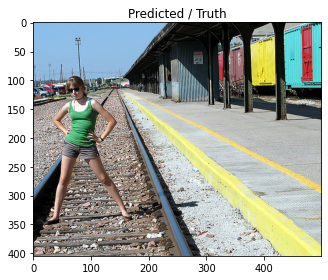

Prediction: 의 여성은 노란색 기차 트랙을 따라 걷고 있습니다. 노란색 셔츠를 입은 여성이 기차를 가로 질러 걷고 있습니다. 노란색 셔츠를 입은 여성은 기차 트랙을 따라 걷고 있습니다. 노란색 셔츠를 입은 여자가 기차 트랙을 걷고 있습니다.[SEP]는 노란색 셔츠를 입은 여자.[SEP]는 기차를 트랙을 걷는 여자[SEP]습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 여자[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP]nsssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssssss, 
Truth:  녹색 탱크 탑과 회색 반바지를 가진 소녀는 빈 철도 트랙 한가운데에 서 있습니다. 녹색 탱크 탑에있는 젊은 여성과 철도 트랙 한가운데에 반바지가 서 있습니다. 녹색 셔츠를 입은 여성이 철도 트랙에 서 있습니다. 소녀가 역 근처의 기차 트랙에 포즈를 취합니다.


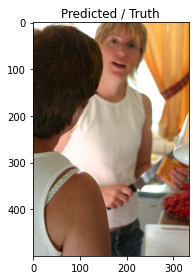

Prediction: 의 여성은 흰색 티셔츠를 입은 여자의 손을 잡고 있습니다. 여자가 음료를 들고 음식을 제공합니다. 여자가 음료를 들고 음식을 제공합니다. 여자가 음료를 들고 음식을 만드는 여자.[SEP]는 음식을 제공합니다.[SEP]는 음식을 요리합니다[SEP]는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 만듭니다.[SEP]는[SEP]를 위해 음식을 요리합니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]칩니다.[SEP][SEP][SEP][SEP][SEP][SEP]를[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]k[SEP]를 만듭니다.[SEP]를 만듭니다.[SEP][SEP]를 위해 미소를 위해 미소를 위해 미소를 위해[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는 여자[SEP][SEP][SEP][SEP][SEP][SEP]는 여자[SEP]는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]는 여자[SEP]n.[SEP]n.[SEP]는 여자[SEP]를 위해 미소를 위해 미소를 위해 미소를 위해 미소를 위해 미소를 위해 미소를 위해 미소를 위해 미소를 위해 미소를 위해 요리합니다.[SEP][SEP][SEP]시를 위해 미소를 위해 미소를, 
Truth:  짧은 머리카락을 가

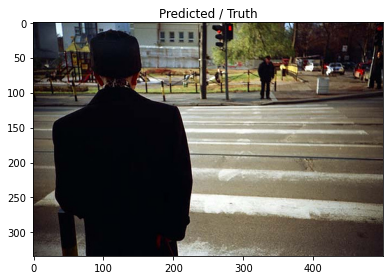

Prediction: 의 여성은 도시 거리에서 걷는다. 길거리에서 걷는 여자와 남자. 거리에서 걷는 남자와 여자.[SEP] 복장을 입은 남자가 길을 걷는다.[SEP] 복도에서 걷는 남자.[SEP][SEP][SEP]A[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]nsssssssssssssssssssssssssssssssssssssssssssssssssss습니다.[SEP]tss의 한가 보도를 걷는다.[SEP]treet.[SEP]treet에서 걷는다.[SEP]treet에서 걷는다.[SEP]tubey Street의 한 남자가 보도를 걷는다.[SEP]에있는 남자.[SEP]에있는 남자가 보도를 걷는다.[SEP]treet습니다.[SEP]treet의 한 남자가 보도를 걷는다.[SEP]treet에서 걷는다.[SEP]tres습니다.[SEP]treet에서 걷는 보도를 걷는다.[SEP]treet습니다.[SEP]tres의 한 남자.[SEP]tres의 한 남자가 보도를 걷는 보도를 걷는다.[SEP]tresssssssssssssssssssss, 
Truth:  횡단 보도에서 서로 거리를 가로 질러 서있는 여자와 남자. 거리의 반대쪽 끝에있는 남자들은 교차하기를 기다리고 있습니다. 교차점 옆에 서있는 2 남자 두 사람이 길을 건너려고합니다.


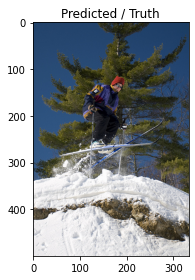

Prediction: 의 스키어는 눈 덮인 언덕 아래로 스키를 타고 있습니다. 스키어는 언덕 아래로 스키를 타고 있습니다. 스키어는 언덕을 올라갑니다. 스키어는 눈 덮인 언덕을 올라갑니다.[SEP] 스키어가 눈 덮인 언덕을 올라갑니다.[SEP] 스키어.[SEP] 스키어가 눈 덮인 언덕을 올라갑니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP][SEP][SEP][SEP][SEP]입니다.[SEP][SEP][SEP][SEP]입니다.[SEP]입니다.[SEP]입니다.[SEP][SEP][SEP][SEP]입니다.[SEP][SEP][

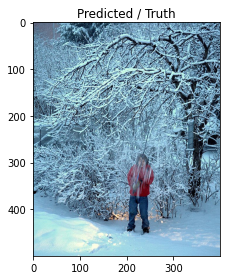

Prediction: 의 모래에 서있는 소녀는 눈 속에 서 있습니다. 어린 소녀는 눈 덮인 산을 바라보고 있습니다. 어린 소녀는 눈 덮인 산을 바라보고 있습니다. 소녀는 눈 덮인 산을 봅니다.[SEP] 덮인 산에서 스키를 타는 소녀.[SEP] 스키어.[SEP]을 즐기는 소녀[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ssssssssssssssssssss의.[SEP]sssss.[SEP]s.[SEP][SEP][SEP][SEP]ssss의 한 여성이 있습니다.[SEP]sssss의 한 여성이 있습니다.[SEP]을합니다.[SEP]ssss의 한 여성이 덮인 산에서[SEP]를 즐기는[SEP]를 즐기는 소녀[SEP]ssssssssssssssssssssssssssssssssssssssssssssssssssssss의 한가 눈 속에서 경주합니다.[SEP]n.[SEP]nssssssssssssssssssssssssssssssssssssss, 
Truth:  빨간 재킷을 입은 소년은 막대기로 눈 덮인 나무를 때립니다. 빨간 재킷을 입은 사람은 눈 덮인 나무 아래에 서 있습니다. 아이는 눈 덮인 나무 아래에 서 있습니다. 어린 소년이 나무에서 눈을 흔들립니다.


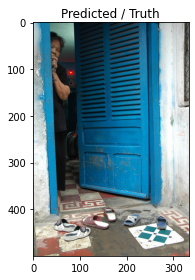

Prediction: 의 한 여성이 수하물 문 옆에 서 있습니다. 푸른 셔츠를 입은 여자는 푸른 문 옆에 서 있습니다. 파란색 셔츠를 입은 여자는 푸른 문 옆에 서 있습니다. 파란색 셔츠를 입은 여자가 문 옆에 서 있습니다.[SEP]는 푸른 문 옆에 서 있습니다.[SEP]는 파란색 문 옆에 서 있습니다.[SEP]는 문에 서 있습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n De Mach[SEP]ndy Stubach[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]nding 한 여성이버 다이버[SEP]ndy Sts Parding, 
Truth:  약간의 늙은 여자는 파란 출입구 뒤에서 3 쌍의 플라스틱 샌들을 밟습니다. 푸른 문이 열리고 여자가 왼쪽에서 엿볼 수 있습니다. 늙은 아시아 여성은 푸른 출입구 뒤에서 보입니다. 파란

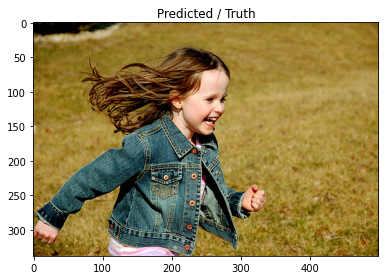

Prediction: 의 여성이 녹색 티셔츠를 입고 있습니다. 녹색 셔츠를 입은 여자는 녹색 셔츠를 입고 있습니다. 녹색 셔츠를 입은 여자가 밖에서 걷고 있습니다. 녹색 셔츠를 입은 여자가 밖에서 걷고 있습니다.[SEP]는 녹색 셔츠를 입고 있습니다.[SEP]는[SEP][SEP]을 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]에있는 여자[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]에 서 있습니다.[SEP]에[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트립니다.[SEP]ss를 입고 있습니다.[SEP]ssssssss.[SEP]sssssssssss.[SEP]n.[SEP]n.[SEP]n.[SEP]y[SEP]y[SEP]을 입고 있습니다.[SEP]이커를 입고 있습니다.[SEP]n이크 리버[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트립니다.[SEP]스트[SEP]스트립니다.[SEP]sssssssss, 
Truth:  필드에서 달리는 동안 웃는 

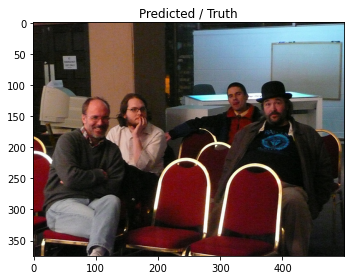

Prediction: 의 여성은 의자에 앉아있는 동안 대화를 나누고 있습니다. 한 무리의 사람들이 의자에 앉아 있습니다. 사람들은 앉은 여자와 대화를 나누고 있습니다. 사람들은 앉은 사람들의 그룹을 때 대화를 나누고 있습니다.[SEP]는 술집에 앉아 있습니다.[SEP]iPod.[SEP]iPod을 즐기는 사람들.[SEP]는[SEP]indowers의 그룹.[SEP]ind을 즐기는[SEP]습니다.[SEP]는[SEP]는[SEP]iners[SEP]ers[SEP]습니다.[SEP]습니다.[SEP]inere[SEP]inere[SEP]inere의 그룹.[SEP]inere[SEP]iners[SEP][SEP][SEP][SEP][SEP]iiiiiiie의 그룹.[SEP]s.[SEP]inere의 그룹.[SEP]iners습니다.[SEP]ind을 즐기는 술집에 앉아 있습니다.[SEP][SEP][SEP][SEP][SEP]는 술집에 앉아 있습니다.[SEP]ind을 즐기는[SEP]는 술집에 앉아 있습니다.[SEP]riners습니다.[SEP]riners습니다.[SEP]ers습니다.[SEP]s습니다.[SEP]ers습니다.[SEP]n.[SEP]iners의 그룹.[SEP]ere[SEP]ine의 그룹.[SEP]n.[SEP]n이 술집에 앉아 있습니다.[SEP]ert스트가있는 사람들의 그룹.[SEP]inderssssssssssssssss습니다, 
Truth:  사진을 위해 포즈를 취하는 4 명의 괴상한. 빨간 의자에 앉아있는 남자 그룹. 의자에 앉아 4 명의 행복한 사람들. 4 명의 남자가 빨간 의자에 앉아 있습니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 28 summary:
Train loss: 1.3521, validation loss: 2.5628
Train accuracy: 0.4855, validation accuracy: 0.3603
Time per 28 epoch: 274.0 minutes
Prediction after 28 epoch.


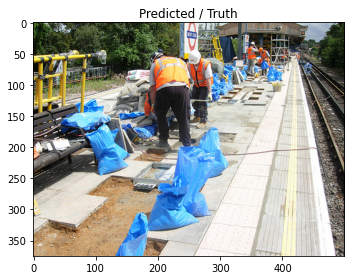

Prediction: 의 건설 노동자들은 기차 트랙에서 일하고 있습니다. 건설 노동자들은 기차 트랙에서 일합니다. 건설 노동자들은 기차 트랙에서 일합니다. 건설 노동자들은 기차 트랙에서 일합니다.[SEP]는 기차 트랙에서 일합니다.[SEP]는 기차 트랙에서 일합니다.[SEP]는 기차를 고정합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]iii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiiiiiiiiger.[SEP]는[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]s.[SEP]y.[SEP]y.[SEP][SEP][SEP]s습니다.[SEP]iiiiiiiiiie[SEP][SEP]를합니다.[SEP]는 남자.[SEP]는[SEP]는[SEP]는[SEP]는 기차를 위해 함께 일합니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]ie.[SEP]ie의 일부는 기차를 사용합니다.[SEP]tie.[SEP]tue[SEP]tueers습니다.[SEP]스트를 위해 함께[SEP]s습니다.[SEP]tieers습니다.[SEP]tie를 위해 노력하고 있습니다.[SEP], 
Truth:  오렌지주의 조끼를 착용 한 노동자들은 철도 트랙 옆에 파란색 가방으로 작업하고 있습니다. 안전 조끼의 건설 승무원은 철도 트랙 근처의 보도를 개조하고 있습니다. 건설 노동자들은 기차역의 중앙값에 벽돌을 놓고 있습니다. 오렌지 조끼를 입은 몇몇 남자들은 철도와 함께 일합니다.
29/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

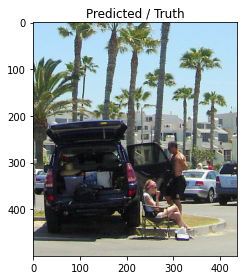

Prediction: 의 두 남자가 앉아 있고, 한 남자는 차 옆에 앉아 있습니다. 두 명의 여성이 차량 근처에서 일하고 있습니다. 두 명의 여성이 차량 근처에서 일하고 있습니다. 버스에서 일하는 두 사람.[SEP]을하는 두 남자.[SEP]는 버스를 본다.[SEP]는 버스를 본다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP]를 즐기.[SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP].[SEP].[SEP][SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는 남자.[SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]합니다.[SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP][SEP][SEP][SEP][SEP]합니다.[SEP]합니다.[SEP]를 즐기는[SEP]를 즐기는 남자.[SEP]를 즐기는 남자.[SEP]를 즐기는[SEP]를 즐기는[SEP]를 즐기는[SEP], 
Truth

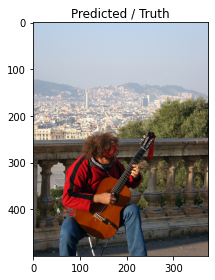

Prediction: 의 밴드는 바위가 많은 해안에서 음악을 연주합니다. 밴드는 바이올린을 연주하는 바이올린을 연주합니다. 밴드에서 연주하는 밴드. 밴드에서 연주하는 밴드.[SEP]을 연주하는 밴드[SEP][SEP][SEP]s의 남자[SEP][SEP]를 연주합니다.[SEP] 밴드가 바이올린을 연주하고 있습니다.[SEP]을[SEP]는 바이올리니스트[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 연주합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ssss S입니다.[SEP]를 연주합니다.[SEP][SEP][SEP][SEP]를 연주합니다.[SEP]를 연주합니다.[SEP]ssssssssssssssssssssssssssssssssssssssss.[SEP]s의[SEP]s의[SEP]s의 남자.[SEP]s의 한 남자.[SEP]ts Stssssssssssssssssssssssssssssssssssssss, 
Truth:  한 남자가 도시의 전망을 그의 배경으로 기타를 연주하고 앉아 있습니다. 도시를 간과하면서 영감 때문에 기타를 집어 들었습니다. 빨간색과 검은 색 셔츠를 입은 남자가 도시 앞에서 기타를 연주하고 있습니다. 그의 기타를 연주하는 히피.


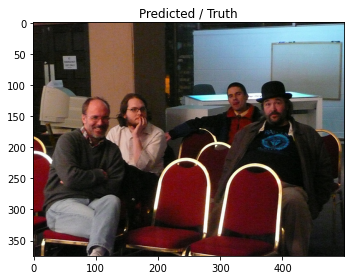

Prediction: 의 여성들은 프레임에서 술을 마시고 있습니다. 세 명의 여성이 식당에서 음료를 마시고 있습니다. 식당에서 음료를 즐기는 세 명의 여성. 식당에서 음료를 마시는 세 명의 여성.[SEP] 명의 여성이 식당에서 음료를 마시고 있습니다.[SEP]는 세 명의 여성이 식당에서 음료를 마시고 있습니다.[SEP]는 사람들.[SEP]ie[SEP]ie[SEP]ie[SEP]를 즐기는[SEP]를 즐기는[SEP]습니다.[SEP]습니다.[SEP]를 즐기는[SEP]습니다.[SEP]습니다.[SEP][SEP][SEP]습니다.[SEP]iiiiiiie[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiiiie[SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]one.[SEP]n.[SEP][SEP]ine의 그룹.[SEP]ine[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]iiiiiiiiie의 그룹.[SEP]습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]s습니다.[SEP]n.[SEP]n.[SEP]n.[SEP]ie의 그룹.[SEP]ie의 그룹.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n이 술집에 앉아있는 사람들은[SEP]s습니다.[SEP]ie의 그룹.[SEP]tone의 그룹.[SEP]tone의 그룹., 
Truth:  사진을 위해 포즈를 취하는 4 명의 괴상한. 빨간 의자에 앉아있는 남자 그룹. 의자에 앉아 4 명의 행복한 사람들. 4 명의 남자가 빨간 의자에 앉아 있습니다.


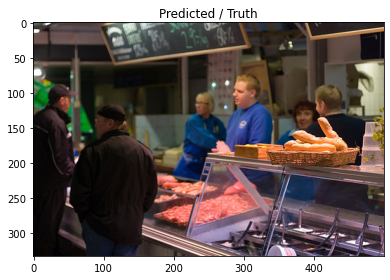

Prediction: 의 음식을 준비하는 몇몇 사람들은 음식을 준비하고 있습니다. 몇몇 사람들이 음식을 준비하고 있습니다. 음식을 준비하는 사람들. 음식을 준비하는 사람들.[SEP]는 음식을 준비합니다[SEP]는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ark[SEP]를합니다.[SEP]를 위해 음식을 준비합니다[SEP]는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]ark[SEP]를합니다.[SEP]ie[SEP]ie[SEP]if.[SEP]는[SEP]를 준비합니다[SEP][SEP][SEP]습니다.[SEP]습니다.[SEP]iiiiiiif.[SEP]습니다.[SEP]는[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]들은[SEP]들은[SEP]습니다.[SEP][SEP][SEP]에게 먹고 있습니다.[SEP]스트[SEP]스트[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]스트가 있습니다.[SEP]스트[SEP]습니다.[SEP]스트[SEP] 고객은[SEP] 있습니다.[SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트립니다[SEP]스트립니다[SEP]스트립니다[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다[SEP]습니다[SEP]습니다[SEP]습니다.[SEP]스트는[SEP]스트는[SEP]스트립니다[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]스트립니다[SEP]스트가있는[SEP]스트가있는[SEP]습니다.[SEP]스트가있는[SEP]스트[SEP] 있습니다.[SEP]스트가있는[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트립니다[SEP]스트[SEP]스트[SEP]스트립니다.[SEP]스트립니다, 
Truth:  직원이 기다리는 동안 고객은 육류 카운터를 탐색합니다. 델리에서 무언가를 사는 파란색 티셔츠를 입은 남자. 검은 모자를 쓴 두 남자가 카운터에서 음식을 

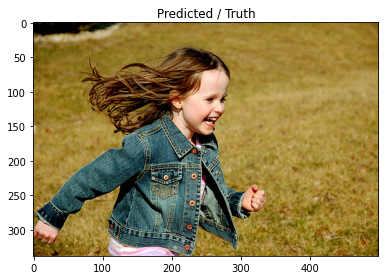

Prediction: 의 여성은 필드를 가로 질러 걷고 있습니다. 금발의 여성이 밖에서 걷고 있습니다. 금발 머리를 가진 여성이 밖에서 걷고 있습니다. 금발의 여성이 밖에서 걷고 있습니다.[SEP]을 들고있는 여자.[SEP]는 밖에서 걷는다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP]y[SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP]의 여성이터를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP]를 입고 있습니다.[SEP][SEP]스트합니다[SEP]스트[SEP][SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]의 여성이 있습니다.[SEP]를 입고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP][SEP][SEP][SEP][SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트.[SEP]스트[SEP]스트[SEP][SEP]을 입고 있습니다.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SE

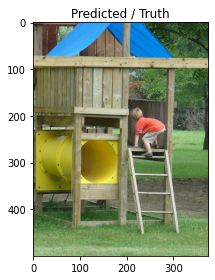

Prediction: 의 나무 구조물에서 놀고있는 빨간 셔츠를 입은 남자. 빨간 셔츠를 입은 남자가 나무 구조물에서 놀아요. 빨간 셔츠를 입은 남자가 나무 구조물에서 놀아요. 빨간 셔츠를 입은 남자가 놀이터에서 놀아요.[SEP]을 위해 놀고있는 남자.[SEP]는 놀이터에서 놀아요.[SEP]는 남자.[SEP]는[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]니스트.[SEP][SEP]n.[SEP]n.[SEP]를 위해 놀이터에서 놀이터에서 놀이터에서 놀이터에서 놀이터에서 놀이터에서 놀이터에서 놀이터에서 놀아요.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]습니다.[SEP]는[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]는[SEP]n.[SEP]n.[SEP]는[SEP]n.[SEP]n.[SEP]을[SEP][SEP]n.[SEP]n.[SEP]n.[SEP]스트를 위해 함께[SEP]n.[SEP]스트를 위해 함께[SEP]n.[SEP]을 위해 함께[SEP]n.[SEP]iiii, 
Truth:  어린 소년은 파란 지붕과 노란 터널이있는 정글 gym에서 놀고 있습니다. 빨간 셔츠를 입은 소년이 나무 놀이 세트를 오르고 있습니다. 아이는 정글 체육관에서 사다리를 올라갑니다. 어린 소년이 놀이 구조를 올라갑니다.


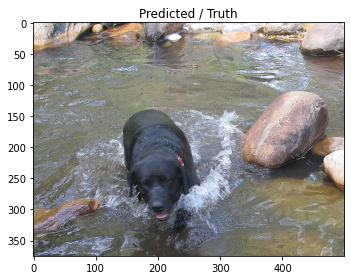

Prediction: 의 개가 물에 뿌려집니다. 검은 개가 물에 뿌려집니다. 검은 개가 물에 뿌려집니다. 개가 물에 뿌려집니다.[SEP]은 개가 물에 뿌려집니다.[SEP]는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP]습니다[SEP][SEP]습니다.[SEP]의 검은 개가 물에 있습니다.[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP]습니다.[SEP]습니다.[SEP][SEP][SEP][SEP][SEP][SEP].[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP] 있습니다.[SEP].[SEP] 있습니다.[SEP] 있습니다.[SEP]의 부유합니다.[SEP]의 부유합니다.[SEP]에 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 개가있는[SEP][SEP][SEP][SEP][SEP][SEP]는[SEP] 있습니다.[SEP]의 부유합니다.[SEP]의 부유합니다.[SEP]는[SEP]는[SEP][SEP][SEP].[SEP] 있습니다.[SEP]는 개가있는[SEP] 있습니다.[SEP][SEP][SEP].[SEP].[SEP].[SEP] 있습니다.[SEP].[SEP]는 개가있는[SEP].[SEP].[SEP] 있습니다.[SEP][SEP].[SEP]에 있습니다.[SEP] 있습니다.[SEP] 있습니다.[SEP][SEP][SEP][SEP]스트.[SEP]스트.[SEP]스트.[SEP][SEP][SEP][SEP] 있습니다.[SEP]는[SEP]는[SEP][SEP], 
Truth:  붉은 칼라가 달린 젖

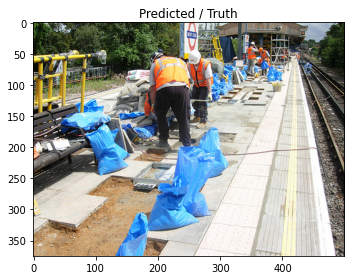

Prediction: 의 건설 노동자들은 기차 트랙에서 일하고 있습니다. 건설 노동자들은 기차 트랙에서 일합니다. 건설 노동자들은 기차 트랙에서 일합니다. 건설 노동자들은 기차 트랙에서 일합니다.[SEP]는 기차 트랙에서 일합니다.[SEP]는 기차 트랙에서 일합니다.[SEP]는 기차를 고정합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]iii.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]iiie.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP].[SEP]습니다.[SEP]ie.[SEP][SEP][SEP]ie.[SEP][SEP][SEP][SEP]a.[SEP][SEP][SEP][SEP]ie[SEP]ie[SEP][SEP]ie[SEP][SEP][SEP]s.[SEP]ie.[SEP]yone[SEP][SEP][SEP]ie[SEP]y.[SEP]iiiiiie[SEP][SEP][SEP][SEP]를하는 사람.[SEP]는[SEP]iiiiiiie[SEP]는 기다립니다.[SEP]는 기차를 위해 노력하고 있습니다.[SEP]ran[SEP]s습니다.[SEP]s습니다.[SEP]는 기차를 사용합니다.[SEP]s습니다.[SEP]ie.[SEP]는 기다립니다.[SEP]는 기차를 사용합니다.[SEP]tue[SEP]tue[SEP]tue를 위해 노력하고 있습니다.[SEP]tie를 사용합니다.[SEP]tie를 위해 노력하고 있습니다.[SEP]ie, 
Truth:  오렌지주의 조끼를 착용 한 노동자들은 철도 트랙 옆에 파란색 가방으로 작업하고 있습니다. 안전 조끼의 건설 승무원은 철도 트랙 근처의 보도를 개조하고 있습니다. 건설 노동자들은 기차역의 중앙값에 벽돌을 놓고 있습니다. 오렌지 조끼를 입은 몇몇 남자들은 철도와 함께 일합니다.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 29 summary:
Train loss: 1.3488, validation loss: 2.5634
Train accuracy: 0.4855, validation accuracy: 0.3608
Time per 29 epoch: 282.0 minutes
30/30 epoch.


  0%|          | 0/891 [00:00<?, ?it/s]

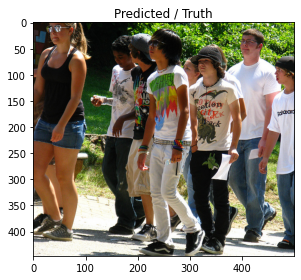

Prediction: 의 여성은 길을 따라 걷고 있습니다. 두 명의 여성이 길을 걷고 있습니다. 두 명의 여성이 길을 걷고 있습니다. 두 명의 여성이 길을 걷습니다.[SEP]는 두 명의 여성이 길을 걷습니다[SEP]습니다.[SEP] 팀이 길을 걷습니다[SEP]습니다[SEP][SEP][SEP][SEP]는 두 명의 여성[SEP][SEP]s.[SEP] 팀이 길을 걷습니다.[SEP]sssssssssss습니다.[SEP]ssssssss습니다[SEP]s습니다.[SEP]ss습니다.[SEP]ss습니다.[SEP]sss습니다.[SEP]ssss습니다[SEP]s습니다.[SEP]sss습니다.[SEP]s습니다[SEP]sshins습니다.[SEP]s습니다[SEP]s습니다.[SEP]shiners습니다.[SEP]s습니다.[SEP]ss의 그룹이 함께 서있는[SEP]에 서있는[SEP]에 서있는 두 명의[SEP]습니다.[SEP]습니다.[SEP]s습니다.[SEP]s습니다.[SEP]습니다.[SEP]s습니다.[SEP]shn.[SEP]s습니다[SEP]ssss습니다.[SEP]s습니다.[SEP]ssssshn.[SEP]s는[SEP]s습니다.[SEP]s의 그룹이 함께 서있는 두 명의[SEP]n.[SEP]tueameameameameams습니다.[SEP]s습니다[SEP]s습니다.[SEP]ssss습니다.[SEP]sssssss습니다.[SEP], 
Truth:  밝은 화창한 날에 밖으로 걷는 캐주얼 옷을 입은 몇몇 젊은이들. 한 무리의 아이들이 밝은 날에 함께 걷습니다. 젊은 십대 그룹이 야외에서 걷고 있습니다. Preteens 그룹이 강 근처에서 걷는다.


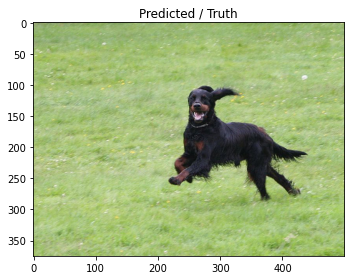

Prediction: 의 검은 개가 잔디를 통해 달리고 있습니다. 검은 개가 잔디를 통과합니다. 검은 개가 잔디에서 달리고 있습니다. 검은 개가 들판을 통과합니다.[SEP]을 통과하는 검은 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]입니다.[SEP]ieeeeeee를 연주하는 개[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]s.[SEP]sbeee[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]sbee를 연주하는 개.[SEP]tie[SEP]s.[SEP]tobeeeeeeee를 연주하는 개.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]로 달리는 들판에 개.[SEP]sbe[SEP]sbe를 연주하는 개.[SEP]sbe를 연주하는 개.[SEP]s.[SEP]sbee는 들판에있는 개.[SEP]t[SEP]t[SEP]tie[SEP]t[SEP]n.[SEP]tcher.[SEP]tcher.[SEP]t[SEP]tcher.[SEP]tcher.[SEP]tcher는 들판에서 달리는 들판에서 달리는 들판에서 달린다.[SEP]tcher는 들판에서 달리, 
Truth:  검은 색과 갈색 모피 개가 잔디에서 달리고 있습니다. 잔디밭을 통과하는 갈색과 검은 개 입이 열린 푸른 잔디에 달리는 검은 개. 잔디밭에 큰 개 광학.


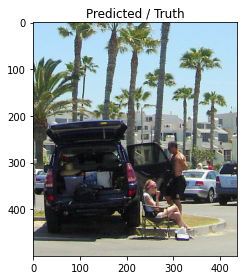

Prediction: 의 두 남자가 바구니가있는 건물 옆에 앉아 있습니다. 두 남자가 바쁜 거리 옆에 앉아 있습니다. 두 남자가 바쁜 거리 옆에 앉아 있습니다. 두 남자가 바쁜 거리에 앉아 있습니다.[SEP]를 기다리는 두 남자.[SEP]를 기다리는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP].[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기.[SEP]를 즐기.[SEP]합니다.[SEP]를 즐기는[SEP]를 즐기는[SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]합니다.[SEP]합니다.[SEP][SEP]합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP]를 즐기는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]합니다.[SEP]합니다.[SEP]를 즐기는[SEP]를 즐기는 두 남자.[SEP]를 즐기는 두 남자.[SEP]를 즐기는[SEP]t.[SEP]를 즐기는, 
Truth:  접이식 의자에있는 여성은

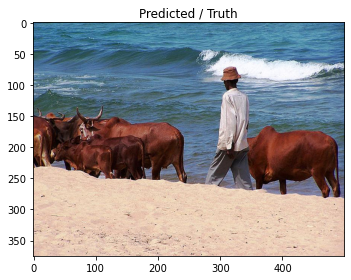

Prediction: 의 갈색 개와 젖꼭지를 가진 남자가 해변에 서 있습니다. 해변의 갈색 개와 함께 해변에 서있는 남자. 해변에있는 남자와 개. 해변에있는 남자와 개.[SEP] 마리의 개가 해변에 서 있습니다.[SEP] 마리의 개가 해변에 서 있습니다.[SEP]는 해변에 서 있습니다.[SEP]ssssss[SEP][SEP]ssss[SEP]s[SEP][SEP]s[SEP]s.[SEP]s[SEP]ssssssssssssssssssssssssssssssssss[SEP]we[SEP]we[SEP]we[SEP]e[SEP]e[SEP]e[SEP]e[SEP]e[SEP]ssssssssssss습니다.[SEP]ss의 말을 타는 개[SEP]we[SEP]we[SEP]we[SEP]ss습니다.[SEP]s를 개를 가지고 있습니다.[SEP]s습니다.[SEP]eeeeeeeeeeeeeeeeeeeeeeeeeeeeeewewe를 가지고 있습니다.[SEP]weeeeeeeeeeee를 가지고 있습니다.[SEP]sssssssssssssssssssssssssssssssss를 가지고 있습니다., 
Truth:  모자를 쓴 흑인, 해변에서 황소와 함께 걷는 흑인. 해변에서 소 떼와 함께 걷는 남자. 해변에서 하루를 즐기는 조향과 남자. 해변에서 황소를 떼어내는 남자


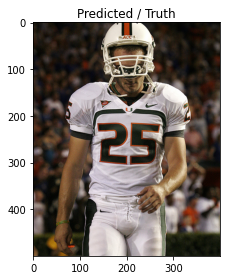

Prediction: 의 축구 선수는 흰색과 흰색 셔츠와 헬멧을 착용합니다. 축구 선수는 축구 경기에서 흰색과 파란색 셔츠를 입고 있습니다. 축구 선수는 축구를합니다. 축구 선수는 축구를합니다[SEP]를합니다[SEP][SEP][SEP] 선수[SEP] 선수[SEP] 선수[SEP] 선수[SEP] 선수[SEP]를 다룹니다.[SEP] 선수가 축구를하고 있습니다.[SEP]는 축구를합니다[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s.[SEP]s.[SEP]를합니다[SEP][SEP]y[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트합니다.[SEP]oner.[SEP][SEP]스트합니다.[SEP][SEP]oner.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트합니다.[SEP]스트합니다.[SEP]스트합니다.[SEP]스트립니다.[SEP]스트립니다[SEP]r.[SEP]r.[SEP]r.[SEP]ran[SEP]r.[SEP][SEP][SEP][SEP][SEP]r.[SEP]스트립니다[SEP]스트합니다[SEP]스트합니다[SEP]스트[SEP]r.[SEP]스트합니다[SEP]스트립니다[SEP]스트합니다[SEP]스트[SEP]스트[SEP][SEP][SEP]스트[SEP]스트[SEP]스트[SEP]스트합니다[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트립니다.[SEP]스트[SEP]스트립니다.[SEP]스트[SEP]스트립니다.[SEP]스트[SEP], 
Truth:  흰색 유니폼을 입은 축구 선수가 산책하

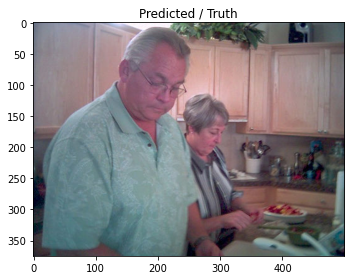

Prediction: 의 두 남자가 함께 앉아서 맥주를 마시고 있습니다. 두 남자가 맥주를 마시고 맥주를 마시고 있습니다. 두 남자가 맥주를 마시고 맥주를 마시고 있습니다. 두 남자가 맥주를 마시고 있습니다.[SEP]를 마시는 두 남자.[SEP]를 마시는 두 남자.[SEP]를 맥주를 마시고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 함께[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]스트.[SEP][SEP][SEP] 있습니다.[SEP]n.[SEP]를 위해 함께[SEP]를 즐기지[SEP]를 즐기는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 즐기는 두 남자.[SEP][SEP]를 즐기는 두 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]n.[SEP]스트.[SEP][SEP][SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]n.[SEP]nere시는 두 남자.[SEP]n.[SEP]n.[SEP]n.[SEP]스트.[SEP]스트.[SEP]시는 두 남자.[SEP]스트.[SEP]스트.[SEP]n.[SEP]nere시는 두 남자., 
Truth:  두 사람은 밝은 갈색 캐비닛이있는 부엌에서 음식을 준비합니다. 두 명의 노인이 부엌에서 식사를 준비하고 있습니다. 나이가 많은 부부가 함께 부엌에 서 

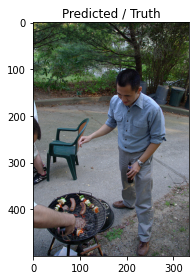

Prediction: 의 한 여성은 금속 막대기에 금속 막대기를 들고 있습니다. 한 여성이 막대기에 닭고기를 들고 있습니다. 한 여자는 막대기를 들고 있습니다. 한 여자가 막대기를 들고 있습니다.[SEP]를 들고있는 여자.[SEP]를 위해 준비하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를합니다.[SEP]를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP]를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해[SEP]습니다.[SEP]시합니다.[SEP]시[SEP]시오.[SEP]시를 위해 굽은[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 굽고 있습니다.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]를 위해 굽고 있습니다.[SEP][SEP][SEP][SEP]습니다.[SEP]를 요리를 요리합니다.[SEP][SEP][SEP][SEP][SEP][SEP]가 달린다.[SEP]는 남자.[SEP]년[SEP]는[SEP]는 남자.[SEP]는 남자.[SEP]는 남자.[SEP]를 위해 요리를 위해 요리를 위해[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는 남자.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]는[SEP]습니다.[SEP]를 요리를 위해 음식을 요리를 요리합니다[SEP][SEP][SEP][SEP][SEP][SEP]시합니다[SEP] 있습니다.[SEP] 있습니다.[SEP]시오.[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]스트[SEP]를 위해 굽은[SEP]시를 위해 굽, 
Truth:  맥주를 들고있는 남자

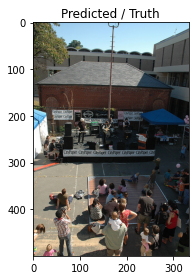

Prediction: 의 군중은 바쁜 거리에서 군중을 위해 공연합니다. 사람들은 도시에서 큰 건물 밖에서 기다리고 있습니다. 사람들은 도시에서 수하물로 가득 찬 방에 서 있습니다. 사람들은 큰 건물 밖에서 기다리고 있습니다.[SEP]는 사람들은 큰 건물 밖에서 기다리고 있습니다.[SEP]는 사람들은 연석에 서 있습니다.[SEP]는 바쁘게[SEP]를합니다[SEP]는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]it합니다.[SEP][SEP][SEP][SEP]it합니다.[SEP]ity[SEP]ity[SEP]ity[SEP]ity[SEP]ity[SEP]ity[SEP]ity[SEP][SEP][SEP]A[SEP]ity[SEP]S[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]A[SEP]A[SEP][SEP]ity Street.[SEP]ity Street의 군중.[SEP]ity Street의 전망.[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]Street.[SEP]ity Street에있는 사람들[SEP]A[SEP]Street의 군중이 있습니다.[SEP]ity Street.[SEP]A.[SEP]A.[SEP]treet습니다.[SEP]A[SEP]treet의 전망.[SEP]A.[SEP]Aid의 군중이션.[SEP]treet의 군중이션이션.[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A[SEP]A.[SEP]ity Street에서 연주합니다.[SEP]treet에서 연주합니다, 
Truth:  외부의 작은 군중 앞에서 연주하는 밴드. 도시 어린이를위한 오락. 밴드는 손님을 위해 외부에서 공연합니다. 주차장에서 콘서트.


  0%|          | 0/99 [00:00<?, ?it/s]

Epoch 30 summary:
Train loss: 1.3456, validation loss: 2.5655
Train accuracy: 0.4845, validation accuracy: 0.3601
Time per 30 epoch: 290.0 minutes
Prediction after 30 epoch.


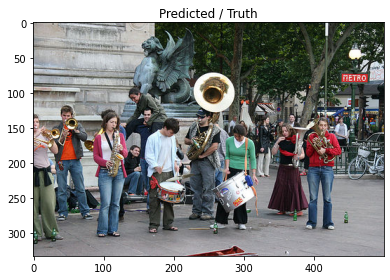

Prediction: 의 군중은 밴드와 함께 연주합니다. 밴드는 바위에서 연주하는 밴드를 연주합니다. 밴드는 바위가 많은 군중을 위해 연주합니다. 밴드가 연주하는 바쁜 거리 공연자.[SEP] 축제에서 연주하는 사람들[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]을 위해 공연합니다.[SEP] 축제에서 공연하는[SEP]을 연주하는[SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP][SEP]s의 그룹.[SEP][SEP][SEP]ity[SEP][SEP][SEP][SEP]s의 그룹.[SEP]on.[SEP]n.[SEP]A[SEP]A[SEP]n.[SEP]A[SEP]A[SEP]n.[SEP]A[SEP]A[SEP]A[SEP]treet의 그룹.[SEP]A[SEP]A[SEP]n.[SEP]스트가들은 바이 모여 들었습니다[SEP]을 위해 공연합니다.[SEP]을 위해 공연하는[SEP]스트가들은 바이션[SEP]treet에서 공연하는 사람들의 그룹[SEP]treet의 그룹[SEP]rantreet에서 공연합니다.[SEP]rantreet.[SEP]treet.[SEP]treet에서 공연하는 사람들의 그룹.[SEP]tone[SEP]tone[SEP]tone[SEP]tone[SEP]tone[SEP]tone[SEP]treet에서 공연합니다.[SEP]treet에서 공연하는 사람들의 그룹.[SEP]treet에서 공연하는 바이 있습니다.[SEP]tone, 
Truth:  남자와 여자의 밴드가 거리에서 음악을 연주하고 있습니다. 한 무리의 사람들이 악기를 연주하고 있습니다. 밴드는이 도시에서 음악을 연주하고 있습니다. 군중을 즐겁게하는 밴드.


  0%|          | 0/100 [00:00<?, ?it/s]

test_bleu1: 0.0236 test_bleu4: 0.0054 


In [27]:
train_losses, valid_losses, train_accuracies, valid_accuracies = [], [], [], []
timeout = 360.  # minutes before stop
start_time = time.time()

for epoch in range(EPOCHS):
    print(f'{epoch+1}/{EPOCHS} epoch.')
    epoch_train_losses, epoch_valid_losses, epoch_train_accuracy, epoch_valid_accuracy = [], [], [], []
    tk0 = tqdm(train_dataloader, total=len(train_dataloader), leave=True)
    
    for i, batch in enumerate(tk0):
        loss, train_accuracy = train_one_batch(model, batch, optimizer, criterion)
        epoch_train_losses.append(loss)
        epoch_train_accuracy.append(train_accuracy)
        tk0.set_postfix(loss=loss)
        if (i+1) % 100 == 0:
            pred = prediction(model)
        
    train_epoch_loss = np.array(epoch_train_losses).mean()
    train_losses.append(train_epoch_loss)
    train_accuracy = np.array(epoch_train_accuracy).mean()
    train_accuracies.append(train_accuracy)
    
    tk1 = tqdm(valid_dataloader, total=len(valid_dataloader), leave=True)
    for _, batch in enumerate(tk1):
        loss, valid_accuracy = validate_one_batch(model, batch, criterion)
        epoch_valid_losses.append(loss)
        epoch_valid_accuracy.append(valid_accuracy)
        tk1.set_postfix(loss=loss)
        
    valid_epoch_loss = np.array(epoch_valid_losses).mean()
    valid_losses.append(valid_epoch_loss)
    valid_accuracy = np.array(epoch_valid_accuracy).mean()
    valid_accuracies.append(valid_accuracy)
    
    print(f'Epoch {epoch+1} summary:')
    print(f'Train loss: {train_epoch_loss:.4f}, validation loss: {valid_epoch_loss:.4f}')
    print(f'Train accuracy: {train_accuracy:.4f}, validation accuracy: {valid_accuracy:.4f}')
    print(f'Time per {epoch+1} epoch: {(time.time() - start_time)//60} minutes')
    
    scheduler.step(valid_epoch_loss)
    
    if (epoch+1) % 2 == 0:
        print(f'Prediction after {epoch+1} epoch.')
        pred = prediction(model)
        torch.save(model.state_dict(), 'model.pth')
    
    if (epoch+1) % 5 == 0:
        test_bleu = evaluate_model(test_dataloader, model, corpus_bleu_score_fn, tokenizer)
        print(''.join([f'test_bleu{i}: {test_bleu[i]:.4f} ' for i in (1, 4)]))
        
    if (time.time() - start_time)//60 > timeout:
        print(f'Timeout stop.')
        torch.save(model.state_dict(), 'model.pth')
        break


#train은 가능합니다. 시간이 오래 걸려 일단은 중간에 멈췄습니다.
#슈퍼컴퓨팅 자원을 쓰면 쉽게 train 가능합니다.
#나희씨가 만드신 dataset도 전처리하면 이 모델에서 적용가능합니다. (description은 영어로 번역된 상태이긴 합니다.)

In [ ]:
pred = prediction(model,filepath='/workspace/IMAGE/images/images/100716317.jpg')
